# Splint 自然言語処理入門

### 3.IMDB映画レビューデータセットの準備

In [1]:
cd ../../../input

/Users/satouwataru/Desktop/DiveIntoCode/input


In [2]:
# # IMDBをカレントフォルダにダウンロード
# !wget http://ai.stanford.edu/~amaas/data/sentiment/aclImdb_v1.tar.gz
# # 解凍
# !tar zxf aclImdb_v1.tar.gz
# # aclImdb/train/unsupはラベル無しのため削除
# !rm -rf aclImdb/train/unsup
# # IMDBデータセットの説明を表示
# !cat aclImdb/README

In [3]:
!ls

Wholesale_customers_DataSet
aclImdb
aclImdb_v1.tar.gz
datasets
home-credit-default-risk
house-prices-advanced-regression-techniques
mtfuji_data.csv
titanic


読み込み

In [4]:
from sklearn.datasets import load_files
train_review = load_files('./aclImdb/train/', encoding='utf-8')
x_train, y_train = train_review.data, train_review.target
test_review = load_files('./aclImdb/test/', encoding='utf-8')
x_test, y_test = test_review.data, test_review.target
# ラベルの0,1と意味の対応の表示
print(train_review.target_names)

['neg', 'pos']


In [5]:
print("x : {}".format(x_train[0]))

x : Zero Day leads you to think, even re-think why two boys/young men would do what they did - commit mutual suicide via slaughtering their classmates. It captures what must be beyond a bizarre mode of being for two humans who have decided to withdraw from common civility in order to define their own/mutual world via coupled destruction.<br /><br />It is not a perfect movie but given what money/time the filmmaker and actors had - it is a remarkable product. In terms of explaining the motives and actions of the two young suicide/murderers it is better than 'Elephant' - in terms of being a film that gets under our 'rationalistic' skin it is a far, far better film than almost anything you are likely to see. <br /><br />Flawed but honest with a terrible honesty.


5.BoW

In [6]:
mini_dataset = \
  ["This movie is very good.",
  "This film is a good",
  "Very bad. Very, very bad."]

In [7]:
import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer
vectorizer = CountVectorizer(token_pattern=r'(?u)\b\w+\b')
bow = (vectorizer.fit_transform(mini_dataset)).toarray()
# DataFrameにまとめる
df = pd.DataFrame(bow, columns=vectorizer.get_feature_names())
display(df)

,a,bad,film,good,is,movie,this,very
0,0,0,0,1,1,1,1,1
1,1,0,1,1,1,0,1,0
2,0,2,0,0,0,0,0,3


In [8]:
# ngram_rangeで利用するn-gramの範囲を指定する
vectorizer = CountVectorizer(ngram_range=(2, 2), token_pattern=r'(?u)\b\w+\b')
bow_train = (vectorizer.fit_transform(mini_dataset)).toarray()
df = pd.DataFrame(bow_train, columns=vectorizer.get_feature_names())
display(df)

,a good,bad very,film is,is a,is very,movie is,this film,this movie,very bad,very good,very very
0,0,0,0,0,1,1,0,1,0,1,0
1,1,0,1,1,0,0,1,0,0,0,0
2,0,1,0,0,0,0,0,0,2,0,1


#### 【問題1】BoWのスクラッチ実装  
以下の3文のBoWを求められるプログラムをscikit-learnを使わずに作成してください。  
1-gramと2-gramで計算してください。

In [45]:
import re

def scr_bow(sentence_list, n_gram):
    replace_list = [re.sub('!', '', s.lower()) for s in sentence_list] # "!"を削除して小文字に変換
    split_list = [s.split() for s in replace_list] # 空白で分割
    # n_gramごとにまとめる
    word_list1=[]
    for s_list in split_list:
        word_list0=[]
        for j in range(len(s_list)):
            word = s_list[j:j+n_gram]
            if len(word) == n_gram:
                word_list0+=[word]
        word_list1 += [word_list0]
        
    word_list3=[]
    for word_list in word_list1:
        word_list2 = []
        for s_list in word_list:
            n_s = ""
            for s in s_list:
                n_s = n_s + s + " "
            word_list2 +=[n_s[:-1]]
        word_list3+=[word_list2]
    
    # dfに変換してカウント
    df = pd.DataFrame(index=range(len(sentence_list)))
    for i, word_list in enumerate(word_list3):
        for word in word_list:
            if word not in df.columns:
                df[word] = 0
            df.loc[i, word] += 1
            
    return df.sort_index(axis=1)

In [46]:
mini_dataset = \
  ["This movie is SOOOO funny!!!",
   "What a movie! I never",
    "best movie ever!!!!! this movie"]

In [47]:
scr_bow(mini_dataset, 1)

[['this', 'movie', 'is', 'soooo', 'funny'], ['what', 'a', 'movie', 'i', 'never'], ['best', 'movie', 'ever', 'this', 'movie']]


,a,best,ever,funny,i,is,movie,never,soooo,this,what
0,0,0,0,1,0,1,1,0,1,1,0
1,1,0,0,0,1,0,1,1,0,0,1
2,0,1,1,0,0,0,2,0,0,1,0


In [12]:
scr_bow(mini_dataset, 2)

,a movie,best movie,ever this,i never,is soooo,movie ever,movie i,movie is,soooo funny,this movie,what a
0,0,0,0,0,1,0,0,1,1,1,0
1,1,0,0,1,0,0,1,0,0,0,1
2,0,1,1,0,0,1,0,0,0,1,0


In [13]:
scr_bow(mini_dataset, 3)

,a movie i,best movie ever,ever this movie,is soooo funny,movie ever this,movie i never,movie is soooo,this movie is,what a movie
0,0,0,0,1,0,0,1,1,0
1,1,0,0,0,0,1,0,0,1
2,0,1,1,0,1,0,0,0,0


### 6.TF-IDF

IDF

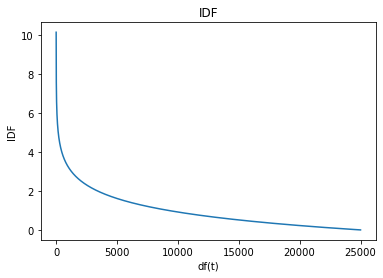

In [14]:
import numpy as np
import matplotlib.pyplot as plt
n_samples = 25000
idf = np.log(n_samples/np.arange(1,n_samples))
plt.title("IDF")
plt.xlabel("df(t)")
plt.ylabel("IDF")
plt.plot(idf)
plt.show()

ストップワード

In [15]:
vectorizer = CountVectorizer(stop_words=["is"], token_pattern=r'\b\w+\b')
bow_train = (vectorizer.fit_transform(mini_dataset)).toarray()
df = pd.DataFrame(bow_train, columns=vectorizer.get_feature_names())
display(df)

,a,best,ever,funny,i,movie,never,soooo,this,what
0,0,0,0,1,0,1,0,1,1,0
1,1,0,0,0,1,1,1,0,0,1
2,0,1,1,0,0,2,0,0,1,0


In [16]:
# はじめて使う場合はストップワードをダウンロード
import nltk
stop_words = nltk.download('stopwords')
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
print("stop word : {}".format(stop_words)) # 'i', 'me', 'my', ...

stop word : ['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/satouwataru/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [17]:
vectorizer = CountVectorizer(token_pattern=r'\b\w+\b', max_features = 5)
bow_train = (vectorizer.fit_transform(mini_dataset)).toarray()
df = pd.DataFrame(bow_train, columns=vectorizer.get_feature_names())
display(df)

,a,best,ever,movie,this
0,0,0,0,1,1
1,1,0,0,1,0
2,0,1,1,2,1


#### 【問題2】TF-IDFの計算  
IMDB映画レビューデータセットをTF-IDFによりベクトル化してください。  
NLTKのストップワードを利用し、最大の語彙数は5000程度に設定してください。  
テキストクリーニングやステミングなどの前処理はこの問題では要求しません。

In [18]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(stop_words=stop_words,
                             token_pattern=r'\b\w+\b',
                             max_features = 5000,
                             norm=None)

arr_x_train = (vectorizer.fit_transform(x_train)).toarray()
df = pd.DataFrame(arr_x_train, columns=vectorizer.get_feature_names())
display(df)

,0,00,000,1,10,100,11,12,13,13th,...,york,young,younger,youth,z,zero,zizek,zombie,zombies,zone
0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,...,0.000000,6.437303,0.0,0.0,0.0,5.35835,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.000000,2.998676,0.000000,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.000000,2.998676,0.000000,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24995,0.0,0.0,0.0,0.000000,0.000000,5.127735,0.0,0.0,0.0,0.0,...,9.393903,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0
24996,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0
24997,0.0,0.0,0.0,0.000000,2.998676,0.000000,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0
24998,0.0,0.0,0.0,3.628909,0.000000,0.000000,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.0,0.0


#### 【問題3】TF-IDFを用いた学習  
問題2で求めたベクトルを用いてIMDB映画レビューデータセットの学習・推定を行なってください。  
モデルは2値分類が行える任意のものを利用してください。  
<br>
ここでは精度の高さは求めませんが、最大の語彙数やストップワード、  
n-gramの数を変化させて影響を検証してみてください。

In [19]:
import warnings
warnings.simplefilter('ignore')

In [20]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, accuracy_score

In [21]:
# 分割
x_train_, x_test_, y_train_, y_test_ = \
train_test_split(arr_x_train, y_train, test_size=0.2, random_state=1)
# 学習
model = LogisticRegression()
model.fit(x_train_, y_train_)
# 推定
y_pred = model.predict(x_test_)
# 評価
print('accuracy : ', accuracy_score(y_test_, y_pred))

accuracy :  0.8344


最大の語彙数を増やしてみる

In [22]:
vectorizer = TfidfVectorizer(stop_words=stop_words,
                             token_pattern=r'\b\w+\b',
                             max_features = 50000, # 10倍
                             norm=None)

arr_x_train = (vectorizer.fit_transform(x_train)).toarray()

# 分割
x_train_, x_test_, y_train_, y_test_ = \
train_test_split(arr_x_train, y_train, test_size=0.2, random_state=1)
# 学習
model = LogisticRegression()
model.fit(x_train_, y_train_)
# 推定
y_pred = model.predict(x_test_)
# 評価
print('accuracy : ', accuracy_score(y_test_, y_pred))

accuracy :  0.8752


#### 【問題4】TF-IDFのスクラッチ実装  
以下の3文のTF-IDFを求められるプログラムをscikit-learnを使わずに作成してください。  
標準的な式と、scikit-learnの採用している式の2種類を作成してください。  
正規化は不要です。

In [23]:
"""
TF-IDFを求める関数

@param calc_type
    "0" : 標準的な式
    "1" : scikit-learnの採用している式
"""
def scr_tf_idf(sentence_list, n_gram, calc_type="0"):
    # BoWを求める
    df = scr_bow(sentence_list, n_gram)
    
    # 標準的な計算
    if str(calc_type) == "0":
        tf, idf = get_tf_idf(df)
    # scikit-learnの計算
    else:
        tf, idf = get_tf_idf_sl(df)
    
    # (トークンの出現頻度)*(トークンのレア度)
    tf_idf = tf*idf
    
    return pd.DataFrame(tf_idf, columns=df.columns)

"""
tf : Term Frequency
idf : Inverse Document Frequency
を求める(標準的な式)
"""
def get_tf_idf(df):
    # 各行のトークン数を計算
    arr_sum_row = df.sum(axis=1)[:,None]
    # Term Frequency:出現回数をトークン数で割る
    tf = df.values/arr_sum_row
    # トークンtが出現するサンプル数
    sum_col = (df>0).sum(axis=0)
    # Inverse Document Frequency
    idf = np.log(df.shape[0]/sum_col)[None,:]
    return tf, idf

"""
tf : Term Frequency
idf : Inverse Document Frequency
を求める(scikit-learnが採用している式)
"""
def get_tf_idf_sl(df):
    tf = df.values
    # トークンtが出現するサンプル数
    sum_col = (df>0).sum(axis=0)
    # Inverse Document Frequency
    idf = (np.log((1+df.shape[0])/(1+sum_col))+1)[None,:]
    return tf, idf

In [24]:
mini_dataset

['This movie is SOOOO funny!!!',
 'What a movie! I never',
 'best movie ever!!!!! this movie']

In [53]:
# n-gram = 1, 標準的な式
scr_tf_idf(mini_dataset, 1, 0)

[['this', 'movie', 'is', 'soooo', 'funny'], ['what', 'a', 'movie', 'i', 'never'], ['best', 'movie', 'ever', 'this', 'movie']]


,a,best,ever,funny,i,is,movie,never,soooo,this,what
0,0.000000,0.000000,0.000000,0.219722,0.000000,0.219722,0.0,0.000000,0.219722,0.081093,0.000000
1,0.219722,0.000000,0.000000,0.000000,0.219722,0.000000,0.0,0.219722,0.000000,0.000000,0.219722
2,0.000000,0.219722,0.219722,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.081093,0.000000


In [54]:
# n-gram = 1, scikit-learnの式
scr_tf_idf(mini_dataset, 1, 1)

[['this', 'movie', 'is', 'soooo', 'funny'], ['what', 'a', 'movie', 'i', 'never'], ['best', 'movie', 'ever', 'this', 'movie']]


,a,best,ever,funny,i,is,movie,never,soooo,this,what
0,0.000000,0.000000,0.000000,1.693147,0.000000,1.693147,1.0,0.000000,1.693147,1.287682,0.000000
1,1.693147,0.000000,0.000000,0.000000,1.693147,0.000000,1.0,1.693147,0.000000,0.000000,1.693147
2,0.000000,1.693147,1.693147,0.000000,0.000000,0.000000,2.0,0.000000,0.000000,1.287682,0.000000


In [55]:
# n-gram = 2, 標準的な式
scr_tf_idf(mini_dataset, 2, 0)

[['this movie', 'movie is', 'is soooo', 'soooo funny'], ['what a', 'a movie', 'movie i', 'i never'], ['best movie', 'movie ever', 'ever this', 'this movie']]


,a movie,best movie,ever this,i never,is soooo,movie ever,movie i,movie is,soooo funny,this movie,what a
0,0.000000,0.000000,0.000000,0.000000,0.274653,0.000000,0.000000,0.274653,0.274653,0.101366,0.000000
1,0.274653,0.000000,0.000000,0.274653,0.000000,0.000000,0.274653,0.000000,0.000000,0.000000,0.274653
2,0.000000,0.274653,0.274653,0.000000,0.000000,0.274653,0.000000,0.000000,0.000000,0.101366,0.000000


In [56]:
# n-gram = 2, scikit-learnの式
scr_tf_idf(mini_dataset, 2, 1)

[['this movie', 'movie is', 'is soooo', 'soooo funny'], ['what a', 'a movie', 'movie i', 'i never'], ['best movie', 'movie ever', 'ever this', 'this movie']]


,a movie,best movie,ever this,i never,is soooo,movie ever,movie i,movie is,soooo funny,this movie,what a
0,0.000000,0.000000,0.000000,0.000000,1.693147,0.000000,0.000000,1.693147,1.693147,1.287682,0.000000
1,1.693147,0.000000,0.000000,1.693147,0.000000,0.000000,1.693147,0.000000,0.000000,0.000000,1.693147
2,0.000000,1.693147,1.693147,0.000000,0.000000,1.693147,0.000000,0.000000,0.000000,1.287682,0.000000


### 7.Word2Vec

In [29]:
#pip install gensim

利用方法

In [30]:
from gensim.models import Word2Vec
sentences = [['this', 'movie', 'is', 'very', 'good'], ['this', 'film', 'is', 'a', 'good'], ['very', 'bad', 'very', 'very', 'bad']]
model = Word2Vec(min_count=1, vector_size=10) # 次元数を10に設定
model.build_vocab(sentences) # 準備
model.train(sentences, total_examples=model.corpus_count, epochs=model.epochs) # 学習

print("語彙の一覧 : {}".format(model.wv.index_to_key))
for vocab in model.wv.index_to_key:
    print("{}のベクトル : \n{}".format(vocab, model.wv[vocab]))

語彙の一覧 : ['very', 'bad', 'good', 'is', 'this', 'a', 'film', 'movie']
veryのベクトル : 
[-0.00536227  0.0023643   0.0510335   0.09009273 -0.0930295  -0.07116809
  0.06458871  0.08972988 -0.05015428 -0.03763373]
badのベクトル : 
[ 0.07380505 -0.01533473 -0.04536615  0.06554051 -0.0486016  -0.01816018
  0.0287658   0.00991874 -0.08285215 -0.09448819]
goodのベクトル : 
[ 0.07311766  0.05070262  0.06757693  0.00762866  0.06350889 -0.03405366
 -0.00946403  0.05768573 -0.07521639 -0.03936105]
isのベクトル : 
[-0.07511629 -0.00930048  0.09538178 -0.07319212 -0.02333784 -0.01937754
  0.08077486 -0.05930933  0.00045162 -0.04753765]
thisのベクトル : 
[-0.0960355   0.05007293 -0.08759587 -0.04391825 -0.000351   -0.00296183
 -0.0766124   0.09614742  0.04982056  0.09233143]
aのベクトル : 
[-0.08157919  0.04495797 -0.04137077  0.00824535  0.08498619 -0.04462178
  0.045175   -0.06786962 -0.03548489  0.09398508]
filmのベクトル : 
[-0.01577674  0.00321376 -0.04140681 -0.07682785 -0.01508028  0.02469826
 -0.00888039  0.05533731 -0.02743011

単語の距離

In [31]:
model.wv.most_similar(positive="good", topn=3)

[('movie', 0.427315354347229),
 ('bad', 0.32937222719192505),
 ('very', 0.3004249632358551)]

#### 【問題5】コーパスの前処理  
コーパスの前処理として、特殊文字（!など）やURLの除去、大文字の小文字化といったことを行なってください。  
また、単語（トークン）はリストで分割してください。

In [39]:
def get_word_list(sentence):
    sentence = sentence.replace(",", "").replace(".", "").replace("!", "").replace("?", "")\
        .replace('"', '').replace("<br />", "").replace("/", " and ").lower()
    return sentence.split(" ")

sentence_list = [get_word_list(sentence) for sentence in x_train]

In [40]:
sentence_list

[['zero',
  'day',
  'leads',
  'you',
  'to',
  'think',
  'even',
  're-think',
  'why',
  'two',
  'boys',
  'and',
  'young',
  'men',
  'would',
  'do',
  'what',
  'they',
  'did',
  '-',
  'commit',
  'mutual',
  'suicide',
  'via',
  'slaughtering',
  'their',
  'classmates',
  'it',
  'captures',
  'what',
  'must',
  'be',
  'beyond',
  'a',
  'bizarre',
  'mode',
  'of',
  'being',
  'for',
  'two',
  'humans',
  'who',
  'have',
  'decided',
  'to',
  'withdraw',
  'from',
  'common',
  'civility',
  'in',
  'order',
  'to',
  'define',
  'their',
  'own',
  'and',
  'mutual',
  'world',
  'via',
  'coupled',
  'destructionit',
  'is',
  'not',
  'a',
  'perfect',
  'movie',
  'but',
  'given',
  'what',
  'money',
  'and',
  'time',
  'the',
  'filmmaker',
  'and',
  'actors',
  'had',
  '-',
  'it',
  'is',
  'a',
  'remarkable',
  'product',
  'in',
  'terms',
  'of',
  'explaining',
  'the',
  'motives',
  'and',
  'actions',
  'of',
  'the',
  'two',
  'young',
  'suic

#### 【問題6】Word2Vecの学習  
Word2Vecの学習を行なってください。

In [44]:
sentences = sentence_list
model = Word2Vec(min_count=1, vector_size=5000)
model.build_vocab(sentences) # 準備
model.train(sentences, total_examples=model.corpus_count, epochs=model.epochs) # 学習

print("語彙の一覧 : {}".format(model.wv.index_to_key))
for vocab in model.wv.index_to_key:
    print("{}のベクトル : \n{}".format(vocab, model.wv[vocab]))



語彙の一覧 : ['the', 'and', 'a', 'of', 'to', 'is', 'in', 'it', 'this', 'i', 'that', 'was', 'as', 'for', 'with', 'movie', 'but', 'film', 'on', 'not', 'are', 'his', 'you', 'have', 'be', 'he', 'one', 'at', 'all', 'by', 'an', 'they', 'from', 'who', 'so', 'like', 'her', 'just', 'about', 'or', 'has', "it's", 'out', 'if', 'some', 'what', 'there', 'good', 'more', 'very', 'when', 'she', 'would', 'up', 'even', 'no', 'my', 'only', 'really', 'time', 'their', 'story', 'had', 'which', 'see', 'can', 'were', 'me', 'than', 'we', 'much', '-', 'been', 'get', 'will', 'into', 'because', 'other', 'well', 'people', 'do', 'also', 'bad', 'great', 'how', 'first', 'most', 'him', "don't", 'its', 'made', 'make', 'then', 'could', 'any', 'way', 'them', 'too', 'after', 'movies', 'think', 'characters', 'watch', 'films', 'many', 'being', 'two', 'seen', 'character', 'never', 'little', 'best', 'acting', 'where', 'love', 'plot', 'did', 'know', 'show', 'life', 'does', 'ever', 'your', 'better', 'over', 'still', 'off', 'these', '

 -0.10622606]
williamのベクトル : 
[ 0.14328697  0.15384358 -0.09242205 ... -0.21370694 -0.00959836
  0.01146125]
neitherのベクトル : 
[-0.01195478  0.04954041 -0.0281142  ... -0.09486929 -0.06559119
 -0.0487251 ]
sweetのベクトル : 
[ 2.5542954e-01  8.2702683e-03 -2.1386379e-04 ... -2.4810305e-01
 -1.6525313e-02  5.1588316e-02]
bのベクトル : 
[-0.16109025  0.06238055 -0.13342674 ... -0.20138985 -0.0008039
 -0.07555339]
boredのベクトル : 
[ 0.17585965 -0.05232307  0.1041646  ...  0.1033527  -0.10636013
 -0.06569578]
comparedのベクトル : 
[ 0.09721805 -0.07492259  0.06333601 ... -0.05467374 -0.02122727
 -0.16326007]
tensionのベクトル : 
[ 0.11126894  0.07501158  0.14337614 ... -0.00969318 -0.0819871
  0.11159188]
convincingのベクトル : 
[ 0.2784511  -0.01934634  0.04740115 ... -0.04105102  0.08512725
  0.04075162]
createdのベクトル : 
[ 0.1160282   0.06260718 -0.02404096 ... -0.0496946  -0.05291488
 -0.07423285]
followingのベクトル : 
[-0.16446416 -0.13328555  0.0014911  ... -0.10141572 -0.06988648
 -0.03910589]
biggestのベクトル : 
[-0.1568

phoneのベクトル : 
[ 0.04278498  0.0827652   0.17146462 ... -0.01251835 -0.10502749
  0.12141299]
necessaryのベクトル : 
[ 0.00348679 -0.11862265  0.10279278 ... -0.01746411 -0.019557
  0.04646497]
energyのベクトル : 
[-0.06523945  0.03851618 -0.05090204 ... -0.09146643 -0.09059854
  0.06844359]
physicalのベクトル : 
[ 0.07985017  0.08652026 -0.01052619 ... -0.02202721 -0.10076936
  0.03557076]
70'sのベクトル : 
[ 0.04042993 -0.01661005 -0.00679612 ... -0.07612892 -0.01287539
 -0.13607287]
technicalのベクトル : 
[-0.0357476   0.09853043  0.07597636 ... -0.05065504 -0.08974048
 -0.09031039]
captainのベクトル : 
[ 0.05287894  0.03867679 -0.00111397 ... -0.06269046 -0.09070865
  0.01724959]
drugsのベクトル : 
[ 0.04500482  0.08283187  0.05222188 ...  0.07125944 -0.09424496
  0.03246486]
jonesのベクトル : 
[ 0.01991686  0.10666182 -0.08394387 ... -0.15927011 -0.02751493
  0.02775341]
queenのベクトル : 
[ 0.01885941  0.08414949 -0.03943776 ... -0.11642107 -0.04041311
  0.0734837 ]
graceのベクトル : 
[ 0.12197055  0.10725544 -0.01660723 ... -0.1

 -0.07677309]
germanyのベクトル : 
[-0.00861148  0.00596386  0.02344931 ...  0.0051229  -0.0816621
 -0.00411532]
circumstancesのベクトル : 
[-0.04386831  0.09799014 -0.00578658 ...  0.06459149 -0.05573267
  0.04796816]
offensiveのベクトル : 
[ 0.0683706   0.01312794  0.06012586 ... -0.05509245 -0.09811478
 -0.05531005]
foolのベクトル : 
[-0.02514432  0.061597   -0.02915491 ... -0.00292377 -0.07351784
  0.07179645]
handledのベクトル : 
[ 0.05600997 -0.05716459  0.02953817 ...  0.01219927 -0.04185567
 -0.09029297]
sourceのベクトル : 
[-0.09570908  0.09792451 -0.06389521 ... -0.034579   -0.07685016
 -0.02973099]
pileのベクトル : 
[-0.11750592  0.02023856  0.1264411  ... -0.03228021 -0.08946328
  0.00158413]
northのベクトル : 
[ 0.00103725  0.01323387  0.04627245 ... -0.00536093 -0.1168484
  0.01453117]
realizesのベクトル : 
[ 0.18252626  0.02243713  0.00779781 ...  0.05568092 -0.03206598
  0.08205377]
warmのベクトル : 
[ 0.10345514  0.02179637  0.02529514 ... -0.15613517 -0.08562842
  0.07105771]
candyのベクトル : 
[ 0.11913604  0.00937539  0

destroyedのベクトル : 
[ 0.08394843  0.02141741  0.08261042 ... -0.01363336 -0.11819398
 -0.05799207]
accountのベクトル : 
[-0.1815661  -0.02233696 -0.04502688 ... -0.01837891 -0.05887655
  0.00631018]
unconvincingのベクトル : 
[ 0.05013988 -0.02958711  0.02732259 ... -0.13025825 -0.070484
 -0.00428054]
questのベクトル : 
[-0.17795362 -0.01639774 -0.01966266 ... -0.05773947 -0.07679313
  0.05730613]
soundedのベクトル : 
[ 0.13394424  0.08558958  0.04524601 ...  0.0220905  -0.10271071
 -0.17300099]
spyのベクトル : 
[ 0.0387612   0.03011969 -0.01701601 ... -0.07429934 -0.03634894
  0.07336747]
amazedのベクトル : 
[ 0.08039849 -0.10833258  0.06480856 ...  0.01652139  0.03910185
 -0.17950158]
scaresのベクトル : 
[ 0.10501393  0.11646894  0.11153187 ... -0.00499644 -0.08093201
  0.05400342]
darknessのベクトル : 
[ 0.04632952  0.00390368  0.06987736 ... -0.03494962 -0.05387555
  0.03428477]
changingのベクトル : 
[ 0.12775457 -0.02880156  0.06979769 ...  0.01661701 -0.11208277
  0.02782299]
facialのベクトル : 
[ 0.15677997  0.07413002  0.07625945

  0.01240601]
carriesのベクトル : 
[-0.03756065  0.03732241 -0.01206936 ... -0.06781524 -0.11800749
  0.07901232]
alrightのベクトル : 
[ 0.00332999 -0.11522553 -0.0126849  ... -0.11234289 -0.04366445
 -0.05157295]
so-calledのベクトル : 
[ 0.06929979  0.02465139  0.04128373 ... -0.06346054 -0.08624833
 -0.04872692]
dudeのベクトル : 
[ 0.05090062  0.06855748  0.03397322 ... -0.1023851  -0.082293
  0.02872093]
handleのベクトル : 
[ 0.0024648   0.00328011  0.02888731 ... -0.03378263 -0.05322632
  0.09507344]
xのベクトル : 
[-0.09808429  0.00118047  0.00458789 ... -0.07665789 -0.07579453
 -0.0096441 ]
taskのベクトル : 
[-0.00191841  0.03119092 -0.00228036 ... -0.00970797 -0.0125858
  0.08323003]
notableのベクトル : 
[-0.07063561 -0.0403621  -0.02975937 ... -0.04554738 -0.00275781
 -0.05887327]
wearsのベクトル : 
[ 0.05642857  0.11400324 -0.00423277 ... -0.02741863 -0.07836147
  0.13899732]
everydayのベクトル : 
[ 0.04072453  0.00716206 -0.03579764 ... -0.00862131 -0.12027969
  0.0310653 ]
matrixのベクトル : 
[ 0.02617029  0.04649782  0.02485248

techniqueのベクトル : 
[ 0.01018372  0.04324771  0.0050364  ... -0.05764068 -0.13175263
 -0.04122441]
objectのベクトル : 
[-0.00402641  0.03706706 -0.03124534 ... -0.06754513 -0.04699865
  0.0559973 ]
strikingのベクトル : 
[ 0.08197962 -0.02438608  0.0613099  ... -0.04464175 -0.08532755
  0.0265229 ]
digのベクトル : 
[ 0.00931711  0.03124982  0.06503573 ... -0.05077418 -0.08197899
  0.02267528]
filmtheのベクトル : 
[-0.02758096 -0.08540133 -0.00158639 ... -0.03211713 -0.06675389
 -0.06945269]
here)のベクトル : 
[ 0.08867393  0.03693111  0.01357944 ... -0.03535948 -0.06093682
 -0.01715321]
endearingのベクトル : 
[ 0.09071182  0.01732333  0.00831557 ... -0.09441208 -0.03972519
 -0.01846907]
franchiseのベクトル : 
[-0.00544182  0.00450483  0.02211567 ... -0.02821784 -0.00773211
 -0.03742238]
essenceのベクトル : 
[ 0.00899183 -0.01785632  0.04642945 ... -0.02581978 -0.0582258
  0.01001564]
hostのベクトル : 
[ 0.0415411   0.06470811  0.00547853 ... -0.04708532 -0.04811108
 -0.02655545]
teachのベクトル : 
[ 0.15054384  0.0143557  -0.01510743 ...

 -0.01304137]
fatalのベクトル : 
[ 0.03360179 -0.01163162  0.04437662 ... -0.04511337 -0.06502113
  0.04067804]
vincentのベクトル : 
[ 0.03507262  0.02169966 -0.02902074 ... -0.09990085 -0.05679217
 -0.00190131]
bollのベクトル : 
[-0.00934648  0.05676604  0.06017671 ... -0.00851835 -0.04731045
 -0.00444671]
matthauのベクトル : 
[-0.01839813 -0.02468093 -0.13175288 ... -0.07730138  0.00030956
 -0.01783885]
secretaryのベクトル : 
[ 0.05025294  0.07235122 -0.00836125 ... -0.08607999 -0.08025163
  0.0634381 ]
overlookedのベクトル : 
[ 0.00096373  0.02671039  0.00952592 ... -0.0298846  -0.01899561
 -0.06881098]
stiffのベクトル : 
[ 0.12332311  0.02374727  0.05253981 ... -0.08688074 -0.11508566
 -0.01885365]
catherineのベクトル : 
[ 0.05854402  0.04435889 -0.04145538 ... -0.08524906 -0.06472171
  0.04328743]
watchesのベクトル : 
[ 0.04075994  0.07859541 -0.03736441 ... -0.03198728 -0.02686357
  0.05055315]
pressのベクトル : 
[-0.03760921  0.04255024  0.00379257 ... -0.02570014 -0.08743345
 -0.00396758]
pullingのベクトル : 
[-0.00264204  0.009388

  0.04144103]
blakeのベクトル : 
[ 0.02165083  0.0736535  -0.00488496 ... -0.07326433 -0.08332835
  0.00664024]
careersのベクトル : 
[-0.03897408  0.03587171 -0.04825119 ... -0.04090443 -0.06908996
 -0.05633355]
80のベクトル : 
[-0.13498761 -0.08573702  0.01680338 ... -0.07956618 -0.16555122
 -0.01700107]
occasionのベクトル : 
[-0.0564791   0.02160672  0.10060436 ... -0.07921836 -0.03716421
 -0.02746944]
emphasisのベクトル : 
[-0.05909489  0.01457352  0.12825541 ... -0.00930426 -0.07936628
 -0.00289633]
philosophyのベクトル : 
[ 0.00765499  0.07053264  0.00291919 ... -0.03036115 -0.07873917
 -0.00042165]
floridaのベクトル : 
[ 0.01441816 -0.01381545 -0.01993537 ...  0.00024668 -0.00648248
  0.07331594]
toplessのベクトル : 
[ 0.06892596 -0.02641681  0.00482494 ... -0.04513519 -0.05533569
  0.0047203 ]
directsのベクトル : 
[ 0.01954591  0.04829642 -0.03934953 ... -0.06672294 -0.07768814
  0.05383043]
treesのベクトル : 
[ 0.05300438  0.0121621   0.04410515 ... -0.01847293 -0.11550771
 -0.02404362]
facingのベクトル : 
[ 0.02165107  0.03628629 

  0.02292291]
randyのベクトル : 
[ 0.08868553  0.04089176  0.02766312 ... -0.04556836 -0.0250919
  0.01080191]
alternativeのベクトル : 
[-0.08200571 -0.01581559 -0.06800682 ... -0.07845885 -0.05286564
 -0.01080083]
pierceのベクトル : 
[ 0.02274711 -0.01993052 -0.04214463 ... -0.07020289 -0.00381519
  0.00999165]
photoのベクトル : 
[ 0.02574733  0.01763401  0.01320849 ... -0.04508831 -0.06129966
 -0.00988636]
shipsのベクトル : 
[ 0.01250464  0.01508409 -0.0036199  ... -0.03341878 -0.07897415
 -0.02233602]
dreckのベクトル : 
[ 0.00983465  0.02299557  0.02334317 ... -0.00457602 -0.06400391
 -0.03541012]
50sのベクトル : 
[ 0.03008084  0.04339197 -0.00532563 ... -0.02934663 -0.04121555
 -0.05670723]
quietlyのベクトル : 
[ 0.05893456  0.01400253  0.02682812 ... -0.03162899 -0.06187302
  0.02969884]
passableのベクトル : 
[ 0.03213054 -0.01781251 -0.00564437 ... -0.06623034 -0.05862334
 -0.03404171]
dressesのベクトル : 
[ 0.08535651  0.07085578  0.01505797 ... -0.05025346 -0.06811065
  0.06474178]
buffaloのベクトル : 
[ 0.06491678  0.04739221  0.0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




didntのベクトル : 
[-0.03403042 -0.00352111 -0.0172507  ...  0.01782736 -0.01842049
 -0.04637275]
nailedのベクトル : 
[ 0.03454169 -0.0004508  -0.00277688 ... -0.01916539 -0.05121408
  0.02460449]
penguinのベクトル : 
[ 0.02740544 -0.00407787  0.01313806 ... -0.00765186 -0.02717787
  0.01477462]
ltのベクトル : 
[ 0.04883884  0.04283065  0.01034984 ... -0.02161849 -0.04821412
 -0.02807945]
knackのベクトル : 
[-0.06398883  0.00055585 -0.03413666 ... -0.04881052 -0.02784468
 -0.00542983]
psychiatricのベクトル : 
[ 0.01619857 -0.00327273  0.0013581  ... -0.01213496 -0.03087476
  0.02012379]
moderatelyのベクトル : 
[ 0.04848629  0.00969186  0.00821852 ... -0.01695498 -0.01253925
 -0.04282149]
sub-plotsのベクトル : 
[ 2.9579863e-02  1.6431441e-03 -7.4588883e-05 ... -1.2607723e-02
 -1.9230425e-02 -2.6265033e-02]
observedのベクトル : 
[ 0.03295555  0.00018349  0.02204954 ... -0.00823284 -0.03409999
 -0.02726846]
yearningのベクトル : 
[ 0.01536512  0.00711334  0.00189593 ... -0.03424746 -0.03337699
  0.01329143]
elliottのベクトル : 
[ 0.00537717  

 -0.01020732]
snatchのベクトル : 
[ 0.0596905   0.0409442   0.02269281 ... -0.0196863  -0.02973316
 -0.00436645]
strawのベクトル : 
[-0.00934983 -0.01384239 -0.02063703 ... -0.02385399 -0.03857328
  0.00363935]
honeyのベクトル : 
[-0.00022745 -0.00383157 -0.00384558 ...  0.00013459 -0.03606622
 -0.02060615]
aristocratのベクトル : 
[-0.01716512  0.00998661 -0.02432779 ... -0.06052906 -0.02596704
  0.00575604]
rewindのベクトル : 
[ 0.01816255 -0.00409485 -0.01884211 ... -0.03098336 -0.04775255
 -0.00312712]
rendersのベクトル : 
[ 0.03388726  0.03304686 -0.0004873  ... -0.00674651 -0.02185919
  0.01382786]
antiのベクトル : 
[-0.02060262  0.004119   -0.0046316  ... -0.01585733 -0.05100052
 -0.00774205]
draftのベクトル : 
[ 0.01504816  0.01223395 -0.00685641 ... -0.00832665 -0.04226007
 -0.01045425]
gigglesのベクトル : 
[ 0.03979861  0.0192335   0.01400901 ... -0.01702952 -0.03989459
 -0.02982414]
tastefulのベクトル : 
[ 0.04932551  0.0089411   0.01557373 ... -0.02422013 -0.04549202
 -0.02182062]
flemingのベクトル : 
[ 0.0326958   0.02258674 -0

 -0.0028085 ]
delvesのベクトル : 
[ 0.04249804  0.03868281  0.00608073 ... -0.0101227  -0.01590005
  0.04935233]
roamingのベクトル : 
[ 0.02418038  0.00586757  0.02079587 ... -0.02496528 -0.05009978
 -0.00471723]
kusturicaのベクトル : 
[ 0.01914745 -0.0087641   0.01835023 ... -0.02660064 -0.02264055
 -0.00716627]
isabelのベクトル : 
[ 0.04989683  0.02676316  0.0144504  ... -0.03856251 -0.06162331
 -0.00409122]
goldsworthy'sのベクトル : 
[ 0.00181671  0.01921098  0.0015372  ... -0.0217332  -0.02645762
 -0.00574963]
frameworkのベクトル : 
[ 0.00826936  0.00370614  0.0196209  ... -0.02075    -0.0359801
  0.00784963]
diのベクトル : 
[ 0.05523604  0.00621713  0.02222081 ... -0.03918238 -0.05135199
 -0.00926791]
communitiesのベクトル : 
[ 0.00538541  0.04350928  0.00196388 ... -0.00393952 -0.01270613
 -0.00014923]
confederateのベクトル : 
[ 0.03166406  0.04169634  0.01918947 ... -0.02292198 -0.04507487
  0.01083966]
greatsのベクトル : 
[ 0.00454149  0.0407901   0.00331309 ... -0.00596713 -0.02791362
 -0.01831876]
myriadのベクトル : 
[ 0.02896579

lilaのベクトル : 
[ 0.03961449 -0.00216167  0.0020304  ... -0.0174908  -0.02764329
  0.00129001]
contemporariesのベクトル : 
[-0.00839175  0.0434614  -0.00018591 ... -0.01183279 -0.03528756
 -0.02311172]
romanoのベクトル : 
[ 0.04020946  0.02552025  0.00287454 ... -0.01948592 -0.03570181
 -0.00967685]
forgivingのベクトル : 
[ 0.03727434  0.01685957  0.00463528 ... -0.01076907 -0.01061746
  0.0026588 ]
foregroundのベクトル : 
[ 0.01505272 -0.01242226  0.01656037 ...  0.0022738  -0.00545575
  0.02395112]
venezuelaのベクトル : 
[ 0.00932534 -0.00182798  0.01280882 ... -0.00140784 -0.04355004
 -0.00839385]
eaterのベクトル : 
[ 0.00294898  0.00495239  0.00740207 ... -0.01961484 -0.03814587
  0.0079709 ]
pullmanのベクトル : 
[ 0.00962039  0.01810388 -0.00972768 ... -0.04000933 -0.01147409
 -0.00766511]
goddessのベクトル : 
[ 0.01446345  0.02327572  0.00893352 ... -0.02240905 -0.04136516
 -0.01330836]
testimonyのベクトル : 
[ 0.01689353  0.01260013  0.01143939 ... -0.02189728 -0.03675792
  0.0116103 ]
yikesのベクトル : 
[ 0.02942765 -0.01600672  

 -0.01649112]
believablyのベクトル : 
[ 0.05850075  0.00995695  0.01921062 ... -0.01789957 -0.03209632
 -0.01245771]
classifyのベクトル : 
[ 0.01332567 -0.02255229 -0.01133317 ... -0.02379013 -0.02472825
 -0.0121872 ]
elicitのベクトル : 
[ 0.0346709   0.03069384  0.00986076 ... -0.01457709 -0.03294759
  0.01170048]
gyllenhaalのベクトル : 
[ 0.02232359 -0.01498905 -0.01904802 ... -0.03768542 -0.01798419
 -0.00536315]
reginaldのベクトル : 
[ 0.04731939  0.04403299 -0.01295898 ... -0.02215428 -0.03411021
 -0.02114906]
matter)のベクトル : 
[-0.04216155 -0.00154509 -0.01602631 ...  0.00218424 -0.00583753
 -0.00616881]
andy'sのベクトル : 
[ 0.02751581 -0.02080615 -0.00631974 ... -0.02417278 -0.03940687
 -0.00014211]
oscar-worthyのベクトル : 
[ 0.01476384 -0.01620228 -0.002117   ... -0.04403851 -0.0157452
  0.00466905]
wrappingのベクトル : 
[ 0.00712225  0.0046605   0.00415848 ... -0.00288498 -0.00460893
  0.02813932]
excessivelyのベクトル : 
[ 0.03428045  0.00349708  0.02505045 ... -0.01802896 -0.04669863
 -0.01026634]
misunderstandingのベクトル

 -0.01235313]
omittedのベクトル : 
[ 0.01561201 -0.00463339  0.00681301 ... -0.01317497 -0.03528524
 -0.02219695]
creativelyのベクトル : 
[ 0.02266092  0.01053251  0.00315999 ... -0.01627874 -0.03141473
 -0.00968419]
society'sのベクトル : 
[ 0.03039138  0.02293289 -0.00825893 ... -0.02315568 -0.03443085
  0.00529335]
utilizingのベクトル : 
[ 3.1090301e-02  2.1329101e-02  7.7507197e-05 ... -2.3313902e-02
 -3.4898426e-02 -4.4962126e-03]
liftingのベクトル : 
[ 0.02199531  0.00254793 -0.01113193 ... -0.01594403 -0.02396156
  0.0139729 ]
togarのベクトル : 
[ 0.01532276  0.0125557  -0.01553279 ... -0.01935683 -0.04015088
 -0.00625491]
descriptionsのベクトル : 
[ 0.0252216   0.00794156  0.01620014 ... -0.01384292 -0.03893015
 -0.02161504]
white)のベクトル : 
[ 0.03835809  0.01399076  0.00749708 ... -0.03647889 -0.03827315
  0.0131442 ]
vonnegut'sのベクトル : 
[ 0.00637031  0.01189104 -0.00492794 ... -0.01359814 -0.02657722
 -0.03914224]
matadorのベクトル : 
[ 0.00968803  0.02694709  0.00691877 ... -0.0156483  -0.01322409
  0.00771384]
zeta-j

 -0.01785638]
audiardのベクトル : 
[ 0.04125549  0.02954563  0.02190622 ... -0.02120326 -0.03217599
 -0.01325254]
1954のベクトル : 
[-0.00019381 -0.01205936  0.01399044 ... -0.00900445 -0.02562911
 -0.00025364]
oversのベクトル : 
[ 0.00964274 -0.0293503   0.00824552 ... -0.01976064 -0.02114688
 -0.01833325]
joséのベクトル : 
[ 0.01865964  0.00881433  0.00141148 ... -0.03187948 -0.04036202
 -0.01260143]
gradualのベクトル : 
[ 0.02042592  0.01730292  0.01279747 ... -0.01792878 -0.03755299
  0.00516389]
arguesのベクトル : 
[ 0.0380992   0.00266741  0.00650345 ... -0.00307445 -0.03415602
  0.00058655]
blindlyのベクトル : 
[ 0.02022658 -0.00178819  0.01817516 ... -0.01129198 -0.0247287
  0.01219225]
people;のベクトル : 
[ 0.02205882  0.00328618  0.00841925 ... -0.00802745 -0.02357367
 -0.00693815]
anti-americanのベクトル : 
[-0.00599598  0.01674793  0.00016803 ... -0.02773724 -0.02878458
 -0.01163046]
calfのベクトル : 
[ 0.01269423  0.00677492 -0.00734915 ... -0.00712798 -0.03497451
  0.02323783]
bravuraのベクトル : 
[ 0.01572671  0.00636366 -0

 -0.0068641 ]
chocolatのベクトル : 
[ 0.01118202  0.00557734  0.01089972 ... -0.00414734 -0.01679988
 -0.01021701]
leapingのベクトル : 
[ 0.04811922  0.00925359  0.02175263 ... -0.01076474 -0.04329265
  0.00451256]
warmedのベクトル : 
[-0.00138092  0.00425886  0.02012996 ... -0.01798991 -0.01652211
  0.01691682]
stacyのベクトル : 
[ 0.01897143  0.00236416 -0.00246262 ... -0.02275576 -0.02764938
  0.00865299]
realisingのベクトル : 
[ 0.04001849  0.00315361  0.02287485 ... -0.01336647 -0.03397652
 -0.01734365]
trademarksのベクトル : 
[ 0.00840235  0.01931627  0.00046931 ... -0.02898819 -0.01325201
 -0.02928322]
unspeakableのベクトル : 
[ 0.01954766  0.01621867  0.01776008 ... -0.01373173 -0.02699598
 -0.00499538]
fortressのベクトル : 
[ 0.02198003  0.01203311  0.00473287 ... -0.01789981 -0.04013697
  0.00538079]
bygoneのベクトル : 
[ 0.00829059  0.01127792  0.00484285 ... -0.0166341  -0.00468016
 -0.00728349]
illustriousのベクトル : 
[-0.00034717  0.00507015 -0.00592933 ... -0.01323522 -0.01753484
 -0.01842715]
showcasingのベクトル : 
[ 0.00

 -0.00252233]
actingtheのベクトル : 
[ 0.01419394  0.00262333  0.00118388 ... -0.03009564 -0.02923036
 -0.0204304 ]
else)のベクトル : 
[ 0.03228683  0.01141954  0.00274297 ... -0.00035876 -0.02295715
  0.00380349]
inflictのベクトル : 
[ 0.0118995   0.00032383  0.02626435 ... -0.00925288 -0.03037397
  0.00023589]
khannaのベクトル : 
[ 0.0276657   0.00842     0.00629045 ... -0.01616492 -0.02619942
 -0.00484471]
implyingのベクトル : 
[ 0.02041572  0.0028045   0.00313129 ...  0.00176343 -0.01943378
 -0.01380306]
driftsのベクトル : 
[ 0.00806936  0.00758678  0.00345907 ... -0.00846393 -0.00477515
  0.03083107]
afflictedのベクトル : 
[ 0.02891228  0.00730019  0.01266788 ... -0.00691959 -0.02768848
 -0.00391287]
dependableのベクトル : 
[ 0.03211242  0.00920271 -0.00606568 ... -0.03333748 -0.01752927
 -0.01060929]
homelyのベクトル : 
[ 0.02165805  0.01893804 -0.00311974 ... -0.02751617 -0.02116404
  0.00665673]
part:のベクトル : 
[ 1.8104856e-03  1.8487517e-02 -6.4765685e-05 ... -2.3205705e-02
 -3.2290839e-02 -2.0346069e-03]
emergenceのベクトル : 

  0.0004243 ]
burakovのベクトル : 
[ 0.02919773  0.01613132  0.00203161 ... -0.02243918 -0.04317484
  0.00465615]
februaryのベクトル : 
[-0.0122381   0.00840885  0.0128635  ... -0.01103454 -0.02783302
 -0.00605352]
gilley'sのベクトル : 
[ 0.00918965 -0.01129829 -0.00668399 ... -0.01912309 -0.02427123
 -0.01566273]
physicianのベクトル : 
[ 0.00540933  0.01016661 -0.00738389 ... -0.02757297 -0.0185713
  0.01167758]
inertのベクトル : 
[ 0.00598321  0.0072955   0.00554128 ... -0.01334208 -0.03211538
  0.00250729]
carriageのベクトル : 
[ 0.00630009  0.00551441  0.00739065 ... -0.01515294 -0.01811714
  0.01497478]
landauのベクトル : 
[ 0.01811756  0.01481456 -0.0063682  ... -0.01707185 -0.03167607
  0.0031589 ]
floodingのベクトル : 
[-0.02009622 -0.0024224  -0.00764403 ... -0.00813496 -0.02731928
  0.00206893]
utilizesのベクトル : 
[ 0.01545691  0.00543918  0.00529863 ... -0.02037903 -0.03844511
  0.00092425]
politelyのベクトル : 
[ 0.01295499  0.01220951  0.00575443 ... -0.00768098 -0.03306217
  0.0075633 ]
dourifのベクトル : 
[ 0.00952544  0.0

  0.00630797]
adventのベクトル : 
[ 0.0036004   0.008666    0.00762272 ... -0.0094283  -0.03172971
 -0.01638038]
fountainのベクトル : 
[ 0.02452049  0.01136578  0.0057978  ... -0.00462958 -0.02599774
 -0.00241289]
kowalskiのベクトル : 
[ 0.02176957  0.0159721  -0.00194106 ... -0.01958587 -0.01691756
  0.00020904]
lucileのベクトル : 
[ 0.01232401  0.00226765 -0.01553493 ... -0.01775623 -0.02684244
 -0.00397372]
itwhatのベクトル : 
[-0.00712297 -0.01367772  0.0113193  ... -0.00922761  0.0059018
 -0.00144171]
insufficientのベクトル : 
[ 0.01062049 -0.00722411  0.00302611 ... -0.01008715 -0.02026048
  0.00100051]
lambertoのベクトル : 
[ 0.01050479  0.00330747  0.00865028 ... -0.00673071 -0.00322324
 -0.01243418]
strangleのベクトル : 
[ 0.02574817 -0.00357933 -0.00030329 ... -0.00479822 -0.01835126
  0.0091259 ]
shutsのベクトル : 
[ 0.0027631   0.02397328  0.01471626 ...  0.00400844 -0.00287707
  0.03709796]
charadeのベクトル : 
[ 0.01431649  0.00099033  0.00288635 ... -0.00528215 -0.01864801
  0.0127035 ]
solomonのベクトル : 
[ 0.00680511  0.0

  0.00231694]
gasolineのベクトル : 
[ 0.00203618  0.00863217  0.01377615 ... -0.006368   -0.01904178
  0.00094718]
gleefulのベクトル : 
[ 0.02481893  0.01087673  0.00553379 ... -0.01477983 -0.0248316
 -0.00305371]
splashesのベクトル : 
[ 0.01059058  0.00464359  0.00881898 ... -0.02128036 -0.0261264
  0.01284351]
gialliのベクトル : 
[-0.00042973  0.01142113  0.00171551 ... -0.01824674 -0.01550842
 -0.01866813]
miriamのベクトル : 
[ 0.02436929  0.00238775  0.00084167 ... -0.02346911 -0.02738697
 -0.00438423]
meinのベクトル : 
[ 0.00616392  0.01323656 -0.00469654 ... -0.01719024 -0.04520449
 -0.01590986]
strong-willedのベクトル : 
[ 0.01949626  0.01318753  0.00462724 ... -0.01986183 -0.01553981
  0.00369962]
unthinkableのベクトル : 
[ 0.00121273  0.00449777 -0.00543384 ... -0.00260959 -0.01492614
  0.00093928]
soapyのベクトル : 
[ 0.0269848   0.00969704  0.00419045 ... -0.01665935 -0.02454112
 -0.00746473]
hystericsのベクトル : 
[-0.00390511 -0.00198038  0.00317806 ... -0.0100815  -0.01303987
  0.01097779]
monetaryのベクトル : 
[ 0.01450528 -

  0.00189002]
'notのベクトル : 
[ 0.01374373  0.0022034   0.00984865 ... -0.01660109 -0.02919193
 -0.01310876]
consumersのベクトル : 
[-0.00071968  0.00808622 -0.00588475 ... -0.0102354  -0.01866948
 -0.01037084]
interruptionsのベクトル : 
[ 0.01271008  0.01184205  0.00695065 ... -0.00491657 -0.01322448
 -0.01150377]
mdのベクトル : 
[-0.00289336  0.00395371 -0.00922388 ... -0.01847699 -0.01891565
  0.00761499]
flowedのベクトル : 
[-0.00238763 -0.0092195   0.00247816 ... -0.00945581 -0.01149761
 -0.01004129]
drawbacksのベクトル : 
[-0.00420401  0.00521298 -0.0069661  ... -0.01175594 -0.01079116
 -0.00105307]
morphedのベクトル : 
[ 0.03971023  0.01595861  0.01211371 ... -0.01530316 -0.02087838
  0.01341523]
canineのベクトル : 
[ 0.02456919  0.01425797  0.00361616 ... -0.01467985 -0.02360205
  0.00227678]
gendersのベクトル : 
[ 0.01945906  0.00766999  0.00510585 ... -0.01342296 -0.02212968
 -0.01699824]
winfieldのベクトル : 
[ 1.1750140e-02  9.2906157e-05  2.1029622e-03 ... -1.3941289e-02
  7.4769784e-04 -1.2457880e-02]
interruptのベクトル : 

 -0.01378803]
drive-byのベクトル : 
[ 0.00614057 -0.00556959  0.00664653 ... -0.01472139 -0.01404687
  0.01550331]
(looksのベクトル : 
[ 0.02460689  0.02243413  0.00567546 ... -0.00359589 -0.01777851
 -0.02524666]
12thのベクトル : 
[ 0.00261638  0.00681344  0.00198132 ... -0.01229633 -0.01219995
 -0.00071911]
susieのベクトル : 
[ 0.01921393 -0.00350511  0.00444279 ... -0.00612134 -0.01024139
  0.00535905]
defaultのベクトル : 
[ 0.00466991  0.00834844  0.019419   ... -0.00507417 -0.01787105
 -0.00280712]
blasphemousのベクトル : 
[ 0.01521221 -0.00324512 -0.00306191 ... -0.01277378 -0.01438436
 -0.0158934 ]
gooeyのベクトル : 
[ 0.00947384  0.00857911  0.0081774  ... -0.02133336 -0.01641184
 -0.00422848]
casteのベクトル : 
[-0.00932782  0.01566566 -0.00114482 ... -0.01483266 -0.01694764
  0.00819585]
sanitariumのベクトル : 
[ 0.02339217  0.00856446  0.00712113 ... -0.01901576 -0.02189649
  0.00557452]
ascertainのベクトル : 
[ 0.02664352  0.0042548   0.01161196 ... -0.00215403 -0.00564103
  0.00937182]
regrettableのベクトル : 
[ 0.01012119 -0.

  0.01169055]
clocksのベクトル : 
[-1.5380797e-02 -6.6847126e-05 -4.7484976e-03 ... -1.4633422e-02
 -2.9125765e-02 -1.0072021e-02]
duetsのベクトル : 
[ 0.00809101  0.01046662 -0.00568617 ... -0.00948511 -0.02337389
 -0.0144108 ]
spirit'sのベクトル : 
[ 0.02528057  0.00564884  0.0117375  ...  0.00050433 -0.01395234
 -0.00756971]
excisedのベクトル : 
[ 0.03077945  0.01743923  0.00389937 ... -0.00728857 -0.01333879
 -0.0034064 ]
well-designedのベクトル : 
[ 1.7722201e-02 -9.7573749e-05  3.8219858e-03 ... -7.1804952e-03
 -2.0536222e-03 -2.0679976e-03]
(1995)のベクトル : 
[ 0.0201566   0.00573357  0.00712867 ... -0.00731853 -0.02898519
 -0.00603143]
spaceballsのベクトル : 
[ 0.00663432  0.01235084  0.00497087 ... -0.0026991  -0.01673092
 -0.00258444]
swimsのベクトル : 
[ 0.01237886  0.01224207  0.00348758 ...  0.00213943 -0.0048658
  0.00933838]
insufferablyのベクトル : 
[ 1.9362796e-02  7.1725590e-05  1.5061562e-03 ... -2.6627138e-02
 -3.2294054e-02 -9.2512043e-03]
nyqvistのベクトル : 
[ 1.1284708e-02 -1.9120649e-05  6.9861007e-03 ... -1.

 -0.00676299]
omissionのベクトル : 
[ 0.00782342 -0.00081351  0.01473764 ... -0.00811313 -0.01023972
 -0.00800317]
colagrandeのベクトル : 
[ 0.0080105   0.00421113 -0.00580841 ... -0.00837349 -0.01032326
  0.00165803]
glamのベクトル : 
[ 0.00409945  0.00987068 -0.00476646 ... -0.01777508 -0.02699023
 -0.00074863]
pryceのベクトル : 
[ 0.00095695  0.00959517 -0.00583763 ... -0.00859028 -0.01598484
  0.00116462]
bradburyのベクトル : 
[ 0.01541455  0.01077764  0.01481094 ... -0.00478437 -0.01046801
 -0.01121756]
jovialのベクトル : 
[ 0.01452286 -0.00125356  0.0025686  ... -0.01599665 -0.00217687
  0.00069364]
revolutionsのベクトル : 
[ 0.01179814  0.00330953  0.01159746 ... -0.0003879  -0.00867277
 -0.0120402 ]
praysのベクトル : 
[ 0.0007609   0.00931501 -0.00251451 ... -0.00829208 -0.01533966
 -0.00416942]
poのベクトル : 
[-0.0048484  -0.0043462  -0.00151405 ... -0.0104288  -0.01230378
  0.00256857]
pastoralのベクトル : 
[ 0.01783886  0.01066418  0.00266464 ... -0.00762002 -0.02228238
 -0.00521139]
truelyのベクトル : 
[ 9.3326489e-05  4.35169

 -1.26247397e-02  1.04134530e-02]
contradictsのベクトル : 
[ 0.01303827 -0.00537737  0.00241935 ...  0.0042177  -0.00697938
  0.00615687]
ruth'sのベクトル : 
[ 0.00755559 -0.00864323 -0.00284436 ... -0.00142794 -0.00501797
  0.01336098]
mouldのベクトル : 
[-0.00355101  0.01587806  0.00163281 ... -0.00920225 -0.00503897
  0.00050432]
foreseeのベクトル : 
[ 0.00075644 -0.01440256  0.00654284 ... -0.00457703 -0.00256568
 -0.0051055 ]
halleのベクトル : 
[ 0.01447929  0.00312654 -0.00186489 ... -0.0095672  -0.00844
 -0.00192948]
cigarsのベクトル : 
[ 0.02915036  0.00737488  0.00373947 ... -0.02008431 -0.0387717
 -0.01212022]
sharpeのベクトル : 
[ 0.02645607  0.00170171  0.00636112 ... -0.01058607 -0.01748553
 -0.00048924]
goringのベクトル : 
[ 0.01080912 -0.00096456 -0.00250317 ... -0.01026215 -0.01012617
 -0.00585735]
(fredのベクトル : 
[ 0.00614832  0.01171675 -0.00415803 ... -0.01961199 -0.02168311
 -0.00255361]
implicatedのベクトル : 
[ 0.00955449 -0.0124179   0.01253729 ... -0.00506551 -0.01691181
  0.00994798]
captivesのベクトル : 
[ 0.00

cerealのベクトル : 
[ 0.02339736  0.01031275  0.00957458 ... -0.00278565 -0.02581667
 -0.00708269]
drovesのベクトル : 
[ 0.00319463 -0.00987269 -0.01124663 ...  0.00580118  0.00954533
  0.00614809]
american)のベクトル : 
[ 0.01176738  0.00976538  0.00132904 ... -0.00609218 -0.0099817
 -0.01177861]
zeffirelli'sのベクトル : 
[ 0.01125863  0.00974804  0.00358654 ... -0.00135898 -0.01342833
 -0.01131768]
etciのベクトル : 
[ 0.01455845  0.01095343  0.01593481 ... -0.00187897 -0.01681977
 -0.00168255]
something;のベクトル : 
[ 0.00221609  0.02396931 -0.00153727 ... -0.00388517 -0.02669059
 -0.00352965]
captionのベクトル : 
[-0.00569485 -0.00372095  0.00514834 ... -0.00839665 -0.00566064
  0.00101406]
puffyのベクトル : 
[ 0.01156326  0.00708248 -0.00174266 ... -0.01291153 -0.00860383
 -0.00121353]
elizabethanのベクトル : 
[-0.01060618 -0.01088455  0.00442149 ...  0.00440276 -0.01155959
 -0.00505366]
throughtheのベクトル : 
[ 0.0040328  -0.00330953 -0.00224897 ... -0.00638289 -0.01551825
  0.00112896]
tempのベクトル : 
[ 0.00134464  0.00225855  0.

 -0.00479263]
zoomingのベクトル : 
[ 0.00829513  0.01246639  0.01426172 ...  0.00207945 -0.01668547
  0.01017483]
moore)のベクトル : 
[ 0.01888124  0.00508967 -0.00433631 ... -0.00740945 -0.0096581
  0.0120818 ]
showgirlのベクトル : 
[ 0.01008615  0.00609542 -0.00560878 ... -0.0155813  -0.00924837
 -0.00130338]
draperのベクトル : 
[ 9.8698400e-03 -6.9758734e-03  2.8823020e-03 ... -1.1912576e-02
 -1.3628613e-02 -8.8407462e-05]
volleyballのベクトル : 
[-0.01123986  0.00228435  0.00381226 ... -0.00473255 -0.00201158
  0.00999804]
ralphieのベクトル : 
[ 0.00730134 -0.0010264   0.00255557 ... -0.01278406 -0.00845522
 -0.00239971]
seizesのベクトル : 
[ 0.00155228  0.00505502 -0.00662763 ... -0.00870825 -0.0211713
  0.00657539]
(thomasのベクトル : 
[ 0.01490411  0.00754674  0.00186113 ... -0.02154628 -0.02596292
  0.00015578]
disenfranchisedのベクトル : 
[ 0.00996189  0.00980076  0.00592065 ... -0.00544848 -0.00571689
  0.00254902]
helplesslyのベクトル : 
[ 0.00299677  0.00630779 -0.0021335  ... -0.00862352 -0.01759785
 -0.00253142]
cupidのベク

 -0.01651318]
mustangのベクトル : 
[ 0.014203    0.00172292 -0.00184545 ... -0.01040339  0.00082598
  0.00717835]
leisureのベクトル : 
[ 0.00873217  0.00323693 -0.00084357 ... -0.00167054 -0.00765623
  0.00291264]
punctuateのベクトル : 
[ 0.0070258   0.00251572 -0.00616932 ... -0.01091687 -0.02081451
 -0.01251472]
door)のベクトル : 
[ 0.012309    0.00122388  0.00519786 ... -0.00313134 -0.00902684
 -0.00231183]
imagingのベクトル : 
[-0.00690311 -0.01386276  0.00756676 ... -0.0037397  -0.00852451
 -0.00983322]
toshのベクトル : 
[ 0.01686291  0.00838455  0.01383027 ... -0.0069701  -0.01247524
 -0.00463321]
crosswordのベクトル : 
[ 0.00977641 -0.0023659  -0.00011617 ... -0.0093643  -0.01306191
  0.00013012]
clouseauのベクトル : 
[ 2.5084047e-03  1.7205656e-03  8.0100574e-05 ... -2.0067501e-03
 -6.3032941e-03  3.4176484e-03]
mirroringのベクトル : 
[ 0.01101055  0.001429   -0.00280259 ...  0.00149385 -0.00902297
 -0.00313439]
siouxのベクトル : 
[-0.0077449   0.00919482  0.01004272 ...  0.00045899 -0.01810224
 -0.00194455]
dino'sのベクトル : 
[ 0

  0.00084698]
boomerangのベクトル : 
[ 0.00052212 -0.00793579 -0.00224157 ... -0.00375914 -0.00923449
 -0.00017102]
panavisionのベクトル : 
[-0.0027416  -0.00361831 -0.01262473 ... -0.00407215 -0.01371198
 -0.00493813]
'waqt'のベクトル : 
[ 0.00786017  0.00784259 -0.0088599  ... -0.005363   -0.01111808
 -0.00553291]
paternalのベクトル : 
[ 0.00705669  0.0021791   0.00154328 ... -0.00947773 -0.01763039
  0.00227173]
harry'のベクトル : 
[ 0.00960451 -0.00353559  0.00415594 ... -0.0129995  -0.0146881
 -0.00234404]
hombreのベクトル : 
[ 0.00965445  0.005712    0.00799051 ... -0.01521292 -0.02874411
 -0.00269648]
summitのベクトル : 
[ 0.02343666  0.00742808  0.0012661  ... -0.00817708 -0.01474038
  0.00762206]
onandのベクトル : 
[ 0.00358726  0.00613905  0.00455042 ... -0.00587582 -0.01558252
  0.00818199]
checkpointsのベクトル : 
[ 0.00052852  0.00281226  0.00938015 ... -0.0024341  -0.00525386
  0.00463915]
insidiousのベクトル : 
[-0.00473365 -0.00884756  0.00283114 ... -0.00806853 -0.00670515
  0.00377448]
cumulativeのベクトル : 
[ 0.02513123

  0.01423241]
peiのベクトル : 
[ 0.01134413  0.00845227 -0.00588298 ... -0.01176732 -0.02110581
 -0.01010519]
detractingのベクトル : 
[ 0.04218087  0.03894975  0.00781748 ... -0.00528335 -0.01300501
 -0.01019154]
estrangementのベクトル : 
[ 0.01614573  0.02086972 -0.00452755 ... -0.00552579 -0.00984309
 -0.0094089 ]
angularのベクトル : 
[ 0.01538711 -0.00094443  0.00822969 ... -0.01496016 -0.02031841
 -0.00377002]
milwaukeeのベクトル : 
[ 0.02223433  0.01228312  0.00251586 ... -0.02006796 -0.031434
 -0.00227221]
chabatのベクトル : 
[ 0.00806102  0.00639819 -0.00193072 ... -0.02102084 -0.00428185
 -0.00296039]
back-upのベクトル : 
[ 0.00225451  0.0080726  -0.00062511 ... -0.0132412  -0.01668062
  0.00657789]
façadeのベクトル : 
[-0.00766884  0.00528364  0.00623916 ... -0.01125032 -0.01529712
  0.00624579]
poojaのベクトル : 
[ 0.00831378  0.0018423   0.00287211 ... -0.00629298 -0.01123392
  0.00035141]
allendeのベクトル : 
[ 0.00862309  0.00682425  0.00424625 ... -0.00220121 -0.01437749
  0.00119615]
regainsのベクトル : 
[-0.00390345  0.0122

  0.00501652]
majorlyのベクトル : 
[ 0.00945582 -0.00569416  0.00294122 ... -0.00934386 -0.01031506
  0.00654164]
look-a-likeのベクトル : 
[ 0.00758562  0.00435216  0.00461107 ... -0.0109452  -0.00679162
 -0.0016457 ]
bi-sexualのベクトル : 
[ 0.02120208  0.00739948  0.00261427 ... -0.00847866 -0.01228938
 -0.00310247]
necroborgsのベクトル : 
[ 5.5561326e-03 -4.3661305e-05 -3.4766397e-03 ...  4.7457903e-03
 -7.7755763e-03 -3.0127831e-03]
in;のベクトル : 
[ 0.02692613 -0.00418526  0.00808715 ... -0.00697524 -0.01194459
 -0.00241813]
sleevesのベクトル : 
[-0.01045487  0.00420702  0.00353445 ... -0.00827402 -0.00593309
  0.00248311]
holderのベクトル : 
[ 0.00027321 -0.00090393  0.00509963 ... -0.003206   -0.01233559
 -0.00712774]
seuss'のベクトル : 
[-0.00229463  0.00119813 -0.00165437 ... -0.00861488  0.00045066
  0.00134656]
third-rateのベクトル : 
[ 0.00476497 -0.00636787 -0.00211413 ... -0.0114959  -0.01222131
 -0.00754839]
boy'のベクトル : 
[ 0.00791959 -0.00577333  0.00725427 ... -0.01332595 -0.01062664
  0.00209099]
mintonのベクトル : 


 -0.00267356]
deliriouslyのベクトル : 
[ 0.0162376   0.00968546  0.00133469 ... -0.01134346 -0.02030315
 -0.01156499]
pledgedのベクトル : 
[ 0.01611847  0.01154032 -0.00085495 ... -0.01167018 -0.01017612
  0.0001426 ]
prize-winningのベクトル : 
[ 0.00447466  0.00585605 -0.00236134 ... -0.01423211 -0.01770179
  0.0028141 ]
chancellorのベクトル : 
[ 0.01167056  0.01045477  0.00575997 ... -0.00892538 -0.01852613
  0.00783   ]
hotnessのベクトル : 
[-0.00293459  0.00820566 -0.00847012 ... -0.008879   -0.00809593
 -0.00366053]
fardeenのベクトル : 
[ 0.00833381  0.00551624 -0.00412026 ... -0.0045159  -0.00242319
  0.00301184]
enlistingのベクトル : 
[ 0.0052366   0.00184063 -0.00215326 ...  0.00112462 -0.01209772
 -0.0007665 ]
translationsのベクトル : 
[ 0.00228515  0.01279553  0.00301464 ... -0.00470211 -0.01293435
 -0.01081669]
stratosphereのベクトル : 
[-2.7412771e-06 -5.2590733e-03 -5.0937133e-03 ... -8.2541071e-03
 -1.8673966e-03  1.0163402e-02]
confidanteのベクトル : 
[ 0.01575136  0.00692696  0.00111594 ... -0.00294705 -0.00709255
  0.

  0.00288725]
$250000のベクトル : 
[ 0.00740618 -0.00199396  0.00635883 ... -0.0019334  -0.01133621
  0.00187317]
art-filmのベクトル : 
[-0.01918698 -0.00650143 -0.00187125 ... -0.01412997 -0.01177622
 -0.00385138]
mistakeiのベクトル : 
[-0.01248236  0.00839366 -0.0049896  ... -0.00533868  0.00087128
 -0.01325903]
caressのベクトル : 
[ 0.00662119  0.00184172  0.00070412 ... -0.00330208 -0.00861314
  0.00100029]
extraterrestrialのベクトル : 
[-3.8423666e-03  1.5329407e-03 -1.4956165e-03 ... -1.5722437e-02
 -8.7795211e-03  7.8848083e-05]
applegate)のベクトル : 
[ 0.02255345  0.0048197   0.01200591 ... -0.01385551 -0.01555116
  0.00572732]
cuisineのベクトル : 
[ 0.00787369  0.01245029 -0.00166933 ... -0.01614893 -0.01435163
 -0.00896156]
consignedのベクトル : 
[ 0.00788904 -0.00476122  0.00429551 ... -0.0114823  -0.01509572
  0.00401088]
overlapのベクトル : 
[-2.5106312e-03  4.8738373e-03  4.3292549e-03 ... -1.1710703e-02
 -9.5967352e-03 -4.8275651e-06]
while)のベクトル : 
[ 0.00263144 -0.0094975   0.00525668 ... -0.00588772 -0.01388997


 -0.00535409]
(dareのベクトル : 
[ 0.01251453 -0.0004942  -0.00283112 ... -0.00205905 -0.01050858
 -0.02150884]
powers-that-beのベクトル : 
[ 0.00029407 -0.0028034   0.00404287 ... -0.01150979 -0.01743558
 -0.00932302]
bamboozledのベクトル : 
[ 0.00022606  0.0040171   0.00430427 ...  0.0020147  -0.00100918
 -0.00626298]
d-warのベクトル : 
[-0.0046244  -0.01053374  0.00259402 ... -0.00724031 -0.01229957
 -0.00319496]
inadvertentのベクトル : 
[-0.01200997 -0.00401696 -0.00381843 ... -0.012206   -0.00909287
  0.00355042]
chomsky'sのベクトル : 
[ 0.00510808  0.00324304  0.0053411  ... -0.00694252 -0.01335658
 -0.00517142]
u-turnのベクトル : 
[ 6.1793355e-03 -6.6573671e-03  5.8840830e-03 ... -6.4532245e-03
  9.2996444e-05  1.0382473e-02]
assuredlyのベクトル : 
[-0.00621455  0.01722468 -0.01033919 ... -0.01173095 -0.00802175
  0.00547978]
windyのベクトル : 
[ 0.00673559  0.00076534 -0.00089842 ... -0.00659625 -0.01392217
 -0.00539135]
obedientのベクトル : 
[-0.00037671  0.00341932 -0.00995483 ... -0.01212681 -0.01105573
  0.01712586]
etique

  0.00047933]
momentsbutのベクトル : 
[ 0.01176105  0.00608275  0.00334916 ... -0.00723324 -0.0009424
 -0.00379342]
epsのベクトル : 
[ 0.00085402  0.00754901  0.00418357 ... -0.00057503 -0.00564218
 -0.00544919]
applaudsのベクトル : 
[ 0.01038549  0.00345594 -0.00154192 ... -0.00426031 -0.01659908
 -0.00253505]
bookendのベクトル : 
[-0.00636963 -0.00046957 -0.00088092 ... -0.00771817 -0.00327245
 -0.00418268]
toraのベクトル : 
[-0.0001489   0.00385023 -0.0056421  ... -0.00765295 -0.01333681
 -0.00564792]
deanna'sのベクトル : 
[ 0.00553345 -0.00615969 -0.00293207 ...  0.00095103 -0.00269204
  0.00390492]
manitobaのベクトル : 
[-5.7357678e-04 -9.9061814e-05 -3.1671363e-03 ... -2.8275568e-03
 -9.3343472e-03 -1.2626852e-03]
kimmyのベクトル : 
[ 0.00826882  0.00644339  0.00612706 ... -0.00954122 -0.01408927
  0.00194759]
fans'のベクトル : 
[-0.00163365 -0.00059356  0.00673252 ...  0.0007933  -0.00711275
  0.00698844]
johnsons'のベクトル : 
[-0.00553143 -0.00473862  0.00269186 ... -0.00759735 -0.00791196
 -0.00324613]
much-neededのベクトル : 
[-

horror-comedyのベクトル : 
[-0.00420589 -0.00697069  0.00708155 ... -0.00347133 -0.00358146
  0.00019862]
feeling)のベクトル : 
[-0.01294086 -0.00147299  0.00137172 ... -0.00652422 -0.00114102
 -0.0029047 ]
machine)のベクトル : 
[ 0.00454232  0.0035972  -0.00538592 ... -0.00397515 -0.00907664
  0.00158632]
nosのベクトル : 
[-0.00141223  0.01344728  0.00424527 ... -0.00198585 -0.00754473
  0.00281456]
victim)のベクトル : 
[ 0.00367445  0.00294361  0.00332279 ... -0.0012222   0.00056643
  0.00336554]
henson'sのベクトル : 
[-0.01141754 -0.00665793  0.00300367 ... -0.00365505 -0.00336129
  0.00110887]
jagのベクトル : 
[ 0.00062709  0.00251044  0.00090361 ... -0.00347044 -0.00969755
 -0.00325564]
souvenirのベクトル : 
[-0.00216664  0.00669002 -0.00090075 ... -0.00688176 -0.02022078
 -0.00632298]
couple)のベクトル : 
[ 0.00557522  0.00137833 -0.00553146 ... -0.00169072  0.00235553
  0.00308261]
symptomaticのベクトル : 
[ 0.00307837 -0.0034928   0.00485145 ... -0.00162004 -0.0151944
 -0.00909581]
matchtheのベクトル : 
[ 0.00094429 -0.00562694 -0.

briceのベクトル : 
[ 0.00478245  0.00464281  0.00364678 ... -0.01319309 -0.01490416
  0.0028372 ]
mickyのベクトル : 
[ 0.00686778  0.00466842  0.00333229 ... -0.00739291 -0.01117797
  0.00030494]
west'のベクトル : 
[ 0.00406084  0.00366373 -0.00064586 ... -0.00350151 -0.00867554
 -0.00512798]
footagesのベクトル : 
[ 0.01064394  0.00985573  0.00147362 ... -0.00205478 -0.00605431
 -0.00750944]
placeiのベクトル : 
[ 0.01381766 -0.00059124  0.00800512 ... -0.00428204 -0.0087335
  0.00666366]
welles)のベクトル : 
[ 1.0932406e-02  8.5387519e-03 -5.6028475e-05 ... -9.4133262e-03
 -1.5404726e-02 -1.7259128e-03]
thesesのベクトル : 
[ 0.0036415   0.00331979  0.00487348 ... -0.00121835 -0.00254581
  0.00121608]
fragmentaryのベクトル : 
[-0.00294089  0.00170054  0.0083724  ... -0.00244523 -0.01240299
  0.00090354]
compartmentのベクトル : 
[ 0.01176327  0.0030795  -0.00022981 ... -0.00447862 -0.01522339
  0.00799614]
bourgeoisieのベクトル : 
[ 5.8692228e-04  5.2201503e-04 -4.8402697e-05 ... -8.5482122e-03
 -9.7805206e-03 -4.7609906e-04]
crownedのベク

crain'sのベクトル : 
[ 0.0114211   0.01392555  0.00116567 ...  0.00044598 -0.00800291
 -0.00098236]
minogueのベクトル : 
[ 0.00211299 -0.00508231  0.00419472 ... -0.00577117 -0.00970049
 -0.00367375]
incitingのベクトル : 
[-2.6337744e-03  7.7838320e-03  4.2131878e-03 ...  7.7310629e-04
 -8.8784937e-03  2.1802243e-06]
plot-twistsのベクトル : 
[-0.0020301   0.0033581   0.00475938 ... -0.00806803 -0.0086106
 -0.0002855 ]
joyfullyのベクトル : 
[ 0.00150988  0.00682849 -0.00128148 ... -0.00710132 -0.003582
  0.00153557]
nekkidのベクトル : 
[ 0.00042167 -0.00418178  0.00205348 ...  0.00257775 -0.00607501
 -0.00039433]
two-reelのベクトル : 
[-0.01024705  0.00267802 -0.01140002 ... -0.00631479 -0.00645218
 -0.00608712]
overflowingのベクトル : 
[ 0.00780619  0.00635663  0.01038737 ... -0.00193522 -0.01410079
 -0.00131445]
thembutのベクトル : 
[ 0.01533308  0.00111833  0.00650775 ... -0.00688352 -0.01078914
 -0.01176467]
starryのベクトル : 
[-0.00571445 -0.00031173 -0.00373502 ... -0.00586345 -0.01354664
 -0.0021615 ]
corregidorのベクトル : 
[ 0.002

 -0.00090587]
homeiのベクトル : 
[ 0.01944307  0.00186291  0.00314119 ... -0.00171018 -0.004416
 -0.00353816]
(1938)のベクトル : 
[-0.00408942  0.0060546  -0.00566287 ... -0.0050662  -0.01036228
  0.00516717]
empty;のベクトル : 
[-0.00689526 -0.00421248  0.00430784 ... -0.0028977  -0.00220179
  0.00107402]
'nuffのベクトル : 
[ 0.01370433  0.00137239  0.00691863 ... -0.00908575 -0.02015719
 -0.00221942]
underplayingのベクトル : 
[-0.00387499 -0.00551239 -0.00069466 ... -0.00633142 -0.00789251
 -0.00159957]
drunkennessのベクトル : 
[-0.00350873  0.00019438  0.00218652 ... -0.00383577 -0.00529158
  0.0018938 ]
on-goingのベクトル : 
[ 0.00793329  0.0097764   0.00227707 ... -0.00064791 -0.00667235
 -0.0045517 ]
unbeknownのベクトル : 
[ 0.01224315  0.00317172  0.00152831 ... -0.00380946 -0.00946071
  0.00969621]
satiateのベクトル : 
[-0.00075138  0.00461614 -0.00271691 ... -0.0100447  -0.0155302
  0.00260395]
'beautyのベクトル : 
[ 0.00019517  0.00756841 -0.00242956 ... -0.01167602 -0.01358876
  0.00157904]
talk)のベクトル : 
[ 0.00963259  0.001

  0.00215362]
locations;のベクトル : 
[-0.00757147  0.00240175 -0.00831692 ... -0.00378278 -0.01418006
 -0.00160876]
deflectのベクトル : 
[ 0.00571988  0.00441173 -0.00039842 ... -0.00678007 -0.00996062
  0.00312865]
ourselvestheのベクトル : 
[ 0.00801613  0.00396694  0.00925788 ... -0.00671265 -0.00615166
 -0.00916077]
pervadedのベクトル : 
[ 0.00344564  0.00044352  0.00135598 ...  0.00020218 -0.00492202
 -0.00444377]
rainfallのベクトル : 
[-0.00486299 -0.00858339  0.00413421 ... -0.003973   -0.0047633
 -0.0106351 ]
everyone:のベクトル : 
[-0.00249532  0.00130949 -0.00435378 ...  0.0038339  -0.0061316
 -0.0033535 ]
swayzeeのベクトル : 
[ 2.6200525e-03 -1.2535711e-06  8.7108472e-03 ... -3.0505611e-03
 -9.3230167e-03 -1.7922927e-03]
kookのベクトル : 
[ 0.00196224  0.00414096 -0.00437878 ... -0.01057096 -0.01105667
  0.00612831]
sagnierのベクトル : 
[ 0.00871202  0.01110499 -0.00640963 ... -0.00970709 -0.01369762
 -0.00193642]
ludivineのベクトル : 
[ 0.01229216  0.01200239 -0.00455034 ... -0.01050944 -0.01908329
 -0.00437204]
kinjiteのベク

zeのベクトル : 
[ 0.01266725  0.00439824  0.00692645 ... -0.00275517 -0.01125114
 -0.00248235]
indignityのベクトル : 
[ 0.01210812  0.00628473  0.00312061 ...  0.00021698 -0.01246346
  0.00034757]
rankoのベクトル : 
[ 0.0035227  -0.00063933 -0.0049173  ... -0.00431971 -0.00964891
 -0.00049335]
falls'のベクトル : 
[ 0.00673494  0.00348062  0.00927046 ... -0.009602   -0.01321891
 -0.00534978]
'darknessのベクトル : 
[ 0.00982327 -0.00181512  0.00659597 ... -0.00552976 -0.01069746
 -0.00914453]
(eg:のベクトル : 
[ 0.00680376 -0.00174474  0.01022042 ... -0.00155364 -0.00938323
  0.00723967]
shortchangedのベクトル : 
[ 0.00035975 -0.01204127 -0.00226184 ... -0.00600072 -0.0079638
 -0.00889406]
interest;のベクトル : 
[ 0.00855673  0.00122876  0.00116549 ... -0.01065088 -0.01047708
  0.00061917]
romantic)のベクトル : 
[ 0.00721654 -0.00114781  0.0043741  ... -0.00598849 -0.0069045
 -0.00559026]
war:のベクトル : 
[ 0.00324659 -0.0024144   0.0056491  ... -0.0032009  -0.00318163
 -0.00749183]
renovatedのベクトル : 
[ 0.00269053 -0.00119926  0.0021812

wingersのベクトル : 
[ 0.01970937  0.01655193  0.00711675 ... -0.00480752 -0.0111585
 -0.00514067]
legendarilyのベクトル : 
[ 0.01592334 -0.01154419  0.00508279 ... -0.00893551 -0.00895569
 -0.00328059]
advisoryのベクトル : 
[-0.00408824  0.01831239 -0.00794328 ... -0.01369655 -0.02209719
  0.00073705]
much'のベクトル : 
[ 0.01274358 -0.00130935 -0.00114174 ... -0.00149241 -0.00814593
 -0.00125867]
sorceressのベクトル : 
[ 4.5883434e-04  1.0940183e-03  4.6293921e-04 ... -9.0694241e-03
 -1.3395551e-02  7.9846490e-05]
lelouchのベクトル : 
[-0.00202674  0.00269698  0.00259952 ... -0.00748267 -0.00943342
  0.00192277]
brooks'sのベクトル : 
[ 0.00951242 -0.00253798 -0.00027176 ... -0.00092201 -0.00064359
  0.00474369]
jam-packedのベクトル : 
[ 0.00550314 -0.00164353  0.00061572 ... -0.00831313 -0.00588024
  0.00014767]
problemstheのベクトル : 
[ 0.00322609  0.00140464 -0.00042255 ... -0.00500653 -0.00869955
  0.00038396]
interjectedのベクトル : 
[ 0.0019767  -0.00615968  0.00518553 ... -0.00294483 -0.00598729
  0.00555077]
husseinのベクトル : 


 -0.00072645]
pomsのベクトル : 
[ 0.00621003  0.00267217  0.00257137 ... -0.00178157 -0.01278338
 -0.0073815 ]
host)のベクトル : 
[ 0.00679804  0.00553798  0.00477024 ... -0.00623342 -0.01248093
 -0.00053454]
radiatedのベクトル : 
[ 0.00535718  0.00882112  0.00387623 ... -0.0062403  -0.01381525
  0.00103286]
non-violentのベクトル : 
[ 0.00435606  0.00696223  0.00352689 ... -0.00394615 -0.00381104
  0.00027577]
margotのベクトル : 
[ 0.01870769 -0.00170119  0.00640908 ... -0.00540959 -0.01374825
 -0.00381097]
bedouinのベクトル : 
[ 0.00369663  0.00698349  0.00532679 ... -0.0090296  -0.00790509
 -0.00097952]
drylyのベクトル : 
[ 0.01053972  0.00064488  0.00337922 ... -0.00595635 -0.00783216
 -0.00346389]
affectationsのベクトル : 
[-0.00246575  0.00836369  0.00235124 ... -0.00601108 -0.00854691
 -0.00037639]
distinguishableのベクトル : 
[ 0.01556834  0.01041257  0.00783616 ...  0.00154132 -0.00445923
 -0.00020351]
p**sのベクトル : 
[-0.00562925  0.00067746 -0.00430203 ... -0.0041467  -0.00667849
  0.00246309]
ireland'sのベクトル : 
[ 0.0077948

 -8.0854949e-03 -6.7950753e-03]
multi-nationalのベクトル : 
[-0.00271572  0.00269149 -0.00045149 ... -0.00794559 -0.00756071
  0.00272154]
bhandarkar'sのベクトル : 
[ 0.0060714  -0.00102846 -0.00390701 ... -0.00534163 -0.0093821
 -0.00474232]
libsのベクトル : 
[-0.00354836  0.00767536 -0.00210482 ... -0.00527674 -0.00895834
 -0.00434673]
detectsのベクトル : 
[ 0.00840828  0.00201376  0.00217365 ... -0.00295622 -0.00960323
  0.00064875]
fluegelのベクトル : 
[ 0.00338199  0.00076931 -0.00228616 ... -0.00814078 -0.00403381
 -0.00036466]
theoristのベクトル : 
[ 0.00919307  0.00683876  0.00311675 ... -0.00295296 -0.00544068
 -0.00567015]
vick'sのベクトル : 
[ 0.00817567 -0.00290305  0.00218647 ... -0.00690551 -0.00989548
 -0.00092862]
philosophizingのベクトル : 
[-0.00410927 -0.00054021  0.00249677 ... -0.00915445 -0.00867014
 -0.00738537]
pubsのベクトル : 
[ 0.0099361  -0.00645662  0.00765081 ... -0.00298512 -0.00742839
 -0.00629719]
morita'sのベクトル : 
[ 0.00411744  0.00368955  0.00208954 ... -0.00838265  0.00029927
  0.00088436]
medve

  0.00183817]
light-skinnedのベクトル : 
[ 0.0128024   0.01438454 -0.00565001 ... -0.01007671 -0.01537895
 -0.00186471]
wealthiestのベクトル : 
[-0.00359773 -0.00684363 -0.00112401 ... -0.00368196 -0.00670732
  0.00518148]
hal'sのベクトル : 
[ 0.00419801  0.00377482  0.00050197 ... -0.0105456  -0.01009912
 -0.0020068 ]
remickのベクトル : 
[ 6.6613680e-04  8.4765503e-05  1.9550908e-03 ... -6.9310972e-03
 -8.7012462e-03  1.8790500e-03]
unbrokenのベクトル : 
[ 0.00700015  0.00051012 -0.00022485 ... -0.00598843 -0.00666542
 -0.00353624]
elinaのベクトル : 
[ 0.00609198  0.01121333  0.0020005  ... -0.01415726 -0.01004194
 -0.00585252]
humoristsのベクトル : 
[ 0.00780295  0.00422125  0.00169969 ... -0.0013076  -0.00188801
 -0.00707222]
sea)のベクトル : 
[ 0.00285054 -0.00054409  0.00450809 ... -0.00200847 -0.01210275
  0.00351358]
dickey'sのベクトル : 
[ 0.00021707  0.00338505  0.00322826 ... -0.00364429 -0.00825694
  0.00402815]
impositionのベクトル : 
[-0.01045916 -0.00322021 -0.00158403 ... -0.00622692 -0.01042483
  0.00361248]
birmingham

calculateのベクトル : 
[ 0.00257601 -0.00266027 -0.00123568 ... -0.00092762 -0.00765498
 -0.00155995]
dixitのベクトル : 
[ 1.1956925e-02 -5.7728437e-05  1.0553356e-03 ... -6.4234887e-03
 -1.6941914e-02 -6.1361161e-03]
bonafideのベクトル : 
[ 8.6707470e-04  5.2958089e-03 -2.9685656e-03 ... -2.0242294e-03
 -5.4716878e-03 -7.9052777e-05]
figureheadのベクトル : 
[ 8.3464943e-03  9.2936065e-03 -6.7318352e-03 ... -1.3605291e-03
 -6.2013650e-03 -5.2289797e-06]
storyitのベクトル : 
[ 0.00108344  0.0033608   0.00463259 ... -0.00763568 -0.00247076
 -0.00352809]
known)のベクトル : 
[ 0.00764375  0.01081689 -0.00020548 ... -0.00345542 -0.00335435
 -0.00447694]
low-budgetedのベクトル : 
[-0.00400848  0.00203325  0.00055468 ... -0.00484745 -0.00930375
 -0.00492747]
bloom)のベクトル : 
[ 0.00378757  0.00240662 -0.00526688 ...  0.00480654  0.00045209
 -0.00303175]
(umのベクトル : 
[-0.00351432  0.00911378  0.01081274 ... -0.00382051 -0.00466735
  0.00580387]
apprehendのベクトル : 
[ 0.00674024 -0.00492769  0.00146377 ... -0.00615175 -0.00701348
  0.0

 -1.0572810e-03  6.1454964e-05]
tediousnessのベクトル : 
[ 0.01514483 -0.00501538  0.00538315 ... -0.00388509 -0.01494932
 -0.0037631 ]
puritanismのベクトル : 
[ 1.2756520e-03 -3.1346891e-03 -1.7557984e-05 ... -7.6320809e-03
 -1.0128593e-02 -6.6765649e-03]
emanatesのベクトル : 
[ 0.01337956  0.01343332  0.0057929  ... -0.00574929 -0.009454
  0.00016916]
narration)のベクトル : 
[ 0.00783745 -0.00139094 -0.00205346 ... -0.00473924 -0.00951543
 -0.00232202]
'unionのベクトル : 
[ 0.00213335 -0.00331803  0.00037235 ... -0.00789099 -0.01220917
 -0.00869882]
kenethのベクトル : 
[ 0.00937149  0.00873514  0.00207701 ...  0.00383994 -0.00107546
  0.00045495]
role-modelのベクトル : 
[ 0.0056457   0.00596182  0.00045159 ... -0.0010253  -0.00817134
 -0.00197048]
plummetingのベクトル : 
[ 0.01909146  0.0078701   0.00821919 ... -0.00712844 -0.01448985
  0.00330933]
guy;のベクトル : 
[ 0.00746558 -0.00401996 -0.00114369 ... -0.01175683 -0.0078476
 -0.0051578 ]
'typical'のベクトル : 
[ 0.00685289  0.0046976   0.00371349 ... -0.00031426 -0.00193583
 -0

skittlesのベクトル : 
[-1.17203235e-05  1.56182435e-03 -3.19338124e-03 ... -7.28977285e-03
 -1.46440975e-02 -2.01676390e-03]
speak;のベクトル : 
[ 0.01580451 -0.00209702  0.00998578 ... -0.00428346 -0.007498
  0.00287934]
potheadのベクトル : 
[ 0.0059066  -0.00031208 -0.00108567 ...  0.00038875 -0.00164812
  0.00196544]
road'のベクトル : 
[ 0.00408007  0.00151473 -0.00399859 ... -0.00344253 -0.00568643
 -0.00093325]
1953'sのベクトル : 
[-0.00489226 -0.00588009 -0.00630258 ... -0.00430131 -0.00344598
  0.00320015]
backfiredのベクトル : 
[-0.00370505 -0.0053373   0.0048075  ... -0.00486427 -0.00795696
 -0.00274582]
bongのベクトル : 
[ 0.00597182  0.0023518  -0.00104945 ... -0.00681164 -0.01437786
 -0.00363854]
non-professionalsのベクトル : 
[-0.00917506 -0.00086976 -0.00354375 ... -0.0048101  -0.00286842
  0.00194299]
rubensのベクトル : 
[ 0.00451103 -0.00050373  0.00417927 ... -0.00500774 -0.00764158
 -0.002731  ]
storywhatのベクトル : 
[ 0.00639153 -0.00246019  0.00027369 ... -0.00156804  0.00024135
 -0.0035376 ]
biswasのベクトル : 
[ 0.01

revengetheのベクトル : 
[ 0.00235927 -0.00273202 -0.0003599  ...  0.00093928  0.001768
  0.00561752]
jugularのベクトル : 
[-0.00542446 -0.00242226 -0.00186198 ... -0.00698454 -0.00432461
 -0.00246608]
thatokのベクトル : 
[ 0.00975142 -0.00126559 -0.0001139  ... -0.00181484 -0.00535892
 -0.00045404]
zb3のベクトル : 
[ 0.00530557 -0.00190216  0.00611952 ... -0.00574199 -0.01014326
 -0.00159551]
fascinatingtheのベクトル : 
[ 0.00521997 -0.0034573  -0.00065598 ... -0.0019478  -0.00051625
  0.001534  ]
enjoy)のベクトル : 
[-0.00657943  0.00706512 -0.00236218 ...  0.0020276  -0.00149466
 -0.00711246]
standaloneのベクトル : 
[-0.00025242 -0.00204981 -0.00084765 ... -0.00017762 -0.00352242
 -0.00248732]
tolerablyのベクトル : 
[ 1.5433659e-03 -1.7985395e-03  9.6116310e-05 ... -3.1255509e-03
 -1.8771002e-03 -2.6506931e-03]
livesiのベクトル : 
[-0.00148562  0.00194735 -0.00280127 ... -0.00287561 -0.00139834
  0.00172182]
satedのベクトル : 
[ 0.00722809  0.00648827 -0.00465126 ...  0.00096968 -0.00696677
  0.00307345]
thuyのベクトル : 
[ 0.00861457  0

 -9.1079995e-03  1.5258221e-03]
lifenotのベクトル : 
[ 0.00352332  0.00472213  0.00391976 ... -0.00338328 -0.00663933
 -0.00137964]
different)のベクトル : 
[ 0.00264287  0.00846522 -0.0039914  ...  0.00360111 -0.00066317
 -0.00758727]
renaldoのベクトル : 
[ 0.00548146 -0.00213297 -0.00139848 ... -0.00329218 -0.00066433
 -0.00182953]
cross-sectionのベクトル : 
[ 0.00981414  0.00177391  0.0011799  ... -0.00072274 -0.00367008
 -0.00566259]
atollのベクトル : 
[ 0.00538991 -0.00130923  0.00073504 ... -0.00027424 -0.00238705
 -0.00171147]
productionbutのベクトル : 
[-0.01439052 -0.00249046 -0.00555153 ... -0.00850357 -0.00445032
  0.00625427]
mcafeeのベクトル : 
[ 0.00551358 -0.00252598  0.0017149  ... -0.00019028 -0.00669002
  0.00189372]
duh)のベクトル : 
[-0.0029751   0.00370637  0.00235729 ... -0.00311604 -0.0064678
  0.00159277]
detachingのベクトル : 
[ 0.00600722  0.00409155  0.00028475 ... -0.0021305  -0.00487086
 -0.00361346]
culture)のベクトル : 
[-0.00522034  0.00424072  0.00041382 ... -0.00337687 -0.01127949
 -0.0012099 ]
nominal

 -3.9553819e-03  8.8918765e-05]
startleのベクトル : 
[ 0.00737131  0.00167626  0.00275446 ...  0.00528207 -0.00102036
  0.00072657]
hutchisonのベクトル : 
[ 0.0076573   0.00207863 -0.00077036 ... -0.00595464 -0.00598068
 -0.0024489 ]
untangleのベクトル : 
[ 0.0072267  -0.00391524  0.00331963 ... -0.00306659 -0.0028803
  0.0046796 ]
conspicuouslyのベクトル : 
[ 0.003389    0.00645919  0.008363   ... -0.00039287 -0.00606114
  0.00601147]
oberのベクトル : 
[ 1.2550337e-02 -6.1573721e-03  6.7372201e-03 ...  3.8041468e-03
 -3.5719560e-05  2.9722082e-03]
lamarr)のベクトル : 
[ 0.01024685  0.0053781   0.00205963 ... -0.00739846 -0.01497526
  0.00203999]
proselytizingのベクトル : 
[-0.0028352  -0.00192835  0.00502154 ... -0.00055686 -0.00592264
  0.00583126]
timejohnのベクトル : 
[-0.00739093 -0.00255239 -0.00321979 ... -0.00664928 -0.00319799
 -0.00405601]
experiment)のベクトル : 
[ 0.00390594  0.00516807  0.00184173 ... -0.0063499  -0.01062349
  0.00074603]
obsessesのベクトル : 
[ 0.00795041  0.00509644  0.00034256 ... -0.00268937 -0.010580

 -0.00205775]
herdedのベクトル : 
[ 0.00472313 -0.0019261  -0.00170135 ... -0.00396033 -0.00358984
  0.00419775]
surfboardsのベクトル : 
[ 0.00354496  0.00105452  0.00583029 ... -0.00256867 -0.00687232
 -0.00294181]
domingoのベクトル : 
[ 0.01172692  0.00457089  0.00167213 ... -0.00694208 -0.01829945
 -0.00751414]
improvisesのベクトル : 
[-5.23535244e-04  3.04405057e-05 -3.74338636e-03 ... -6.16961275e-04
 -1.02165025e-02  3.15686804e-03]
eichmannのベクトル : 
[ 0.00549248 -0.0006965   0.0021862  ... -0.00238212 -0.0072221
 -0.00030172]
real'のベクトル : 
[-0.00939779  0.00109806  0.00028011 ...  0.00286434 -0.0074361
 -0.00335359]
endowmentsのベクトル : 
[ 0.00637791 -0.00063096  0.0044185  ... -0.00581897 -0.00611178
 -0.00187287]
danglesのベクトル : 
[ 0.01035551  0.00642142  0.00518606 ... -0.00592159 -0.01095293
 -0.0113804 ]
catch:のベクトル : 
[ 0.00798779 -0.00157437  0.00168213 ... -0.00124486 -0.00713291
  0.0011312 ]
coutureのベクトル : 
[ 0.00928297  0.00907698 -0.00024278 ... -0.00303701 -0.00919473
 -0.00564589]
underlie

stonewallのベクトル : 
[ 0.00156094  0.00332299 -0.00054018 ... -0.00552019 -0.00030592
 -0.00205736]
mothers'のベクトル : 
[ 0.00209564  0.00056388  0.00109595 ...  0.00504611 -0.00605467
 -0.00181213]
years-oldのベクトル : 
[ 0.00350482 -0.00044826  0.00480728 ... -0.0053159  -0.00987853
 -0.00518539]
unstructuredのベクトル : 
[ 0.00614571 -0.00313265 -0.0002073  ... -0.00276207 -0.00713626
 -0.00332058]
*warning*のベクトル : 
[-0.00094982  0.00064035 -0.00046571 ... -0.00114557 -0.00161929
 -0.00451084]
nature'のベクトル : 
[-0.00068178  0.00098922  0.00036625 ... -0.00957921 -0.00914119
  0.00031938]
packetのベクトル : 
[ 0.00897747  0.00032994  0.00750037 ... -0.01004583 -0.00797061
 -0.00321468]
quotient:のベクトル : 
[-0.00795874  0.00492611 -0.00469904 ... -0.00052791 -0.01188984
  0.01487364]
typical)のベクトル : 
[ 8.0796992e-03  1.5250386e-05 -2.5080270e-04 ... -6.3744490e-03
 -6.1674896e-03 -1.0805964e-03]
healthierのベクトル : 
[-0.01030881  0.00806195  0.00169285 ...  0.0051242  -0.00070723
  0.00311184]
sarpeidonのベクトル :

well-oiledのベクトル : 
[ 0.00859543  0.00700393 -0.0003985  ... -0.01075588 -0.01117838
  0.00235983]
adamantiumのベクトル : 
[ 0.00627901  0.00285565  0.00199506 ... -0.00340375 -0.01547506
 -0.00144594]
anti-apartheidのベクトル : 
[ 3.0387444e-03  2.5963012e-04  2.8703260e-04 ... -3.5692798e-04
 -3.7994406e-03 -4.0043156e-05]
(michelのベクトル : 
[-0.00022268  0.00144414  0.00088058 ... -0.00727623 -0.00743272
 -0.00163182]
07のベクトル : 
[ 0.00353079 -0.00122198  0.00412764 ... -0.00433394 -0.01347586
 -0.00374638]
smapのベクトル : 
[-6.3772132e-03  7.1204547e-03 -7.8576263e-03 ...  4.5823042e-05
 -1.1539054e-03  7.1923487e-04]
deer'sのベクトル : 
[ 0.00284272 -0.0025566   0.0086502  ... -0.00071153 -0.00644929
  0.00418611]
did-のベクトル : 
[ 0.00239894  0.00452359  0.00225984 ...  0.00112442 -0.00581215
 -0.00704476]
goodeのベクトル : 
[ 0.00580329  0.0024226   0.00177643 ... -0.00794485 -0.00728335
  0.00108085]
1892のベクトル : 
[ 0.01364185  0.00526389  0.00399888 ... -0.00186791 -0.00510107
  0.00108237]
loreenのベクトル : 
[ 0

redirectedのベクトル : 
[ 7.7697504e-03  4.6406343e-04 -5.0454814e-04 ...  7.5777463e-04
 -4.2449073e-03  5.5405962e-06]
creation)のベクトル : 
[ 0.01127819  0.00503974 -0.0012364  ... -0.00761126 -0.00996569
  0.00452646]
incomparablyのベクトル : 
[ 0.00859325  0.00043037  0.00566847 ... -0.00444537 -0.01106687
 -0.00273267]
hour-and-a-halfのベクトル : 
[-0.01550815 -0.01158952 -0.01113284 ... -0.01505438 -0.0037183
 -0.00034214]
downinのベクトル : 
[ 1.62053376e-03 -1.91402982e-03  6.31103903e-05 ... -4.34463797e-03
 -1.13230115e-02  4.86734236e-04]
scepticismのベクトル : 
[ 0.00269526  0.00109964  0.00128462 ... -0.00541135 -0.00868603
 -0.00123785]
story-tellerのベクトル : 
[-0.00268328  0.00509798 -0.00235921 ... -0.00096621 -0.00086271
  0.00825764]
yearbookのベクトル : 
[-0.00167224  0.00059092  0.00264487 ... -0.001503   -0.01080703
 -0.00469681]
hay'sのベクトル : 
[ 6.1672935e-03  6.0618564e-05  2.7489297e-03 ... -6.2773041e-03
 -5.4888013e-03  1.9543109e-04]
ludwigのベクトル : 
[ 0.00974519  0.0063948   0.0001108  ... -0.009

engravedのベクトル : 
[-0.00014975  0.0001961  -0.0068164  ... -0.0042666  -0.00638812
 -0.00185094]
sequel:のベクトル : 
[ 0.00505502 -0.00213742  0.00145549 ... -0.0010008  -0.00813256
  0.00220311]
bombastのベクトル : 
[ 0.00450348  0.00032968 -0.0016371  ... -0.00627496 -0.00957818
 -0.00094335]
alwayのベクトル : 
[-0.00217564 -0.00404111 -0.00154526 ... -0.00114445 -0.00281038
 -0.00717317]
himselfthisのベクトル : 
[ 0.00968904  0.00336211  0.00426795 ... -0.00531991 -0.00331505
 -0.00554979]
nemesesのベクトル : 
[ 1.1892883e-02 -2.3736856e-03  8.8901967e-03 ...  3.4484519e-06
 -4.5421235e-03 -4.4851936e-04]
sugary-sweetのベクトル : 
[ 0.00329    -0.00260966 -0.00012088 ... -0.00503459 -0.00649802
  0.00286627]
opinioniのベクトル : 
[-0.01220918  0.00713784 -0.00147352 ... -0.00290798 -0.00801916
 -0.00517333]
sawiのベクトル : 
[-0.0116704  -0.0062644  -0.00227548 ...  0.00204498  0.00323578
 -0.00924654]
ostrichのベクトル : 
[-0.00816442  0.00163078 -0.00779716 ... -0.00847201 -0.0077696
  0.00133911]
nukemのベクトル : 
[-0.00586499 

 -0.0026315 ]
keyedのベクトル : 
[ 0.00660222 -0.00041481  0.00240183 ... -0.0028472  -0.00614282
  0.00518786]
doradoのベクトル : 
[ 0.00616101  0.00089028  0.003461   ... -0.00687306 -0.00498912
 -0.00263499]
mistreatsのベクトル : 
[ 0.00672027  0.00284965  0.00051231 ... -0.00591241 -0.01038873
  0.0031395 ]
(cathrynのベクトル : 
[ 0.00466285  0.00417782  0.00192808 ... -0.00395891 -0.00771011
  0.00641244]
waywhatのベクトル : 
[-0.00049777  0.00065025  0.0025336  ... -0.00031933 -0.01115289
 -0.00098647]
blemishのベクトル : 
[-0.00200564 -0.00308612  0.00632276 ... -0.00012833 -0.00569703
 -0.00095874]
much-hypedのベクトル : 
[ 2.3330809e-03  4.3855128e-03  2.8324691e-03 ... -6.5065557e-03
 -8.0016702e-03  8.2014565e-05]
carruthersのベクトル : 
[ 2.4341124e-03  2.5833081e-03  2.3748307e-03 ...  2.9907175e-03
 -5.2392851e-03 -9.3039889e-05]
savouredのベクトル : 
[-0.00927743 -0.00523845 -0.00409325 ...  0.0006528   0.00390673
 -0.00601388]
convergenceのベクトル : 
[-0.00054569  0.00205275  0.00105141 ... -0.00131238 -0.00846908
 -0

  0.00198133]
(tracyのベクトル : 
[ 0.00960084  0.00727149  0.00361315 ... -0.00653272 -0.01076101
 -0.00036183]
meanywayのベクトル : 
[ 0.00498683  0.00089444 -0.00073348 ... -0.00728065 -0.00604563
 -0.00405104]
motherlandのベクトル : 
[ 0.00907488 -0.00065261  0.00318072 ... -0.00134958 -0.00120778
 -0.00087813]
connotationのベクトル : 
[ 0.00294424 -0.00572748  0.00033052 ... -0.00440402 -0.00453826
 -0.00189453]
8000のベクトル : 
[ 0.00177522  0.00075629 -0.00084432 ... -0.00184326 -0.00860321
 -0.00315089]
dieiのベクトル : 
[ 0.00524117  0.00392152  0.00177113 ...  0.00100912 -0.00847112
  0.00122077]
laloのベクトル : 
[ 0.00432464  0.00211758  0.00511226 ... -0.00476446 -0.00323429
 -0.00168483]
reinのベクトル : 
[ 0.00497229  0.00143787 -0.00038389 ... -0.00324078  0.00047637
  0.00622238]
powergloveのベクトル : 
[ 0.00359704  0.00340928  0.00354526 ... -0.00339789 -0.00942545
  0.00142187]
moviebecauseのベクトル : 
[-0.00163246  0.00263669  0.00561041 ... -0.00021269 -0.0063602
 -0.00223759]
shantiのベクトル : 
[ 0.00159325  0.001

 -2.0593004e-03 -5.7781064e-03]
grammaticalのベクトル : 
[ 0.00338005  0.00199327  0.0023302  ... -0.00370338 -0.00576897
 -0.00305455]
malleableのベクトル : 
[ 0.00181206  0.0064322  -0.00328356 ...  0.00282413 -0.00559862
  0.00317132]
changeling)のベクトル : 
[-0.00202569  0.00218443  0.00326945 ... -0.00417815 -0.00215029
  0.00168542]
hollywood-izedのベクトル : 
[-0.00321143  0.00098506 -0.00169633 ... -0.00131474 -0.0023707
  0.00473012]
alredyのベクトル : 
[ 0.00234682 -0.0012775   0.00478384 ... -0.00317157 -0.00389024
  0.00076744]
palefaceのベクトル : 
[ 0.00436486 -0.00371124  0.00073915 ... -0.00358891 -0.00903052
 -0.00330328]
fans(likeのベクトル : 
[-0.00030499  0.00064336 -0.00270076 ... -0.00141445 -0.00153811
 -0.00678603]
shawleeのベクトル : 
[ 0.0041885   0.00582617  0.0024923  ... -0.00343337  0.00092324
  0.00753974]
hangingsのベクトル : 
[ 0.00235635  0.00758757  0.00150969 ... -0.00075264 -0.0048538
 -0.002797  ]
pentagramsのベクトル : 
[ 5.9128022e-03  7.2243968e-03 -6.9727648e-05 ... -8.0284406e-04
 -6.7451913

  0.00604924]
espisodeのベクトル : 
[ 0.00334061  0.00159237  0.00194595 ... -0.0059836  -0.00860718
  0.00254719]
abductionmanのベクトル : 
[-0.00522059  0.00201545 -0.00070437 ... -0.00348343 -0.00161572
  0.00593602]
shapeshifterのベクトル : 
[-0.00747079 -0.00180961 -0.00328307 ...  0.00379214  0.0037193
 -0.00247685]
nowheのベクトル : 
[ 0.00486595  0.00377822  0.00283678 ... -0.00253638 -0.0032052
 -0.0002464 ]
hereveryのベクトル : 
[-0.00817956 -0.00058227 -0.0067117  ... -0.00599834 -0.00382197
 -0.00256263]
motherhowのベクトル : 
[ 0.00279246  0.00341789  0.00095204 ... -0.00029124 -0.00575909
 -0.00049472]
punctuatesのベクトル : 
[-0.00094    -0.00149403  0.00066107 ... -0.00144519 -0.00673741
  0.00086534]
rip-snortingのベクトル : 
[ 0.00732623  0.00243911  0.00043553 ... -0.00517726 -0.01209032
 -0.0008674 ]
scroogesのベクトル : 
[-0.00251687  0.0032034  -0.00098719 ... -0.00193578 -0.00694665
 -0.00088121]
baitsのベクトル : 
[ 6.8453825e-03 -2.5075860e-03  2.7595619e-03 ...  1.3915044e-03
  9.6165657e-04 -6.1900704e-05]
w

 -0.00285462]
dolingのベクトル : 
[-0.00144727  0.0001722  -0.00415844 ...  0.00180581  0.00258144
  0.01142341]
daysoneのベクトル : 
[ 0.0047055   0.00339089  0.00436996 ... -0.0004664   0.00091623
  0.00248038]
mestizosのベクトル : 
[ 0.00025671  0.00673391  0.00170808 ... -0.00055012 -0.00193835
  0.00564607]
episodes'のベクトル : 
[-0.00235608 -0.00218941 -0.00127915 ... -0.00602569 -0.00587089
 -0.00466316]
securelyのベクトル : 
[ 0.00859002  0.00373354  0.00171741 ...  0.00129669 -0.00075894
 -0.0037783 ]
understandabletheのベクトル : 
[ 0.00400855  0.00560685  0.00087932 ... -0.00251933 -0.00148895
  0.00245607]
7ftのベクトル : 
[ 0.00327604  0.0043526  -0.00100334 ... -0.00340373 -0.00275907
 -0.00341509]
hawkins'のベクトル : 
[-0.0017442  -0.00215799 -0.00349478 ... -0.00712113 -0.00439298
 -0.00018688]
ringlingのベクトル : 
[ 0.00297746  0.00401791  0.00212403 ... -0.00226636 -0.00454032
 -0.00341278]
fine:のベクトル : 
[ 2.2889699e-03  4.8001967e-03 -3.3580202e-03 ... -2.1406908e-05
  1.4749471e-03  1.3512290e-03]
1824のベクトル

 -0.00108501]
eighteen-year-oldのベクトル : 
[-0.00890653 -0.00123938 -0.00944459 ... -0.01057536 -0.00470545
  0.00207506]
well-offのベクトル : 
[ 0.01048718 -0.00629438  0.00314078 ... -0.00432397  0.00137333
  0.00093153]
time-settingのベクトル : 
[ 0.01108409  0.00334219  0.00221859 ... -0.00186788 -0.00541626
 -0.00473371]
rosenstrassetheのベクトル : 
[-0.00098663 -0.00033502 -0.00013864 ... -0.00562951 -0.0013579
  0.00161591]
exhaleのベクトル : 
[ 0.00811343 -0.00243696 -0.00158724 ...  0.00089305 -0.00569884
 -0.00355726]
rollthisのベクトル : 
[ 0.00451787 -0.00978012  0.00319651 ...  0.00039848  0.00121302
  0.00054679]
(duchovnyのベクトル : 
[-0.00075247  0.00654573 -0.00090775 ... -0.00216134 -0.00452779
  0.00043272]
schoolyesのベクトル : 
[ 0.00283664 -0.00236831  0.00341302 ... -0.0027679  -0.00090062
  0.00181949]
brow-beatingのベクトル : 
[ 0.00819089 -0.00044919  0.00253621 ... -0.00190171 -0.01050736
 -0.00247374]
lilo-cayのベクトル : 
[-0.00130896 -0.00133688 -0.00106193 ... -0.00079132 -0.00617939
  0.0016674 ]
lem

moverのベクトル : 
[ 0.00446824  0.00272449  0.00057497 ... -0.00406994 -0.00272939
  0.00311918]
birnleyのベクトル : 
[ 0.0061118   0.00012836 -0.00233106 ... -0.00697011 -0.00735217
 -0.00400625]
krause'sのベクトル : 
[ 0.01009298 -0.00358036  0.00048292 ... -0.00119804  0.00054478
 -0.00320079]
59thのベクトル : 
[-0.00266067  0.00138539  0.00373737 ... -0.00031384 -0.00126396
 -0.00336858]
showsasのベクトル : 
[-0.00821897  0.0016674  -0.00334542 ... -0.00037068 -0.00168649
 -0.00116385]
semi-coherentのベクトル : 
[-0.00341262 -0.00231407 -0.00265489 ...  0.00045506 -0.00155266
 -0.00146087]
kastnerのベクトル : 
[ 0.00355156  0.00316373 -0.00259176 ... -0.00489381 -0.007972
  0.00173003]
cabal'sのベクトル : 
[ 0.00427393  0.00417459  0.00027835 ... -0.0050432  -0.00474551
  0.0008577 ]
sciorraのベクトル : 
[ 0.01145055  0.00365614  0.00447233 ... -0.00377006 -0.00856964
 -0.00347348]
up-tightのベクトル : 
[ 0.0087957   0.00166021  0.0015308  ... -0.00032141 -0.00589768
  0.00113147]
marketthisのベクトル : 
[-0.00196763  0.00171011 -0.00

 -4.9230023e-03 -2.8811416e-04]
dwarfingのベクトル : 
[-0.0012637   0.00129007 -0.00086066 ... -0.00210324 -0.00485886
  0.00259345]
eludingのベクトル : 
[ 0.00486006  0.00505435 -0.00053782 ... -0.00538921 -0.00889944
 -0.00064333]
tenth-rateのベクトル : 
[ 0.00295614  0.00168855  0.00110227 ...  0.00067934 -0.00482117
 -0.00219999]
probのベクトル : 
[-8.9182695e-03 -7.2698807e-05  1.9128952e-03 ...  9.3795609e-04
 -3.8610825e-03 -1.0247902e-03]
theaterstheのベクトル : 
[-0.00328345 -0.00339702  0.0021739  ...  0.00335143  0.004165
 -0.00127406]
nowit'sのベクトル : 
[ 0.00011814  0.00014295 -0.00152866 ...  0.00182083 -0.0043212
  0.00209567]
cartooneryのベクトル : 
[-0.00633173 -0.00078601  0.00086551 ... -0.00413325 -0.00050803
  0.00397793]
crabtreeのベクトル : 
[ 0.00662783  0.00589394  0.00028323 ... -0.00383613 -0.01092234
 -0.00080508]
(dirkのベクトル : 
[ 0.00569609  0.0016506   0.00269951 ... -0.00358705 -0.00660488
 -0.0052872 ]
bedraggledのベクトル : 
[-0.00518543  0.00037841  0.00038795 ... -0.00669062 -0.00643871
  0.002

 -0.00122499]
*andyのベクトル : 
[-0.00011942  0.00288311  0.00304699 ... -0.0024583  -0.00521607
  0.00516448]
concubinesのベクトル : 
[-6.4791922e-05  6.8709918e-04  2.5563224e-04 ...  1.2811632e-03
 -1.5367033e-03  1.9276434e-03]
circulatoryのベクトル : 
[ 0.00561264 -0.00234212  0.00408055 ...  0.00118661 -0.00589025
  0.00273168]
corman-producedのベクトル : 
[ 0.00119411 -0.0041356  -0.00120745 ... -0.00373245 -0.00687712
 -0.00134704]
turnitのベクトル : 
[-0.00241053 -0.00386063 -0.00170446 ... -0.00984787 -0.00055632
  0.0025788 ]
well-assembledのベクトル : 
[ 0.00369062  0.00132195  0.00133562 ... -0.00470344 -0.00589114
 -0.00197218]
inderのベクトル : 
[ 0.0049795  -0.00143736 -0.00061504 ... -0.00378934 -0.00306567
 -0.00322057]
awfulthisのベクトル : 
[ 1.5085432e-03 -5.1045385e-03  5.5312528e-03 ... -9.8227756e-04
 -5.0881864e-03 -8.1254380e-05]
intotheのベクトル : 
[ 1.9948592e-03 -2.2433230e-03 -6.9727097e-04 ...  3.1169460e-05
 -1.9857911e-03 -3.3628487e-03]
adgthのベクトル : 
[ 0.00760174  0.00257399  0.00132378 ...  0.

 -0.00333366]
housewhenのベクトル : 
[ 0.00454554  0.00202667 -0.00282581 ...  0.00027049  0.00199312
  0.00384216]
composer'sのベクトル : 
[ 0.00161867  0.00312354  0.00383915 ... -0.00438696 -0.01187571
 -0.00234957]
[notのベクトル : 
[ 0.00335335 -0.00029681  0.00338074 ... -0.00312706 -0.00658677
 -0.00235898]
haynesのベクトル : 
[-0.0034199  -0.00178075  0.00053835 ...  0.00122972  0.00027709
  0.00141846]
humblestのベクトル : 
[ 0.00044479  0.00242364  0.00065734 ... -0.00065596 -0.0089596
  0.00340941]
cundeyのベクトル : 
[ 5.5281649e-04  6.4719347e-03 -7.5567034e-03 ...  9.8674427e-05
  4.8828029e-04 -1.8278371e-03]
nibelungen'sのベクトル : 
[ 0.00693419  0.00326241 -0.00054325 ... -0.00405727 -0.01188453
  0.00185676]
wittgensteinのベクトル : 
[ 0.01448454  0.00671579  0.00534561 ...  0.0011008  -0.00541696
 -0.00032386]
gilbert)のベクトル : 
[ 0.00494179  0.00321334  0.00211692 ... -0.00470797  0.00019473
 -0.00382281]
attractivetheのベクトル : 
[ 0.00477498 -0.00141189  0.00110046 ... -0.00045463 -0.00381094
 -0.00136916]
n

 -0.00221253]
thornyのベクトル : 
[-0.00637224 -0.00011181 -0.00201517 ... -0.00307911 -0.00268103
  0.00183405]
ever-popularのベクトル : 
[-0.00083887  0.00276322 -0.0014184  ... -0.00670415 -0.00491691
 -0.00364533]
poliのベクトル : 
[ 4.9437825e-03 -3.3596061e-05  7.9080416e-04 ... -4.0486348e-03
 -1.1156252e-02 -3.2439942e-03]
drug-relatedのベクトル : 
[ 0.00185726  0.00195952  0.00278424 ...  0.0001265  -0.00716511
  0.00315837]
warden)のベクトル : 
[ 0.00102366  0.00079717 -0.00230849 ... -0.00458915 -0.0092681
 -0.00442379]
isalsoのベクトル : 
[ 0.00731362 -0.00378069  0.00176822 ... -0.00259963 -0.00023011
 -0.00216386]
keyingのベクトル : 
[-0.00407392  0.00240213 -0.00188231 ... -0.00347473 -0.00287936
 -0.0035627 ]
slatingのベクトル : 
[ 0.0003967   0.00143677 -0.0005453  ... -0.0016672  -0.00348454
  0.0017409 ]
ibrahimのベクトル : 
[ 0.00179185 -0.00451089 -0.00049713 ... -0.00239439  0.00057651
 -0.00055516]
itdidのベクトル : 
[-0.01407491  0.00049615 -0.00626989 ...  0.00261765 -0.0080214
 -0.00465142]
pummelingのベクトル : 


 -3.5264944e-03  8.8685454e-05]
anti-femaleのベクトル : 
[ 0.00362751 -0.00364309  0.00202287 ... -0.00317162 -0.00546497
  0.00026775]
peeping-tomのベクトル : 
[-0.00368983  0.00212495 -0.00530425 ... -0.01001498 -0.00431724
  0.00171592]
rizzo'sのベクトル : 
[ 0.00329726 -0.0013665   0.00100367 ...  0.00028912 -0.00044183
  0.00054071]
coordinatesのベクトル : 
[ 0.00557458  0.00462126  0.00302008 ... -0.00146679 -0.00736503
  0.00105533]
tweezersのベクトル : 
[ 0.00037363 -0.00363449 -0.00208833 ...  0.00698923  0.00163298
 -0.00842591]
colors:のベクトル : 
[-0.00214386  0.00253708  0.00013117 ... -0.00388557 -0.00504592
 -0.00220057]
after-wardsのベクトル : 
[ 0.00133679  0.00442562  0.00235621 ... -0.00119554 -0.00655749
 -0.00435747]
actionscenesのベクトル : 
[ 3.6395087e-03  1.7402814e-03  3.8190636e-05 ... -2.4049152e-03
 -1.7691221e-03  2.3018974e-03]
fry'sのベクトル : 
[ 0.00235429  0.0006615   0.00299246 ... -0.00267842 -0.00240384
  0.00093726]
carnyのベクトル : 
[-0.00572179 -0.00460613 -0.00719059 ... -0.00626961 -0.00223

 -0.00407311]
mistakinglyのベクトル : 
[ 0.00810902  0.00120626  0.00072617 ...  0.00364621 -0.00540248
 -0.00128727]
check:のベクトル : 
[-0.00687823 -0.00168694  0.00223192 ... -0.00112647  0.00019151
 -0.00350579]
believablethereのベクトル : 
[ 0.00968005  0.00378765  0.00595325 ... -0.00096244 -0.0026196
  0.00021149]
vicenzoのベクトル : 
[ 0.00830249  0.00641791  0.00091505 ...  0.00199309 -0.00630691
  0.00053405]
rykovのベクトル : 
[ 0.00477907 -0.00134625  0.00046563 ... -0.00456653 -0.01266408
 -0.00278692]
burpのベクトル : 
[-0.00064727 -0.00207216  0.00342694 ...  0.00210761 -0.00377177
  0.00034773]
unexplodedのベクトル : 
[-0.00546802 -0.00376865 -0.00289398 ... -0.00627994 -0.00313343
  0.00189878]
oddparentsのベクトル : 
[ 0.00936088 -0.00154378 -0.00028279 ... -0.00442222 -0.00119672
  0.0015616 ]
peoples)のベクトル : 
[-0.00045352 -0.00373691 -0.00223171 ... -0.00149772 -0.00288286
 -0.00101223]
revelryのベクトル : 
[ 0.00756454  0.0036895   0.00299083 ... -0.00234148 -0.00297012
  0.00168994]
backwoodのベクトル : 
[ 0.002

 -0.00310688]
stowingのベクトル : 
[ 0.00019359  0.001779   -0.00010644 ... -0.00439246 -0.0030462
  0.00538066]
leather-cladのベクトル : 
[ 0.00467542  0.00466848  0.00012001 ... -0.00318862 -0.00877288
  0.00271047]
'johnny'のベクトル : 
[ 6.0538750e-04 -1.1140241e-03  7.3299347e-04 ... -2.8676812e-03
 -5.4043825e-03  2.2378714e-05]
relationshipstheのベクトル : 
[ 0.01086978  0.0037863   0.00399052 ... -0.00098526 -0.00483017
  0.00276676]
biosphereのベクトル : 
[ 0.00194332 -0.00115307 -0.00029453 ... -0.00071357 -0.00543286
 -0.00365738]
boob-tubeのベクトル : 
[ 0.0069214   0.00023087 -0.00341951 ... -0.00230621 -0.00630165
 -0.00178012]
poochieのベクトル : 
[ 0.00549107  0.00061757  0.0045352  ...  0.00096143 -0.00151393
 -0.00106244]
preachinessのベクトル : 
[ 0.00355998  0.00299506  0.00030654 ... -0.0018028  -0.00255552
 -0.00406682]
(generous)のベクトル : 
[-0.00488572 -0.00026481  0.00355044 ... -0.00421396 -0.00481526
 -0.00280062]
'savingのベクトル : 
[ 0.0025743   0.00122878  0.00099538 ... -0.00313656 -0.00385858
  0.005

eg)のベクトル : 
[ 0.003442    0.0020375   0.00304381 ... -0.00676516 -0.00260686
 -0.00251866]
(1953)'のベクトル : 
[-0.00086112  0.00170891 -0.00148215 ... -0.00417067 -0.00724307
 -0.00230933]
blackandのベクトル : 
[ 0.00494491 -0.00135219 -0.00196861 ... -0.00502922 -0.00268636
 -0.00515675]
caviezelのベクトル : 
[ 0.00383556  0.00355066 -0.00025556 ... -0.00671658 -0.01289904
 -0.00343104]
flesh-crawlingのベクトル : 
[-0.0013977   0.00352324 -0.00059309 ... -0.00459936 -0.01063091
 -0.00202296]
simmeredのベクトル : 
[ 0.00215351 -0.00172075 -0.0009197  ... -0.00522281 -0.00508429
  0.00155418]
cheesy;のベクトル : 
[ 0.00227079 -0.00200255 -0.00139334 ...  0.00277406 -0.00490713
  0.0017736 ]
whereohのベクトル : 
[ 6.2968116e-03  3.9174324e-03  5.4624747e-05 ... -2.0516999e-03
  5.4659293e-04  3.4590575e-03]
makeover:のベクトル : 
[ 0.00500903  0.00424929  0.00038774 ... -0.00430677 -0.00856196
  0.00571627]
garterのベクトル : 
[ 0.00449237  0.00255445 -0.00286879 ... -0.00340153 -0.00907479
  0.00055121]
disneyesqueのベクトル : 
[ 0.0

 -0.00242428]
speckledのベクトル : 
[ 0.00223652  0.00317395  0.00041725 ... -0.00373126 -0.00579553
 -0.00020568]
(ajayのベクトル : 
[ 0.01039564  0.00928004  0.00290641 ... -0.00457195 -0.00452982
 -0.00110478]
fuelingのベクトル : 
[ 0.00073565  0.00575066 -0.00187033 ...  0.00067375 -0.00639837
  0.00178383]
6)stayのベクトル : 
[-1.3483167e-03  2.0129962e-03  9.9794299e-05 ...  2.8238066e-05
 -1.3682330e-03  6.5081255e-03]
watched:のベクトル : 
[ 0.00164489  0.00096041  0.00014449 ... -0.00257968 -0.00379521
 -0.000305  ]
pucciのベクトル : 
[ 0.005605    0.00289562  0.00384883 ... -0.00489306 -0.0091566
  0.00294074]
boringyouのベクトル : 
[ 4.0420220e-04 -3.7767715e-03  4.2383522e-03 ...  6.2029649e-05
 -1.4346974e-03  2.7678625e-03]
endallのベクトル : 
[-0.00274898 -0.0027328   0.00604641 ...  0.00018247 -0.00168754
  0.00081403]
itbeforeのベクトル : 
[-0.00776139  0.00800117 -0.00350699 ... -0.00170301 -0.00380955
 -0.00581251]
self-worthのベクトル : 
[-0.00598164 -0.00151966  0.00028993 ...  0.00036097 -0.00290679
  0.00226022]

 -0.00026401]
bikini)のベクトル : 
[ 0.00362202  0.00192929  0.00366091 ... -0.00254858 -0.00147981
 -0.0014416 ]
casamajorのベクトル : 
[ 0.00064182  0.00625816 -0.00194052 ... -0.00760586 -0.00672944
 -0.00052776]
brooke'sのベクトル : 
[ 0.0023759   0.00125937  0.0013449  ... -0.00380965 -0.0048117
  0.00175269]
council'sのベクトル : 
[ 0.00151905  0.00097246 -0.00105683 ... -0.00126206 -0.00575422
  0.00144339]
western:のベクトル : 
[ 0.00174515  0.00149452 -0.00288769 ... -0.00484998 -0.00194128
  0.00334715]
salinのベクトル : 
[ 0.00557269  0.00427661 -0.00010695 ... -0.00249487 -0.01151559
 -0.00086273]
6asのベクトル : 
[ 0.00266529 -0.00227085  0.00182831 ...  0.00026588  0.0003044
  0.00242515]
acquisitionのベクトル : 
[ 0.00254056  0.00337546 -0.00367686 ... -0.00237788 -0.00213291
  0.00523655]
retentiveのベクトル : 
[ 0.00346329  0.00424139 -0.00237651 ... -0.00474397 -0.00781146
  0.00470084]
caan'sのベクトル : 
[ 0.00125077 -0.00194326  0.00089911 ... -0.00176383 -0.00235071
 -0.00197017]
gynoid)のベクトル : 
[ 0.00238246  0.0

  0.00118538]
plucksのベクトル : 
[-0.00058126 -0.0003028   0.0025343  ... -0.00387163 -0.00230656
  0.00844437]
wildfireのベクトル : 
[ 0.00052981 -0.00078318  0.00212664 ... -0.00082841 -0.0026083
 -0.00067501]
laugh-riotのベクトル : 
[ 1.0982696e-03  8.8416092e-04  1.4227040e-03 ... -6.9407094e-04
  6.9081478e-05  5.4477970e-04]
pre-stardomのベクトル : 
[ 4.3039056e-03  2.4193940e-03 -6.9446090e-05 ... -1.1316339e-04
 -4.8630368e-03 -1.5661852e-03]
shrinersのベクトル : 
[ 0.00445665  0.00055052  0.00031545 ... -0.00558944 -0.00618115
 -0.00451494]
carwashのベクトル : 
[ 4.2015431e-03 -8.9687080e-04  2.1798986e-03 ... -3.0316138e-03
 -7.7702668e-03  1.1828817e-05]
truly:のベクトル : 
[ 0.01212888  0.00138176  0.00178651 ... -0.00140432 -0.00711387
  0.00181056]
itsummary:のベクトル : 
[ 0.00438824 -0.00060808  0.00234995 ... -0.00026549 -0.0016842
  0.00072364]
wow:のベクトル : 
[ 0.00017367  0.001156    0.0030157  ... -0.00419196  0.00071005
  0.00351097]
disappointedasのベクトル : 
[ 0.00426171 -0.00126403  0.00287481 ... -0.00613

aeronauticalのベクトル : 
[ 0.00477208 -0.00198643 -0.00417089 ... -0.00781581 -0.00578696
  0.00039144]
proffersのベクトル : 
[-0.00756205 -0.00269962 -0.00259199 ... -0.00947401 -0.00623902
  0.00068913]
'pilot'のベクトル : 
[-0.00555247 -0.00011073 -0.00172565 ...  0.00017544 -0.00555305
 -0.00620557]
golem'のベクトル : 
[ 0.00079676 -0.00021979  0.00243665 ... -0.00093431 -0.00399121
  0.0060943 ]
terry'sのベクトル : 
[-0.00841223 -0.00185661  0.0016432  ... -0.00380353 -0.00700088
  0.00319331]
write)のベクトル : 
[ 0.00346716  0.00220972 -0.00044583 ...  0.00186399  0.00081362
  0.00080147]
veganのベクトル : 
[ 0.00838819  0.00454575  0.00246186 ... -0.00182138 -0.00361634
  0.00374559]
dumb-assのベクトル : 
[ 0.00435743  0.00312069 -0.00049105 ...  0.00133327  0.00025746
  0.00095767]
timedespiteのベクトル : 
[-0.00552893  0.00385546 -0.00732832 ... -0.00318167 -0.00366899
 -0.00210779]
impactiのベクトル : 
[ 0.00100495  0.00427743  0.00040271 ... -0.00603937 -0.00712139
 -0.00403382]
film--iのベクトル : 
[-0.00089823  0.00048311  0

ikeaのベクトル : 
[ 0.00014451 -0.00081878  0.00475705 ... -0.00282892 -0.00901994
 -0.00375012]
rousesのベクトル : 
[ 0.00067777  0.00016186 -0.00132713 ... -0.00300589 -0.00480432
  0.00205203]
slurのベクトル : 
[ 0.00294048 -0.00143246  0.00090849 ... -0.00122965 -0.00214461
 -0.00127619]
`goのベクトル : 
[ 0.00633821  0.0072578   0.00379098 ... -0.00355335 -0.00525183
 -0.00132207]
outfitstheのベクトル : 
[ 0.00548549 -0.00149681  0.00079366 ... -0.00016667 -0.00219447
 -0.00201108]
popular:のベクトル : 
[ 0.00163654  0.00160362  0.00228817 ... -0.00067845  0.00245788
 -0.00274321]
(porky'sのベクトル : 
[ 0.00127114 -0.00184121  0.00203    ... -0.00662982 -0.00627455
 -0.00171377]
camped-upのベクトル : 
[-0.00117285 -0.00486392  0.00059254 ... -0.00041134 -0.00082959
  0.00119963]
two-facedのベクトル : 
[ 0.003659    0.00246126 -0.0001599  ... -0.00158275 -0.00548818
 -0.0048451 ]
bresslawのベクトル : 
[ 0.00289279  0.00110461  0.00029479 ... -0.00615526 -0.00303046
  0.00061168]
chapter)のベクトル : 
[-0.00779559  0.00148172 -0.005541

  0.0003009 ]
adhesiveのベクトル : 
[ 0.00548748 -0.00130424  0.00255114 ... -0.00074739 -0.00460382
 -0.00125958]
prophesiesのベクトル : 
[ 0.00765375  0.0025199   0.00531578 ...  0.0003026  -0.00826142
  0.00436046]
ntのベクトル : 
[-0.0004625   0.00389806 -0.00046147 ... -0.00465832 -0.0061333
  0.0006199 ]
'corkyのベクトル : 
[ 6.0773268e-04 -3.9554974e-03  9.1419258e-04 ... -2.7545018e-05
 -5.5675721e-03 -6.6069434e-03]
everbutのベクトル : 
[ 0.00166112  0.00931224  0.00233297 ... -0.00233357 -0.0062823
  0.00112851]
beasleyのベクトル : 
[ 0.00232027  0.00160626 -0.00188796 ... -0.00330235 -0.00394693
 -0.00344412]
re-animateのベクトル : 
[ 0.00156954  0.00631565  0.00867876 ... -0.00345784 -0.0047723
  0.00197561]
furrowedのベクトル : 
[-0.00838609  0.00124439  0.00176402 ... -0.00253061 -0.00479753
 -0.00654281]
thing-のベクトル : 
[ 0.00054643 -0.00436476 -0.00257231 ... -0.00033938 -0.0053553
 -0.00305102]
periodsoのベクトル : 
[-0.00353603  0.0010775  -0.00282749 ... -0.00258067 -0.00209796
 -0.00529632]
mediocre)のベクトル : 
[-

self-indulgentlyのベクトル : 
[ 0.00077979  0.0033595   0.00195126 ... -0.00208357 -0.00961769
  0.00125169]
edyarb'sのベクトル : 
[ 0.00220194 -0.00209947 -0.00080048 ... -0.00102238  0.00072335
 -0.00168379]
lassalle'sのベクトル : 
[-0.00088089 -0.00113607 -0.00177941 ... -0.00810609 -0.00466699
  0.00788295]
(pagingのベクトル : 
[ 0.00850154  0.00338345  0.00298661 ... -0.00788287 -0.01153347
  0.00026189]
mccallisterのベクトル : 
[ 0.0110384  -0.00397379  0.00174065 ... -0.008032   -0.00668566
 -0.00074486]
lahr'sのベクトル : 
[ 0.00735641  0.00050498  0.00152746 ... -0.00030955 -0.00830751
  0.00164709]
calchasのベクトル : 
[ 0.00780043  0.00188404  0.00471784 ...  0.00343994 -0.00183509
  0.00316365]
attempt)のベクトル : 
[ 0.00372545 -0.00471553  0.00233719 ... -0.00105281 -0.00347312
  0.00292247]
pieroのベクトル : 
[ 0.00256713 -0.00048815 -0.00036699 ... -0.00699773 -0.01456469
 -0.00604061]
(agamemnon)のベクトル : 
[-0.00131905  0.00335601 -0.00039237 ... -0.00444633 -0.00968533
  0.00173648]
bucknerのベクトル : 
[ 0.00021227 -0

atypicallyのベクトル : 
[-0.00398766 -0.0037524  -0.00584932 ... -0.00192848 -0.00302465
 -0.00479898]
(paula)のベクトル : 
[-0.00059862  0.00640328 -0.00124822 ... -0.00204634 -0.00536658
 -0.00168196]
tantalisedのベクトル : 
[ 0.00641727  0.00165349  0.00741081 ...  0.00184445 -0.00514345
 -0.00081467]
tutankhamun'sのベクトル : 
[ 0.00049613 -0.00227916  0.00254017 ... -0.00063646 -0.00301802
 -0.00396257]
hamdiのベクトル : 
[ 0.0047305   0.0009196   0.00351486 ... -0.00237277 -0.00527329
 -0.00054638]
deviouslyのベクトル : 
[ 0.001055   -0.0014049   0.00169319 ... -0.00612747 -0.00829117
 -0.00239804]
conway)のベクトル : 
[ 9.9643469e-03  1.4679483e-03 -8.0933074e-05 ... -4.1158446e-03
 -8.1826430e-03  1.8878550e-03]
realitのベクトル : 
[ 0.00400743 -0.00290321  0.00366599 ... -0.00072059 -0.00087992
  0.00212609]
lighting:のベクトル : 
[-0.0020552  -0.00328843 -0.00121148 ... -0.0053586   0.0002143
 -0.00321143]
succulentのベクトル : 
[ 0.00824175  0.00186215  0.00068562 ... -0.00454644 -0.00828581
 -0.00312661]
cut-offのベクトル : 
[ 

timmonsのベクトル : 
[ 0.00501761  0.00037067 -0.00318612 ... -0.0025574  -0.00637859
  0.00019116]
zoom-insのベクトル : 
[ 0.00405325 -0.0002994   0.00314695 ... -0.00531474 -0.0064204
 -0.00157654]
flicksiのベクトル : 
[-0.00096513 -0.00039456 -0.00127795 ...  0.00118976 -0.00314266
 -0.00200747]
analysis:のベクトル : 
[-0.00489288 -0.00078466  0.00075149 ... -0.00427471 -0.0042178
  0.00146231]
adapter'sのベクトル : 
[ 0.00757616  0.00610659  0.00207455 ... -0.00384928 -0.005826
  0.00041123]
wth)のベクトル : 
[-0.00151349  0.00577979  0.00441252 ... -0.0009686  -0.00405222
  0.00052593]
correctiのベクトル : 
[ 8.9572044e-03  1.3329169e-03  3.3320703e-03 ... -1.5064242e-03
 -1.6291640e-03  9.5834424e-05]
writernotのベクトル : 
[ 0.0051081  -0.00394662 -0.00133319 ... -0.00553504 -0.00290487
  0.00228576]
parsonのベクトル : 
[-0.00244296  0.00202001  0.00191815 ... -0.00095489 -0.00315081
  0.00454216]
oblivionthisのベクトル : 
[ 0.0020253   0.00226244  0.00185442 ... -0.00159421 -0.00481354
 -0.0009458 ]
expectohのベクトル : 
[ 5.351311

 -0.00453966]
manquéのベクトル : 
[ 2.3075817e-03  1.0032199e-03  5.8514255e-05 ... -2.0467308e-03
 -2.2529145e-03 -1.1639374e-03]
scammersのベクトル : 
[ 0.00162668  0.00530939 -0.00221454 ... -0.00214715 -0.00334347
  0.00188314]
danger:のベクトル : 
[-0.00452271 -0.00076374  0.00039739 ... -0.00454971 -0.00221658
  0.00033338]
outfittedのベクトル : 
[ 0.00471081  0.00367222  0.00199578 ... -0.00118253 -0.0061505
  0.00024373]
pointreallyのベクトル : 
[ 0.00618626 -0.00358257  0.00499495 ...  0.00437723 -0.00286553
 -0.00464606]
chopsockyのベクトル : 
[-0.00089035  0.00110194  0.00259643 ... -0.00241508 -0.00851038
 -0.00808869]
starr)のベクトル : 
[ 0.00924638  0.00225689  0.00255101 ... -0.0092053  -0.01270071
 -0.00190586]
fangirlsのベクトル : 
[ 0.01336627  0.00508066  0.00782373 ... -0.00024674 -0.00810148
 -0.00175726]
rebuildsのベクトル : 
[ 6.0755559e-03 -1.2765287e-03  6.4163754e-04 ... -1.2903813e-05
 -6.1448850e-03  6.1272178e-03]
8-yearのベクトル : 
[ 0.00011716  0.00452512 -0.00229567 ... -0.00697568 -0.00485836
 -0.000

amicableのベクトル : 
[ 0.00772694 -0.00179083  0.00188093 ... -0.00311458 -0.00661624
  0.00250436]
dampenedのベクトル : 
[ 0.00238784  0.00271443  0.00120035 ...  0.00242945 -0.00172221
 -0.00240653]
ploysのベクトル : 
[ 2.2549524e-03  1.4128595e-03 -5.9836351e-05 ... -3.2300891e-03
 -4.7107046e-03 -1.4501223e-03]
cave-likeのベクトル : 
[ 0.00656376 -0.00229679  0.00119802 ... -0.00561809 -0.00747637
 -0.00133676]
homo-themedのベクトル : 
[ 0.00484114  0.00225548  0.00170704 ... -0.00207083 -0.00524751
  0.00359742]
enemy'のベクトル : 
[ 0.00605369  0.00618071  0.00040131 ... -0.0018688  -0.01222548
  0.00137387]
spoileritのベクトル : 
[ 0.00060494 -0.00281955  0.00330622 ... -0.00258203 -0.00360563
  0.00370321]
cundieff'sのベクトル : 
[ 2.5379970e-03 -1.6146273e-03  1.0913116e-03 ... -1.5799367e-03
 -1.6504361e-03 -2.0525596e-05]
keeyesのベクトル : 
[ 0.00135597 -0.00293635  0.00088432 ... -0.00203067  0.00197182
 -0.00065753]
elizabethtownのベクトル : 
[-0.00294874 -0.00587932 -0.00319762 ...  0.00160962  0.00244708
 -0.00381471]

 -0.00035543]
co-produceのベクトル : 
[-0.0040314   0.0039657   0.00045438 ... -0.00095239 -0.00102694
  0.00125269]
belmondo'sのベクトル : 
[-0.00017976 -0.00168714  0.00215577 ... -0.00231173 -0.00589601
 -0.00372582]
jekyll-and-hydeのベクトル : 
[ 0.0050693   0.00246161  0.00318567 ... -0.00227254  0.00211565
  0.00038932]
defeatistのベクトル : 
[ 0.00167402  0.0034808  -0.00091339 ... -0.00578464 -0.00735372
 -0.00257005]
baytesのベクトル : 
[ 0.00446526  0.00227366 -0.00092178 ... -0.0035094  -0.00282056
  0.00019091]
runnin'のベクトル : 
[ 0.00147983  0.00323165 -0.00184879 ... -0.00685967 -0.00685016
 -0.00657967]
big-hairのベクトル : 
[ 0.00711906  0.00017812  0.00062499 ... -0.00690047 -0.00777547
 -0.00358562]
sewell)のベクトル : 
[ 0.00501519 -0.00029364 -0.00103588 ... -0.00115732 -0.00532408
 -0.00151589]
thrillerwithのベクトル : 
[ 0.00485153  0.00531355  0.00030623 ... -0.00490537 -0.0029214
 -0.00022482]
skylinesのベクトル : 
[ 0.01009792  0.00773154  0.00096527 ... -0.00843608 -0.00795218
 -0.00599988]
floorandのベクトル :

hisaishi'sのベクトル : 
[ 0.00052244 -0.00213389  0.00088469 ... -0.00278242 -0.00170427
  0.00079398]
film’sのベクトル : 
[ 0.00224512  0.00103198  0.00143855 ... -0.0039874  -0.00678729
 -0.00044554]
big-namesのベクトル : 
[ 0.00092156 -0.00427624 -0.00623083 ... -0.00587983 -0.00835311
 -0.00373272]
stopwatchのベクトル : 
[-0.00316471  0.00029052  0.00326345 ... -0.00318046 -0.00538552
  0.00030587]
manfullyのベクトル : 
[ 0.00456099 -0.00045506  0.00273079 ... -0.00229775 -0.00516183
  0.00426051]
reviewtheのベクトル : 
[ 0.0020466  -0.00323078 -0.00315796 ... -0.00754612 -0.00628312
 -0.00121112]
giannini)のベクトル : 
[ 0.0037784   0.00097927 -0.00120741 ... -0.00265461 -0.00679004
 -0.00214934]
grader'sのベクトル : 
[-0.00699593 -0.00296212 -0.00076286 ... -0.00051338 -0.00168432
 -0.00018837]
nadia:のベクトル : 
[ 0.00190608  0.00124881  0.00310306 ... -0.00320911 -0.00636481
 -0.00166124]
weelのベクトル : 
[ 0.00083946 -0.00507177  0.00036032 ...  0.00129729  0.00262046
 -0.00059358]
narcolepticのベクトル : 
[-1.8778201e-03  5.694

 -3.77662713e-03 -3.43281473e-03]
yellow-eyedのベクトル : 
[ 0.00065231  0.00416568 -0.00211207 ... -0.001211   -0.00180003
  0.00335158]
gubbarreのベクトル : 
[ 1.1630814e-03 -6.6347784e-05  2.0299733e-03 ... -1.4797695e-03
 -8.2255824e-04  1.3311390e-03]
sunrise)のベクトル : 
[ 0.00057889 -0.00106534  0.0018689  ... -0.0021031  -0.00167545
 -0.00025389]
(álvaroのベクトル : 
[ 0.00228194  0.00264338 -0.00141695 ... -0.00233003 -0.00554804
  0.00279903]
timejimmyのベクトル : 
[-7.5941472e-03 -2.3216496e-03 -1.7474928e-03 ... -7.7360834e-04
  6.4502732e-05 -1.5546184e-03]
invasion)のベクトル : 
[-0.00130018  0.00060176  0.00271997 ... -0.00036212 -0.00161624
  0.00070644]
doordarshanのベクトル : 
[ 6.9064845e-05 -4.2401586e-04  5.1150483e-04 ... -3.5278266e-03
 -2.4163928e-03 -2.0401427e-03]
below*****theのベクトル : 
[ 4.8938026e-03  1.2415298e-03  2.1841554e-03 ... -2.3840296e-03
 -4.7913720e-03  2.3962439e-05]
risenotのベクトル : 
[-0.00214469 -0.00224912  0.00146905 ... -0.00269675 -0.00047077
 -0.00279704]
bases)geneのベクトル : 


 -0.00042934]
rainit'sのベクトル : 
[ 0.00180251  0.00058447 -0.0006078  ... -0.00241102 -0.00485191
  0.00207731]
timeusuallyのベクトル : 
[-0.00092529 -0.00073172 -0.00497615 ... -0.00561206 -0.007124
 -0.00290751]
somethisのベクトル : 
[ 0.00314706  0.00175338  0.00172991 ... -0.00278408 -0.00281285
  0.00171882]
museumisのベクトル : 
[ 0.00604304 -0.00010953  0.00118052 ... -0.00066703 -0.00576909
 -0.00134552]
cave-inのベクトル : 
[ 0.0027045  -0.00050779  0.00096749 ... -0.00068572 -0.00172824
  0.00363333]
freenaaahのベクトル : 
[ 0.00095073 -0.00085228 -0.00275107 ... -0.00336771 -0.00304377
 -0.00019117]
(suspensionのベクトル : 
[ 0.00297561 -0.0027809   0.00276846 ... -0.0005371  -0.00012862
 -0.00168132]
spawn')のベクトル : 
[-0.00091323  0.00105753  0.00098686 ... -0.00315391 -0.0042587
 -0.00454925]
sonny'yのベクトル : 
[ 0.00125298  0.00054143  0.0012275  ... -0.00218362 -0.00411556
  0.00169674]
b-fantasyのベクトル : 
[-0.00152508 -0.00259683 -0.00450896 ... -0.003106   -0.00462054
  0.00013676]
hippie-cultureのベクトル : 


 -0.00121641]
1969thingsのベクトル : 
[ 0.0015878   0.00203463  0.00403177 ...  0.00066633 -0.00049211
 -0.00141123]
whatever-whereのベクトル : 
[ 0.00381045  0.00097645  0.00132325 ... -0.00110305 -0.00470044
 -0.0006664 ]
splits;のベクトル : 
[-0.00251671 -0.00148173 -0.00019662 ...  0.00110291 -0.00272438
  0.00068909]
climaxrating-のベクトル : 
[-0.00220828 -0.00087492 -0.00184007 ... -0.00131067 -0.00126362
 -0.0023652 ]
balabanのベクトル : 
[ 0.0051436   0.00241076 -0.0015464  ... -0.00292376 -0.00585564
 -0.00154848]
ill-renownedのベクトル : 
[-1.8743611e-03 -3.5139080e-04  1.7604488e-04 ... -1.0028643e-03
 -1.6650492e-03  4.7499234e-05]
violet'sのベクトル : 
[ 0.00184299 -0.00101482  0.00099463 ...  0.00140377 -0.00135185
  0.00076887]
oftenweのベクトル : 
[ 0.00261844  0.002992    0.00109341 ...  0.00067469 -0.00050655
 -0.00117495]
professionistのベクトル : 
[ 0.00210927  0.00647279  0.00130854 ...  0.0005396  -0.00259028
  0.00181202]
(vega)のベクトル : 
[-0.00071253  0.00640411  0.00269809 ... -0.00367961 -0.00167238
 -0.0

 -0.00071703]
midlife-crisisのベクトル : 
[-0.00020857 -0.00207587  0.0016313  ... -0.00230474 -0.00024473
 -0.0024636 ]
(dianaのベクトル : 
[-0.00194824 -0.00255306  0.00138383 ... -0.00241608 -0.00203643
 -0.00377623]
decadencetremayne'sのベクトル : 
[ 0.00054754 -0.00283347  0.00120994 ... -0.00151687 -0.00013238
  0.00074951]
friends);のベクトル : 
[ 0.0007676  -0.00095956 -0.00077856 ... -0.00117061 -0.00283984
 -0.00126409]
directorjamesのベクトル : 
[-1.5069710e-03  2.3948485e-03 -1.1785477e-04 ... -1.8944538e-03
 -2.4385331e-03  5.6836259e-05]
priyadarshan(releasingのベクトル : 
[-3.9162268e-03 -2.3825711e-04 -3.0586303e-03 ... -1.2247980e-03
  1.2843237e-05 -7.0601836e-04]
measurablyのベクトル : 
[ 4.5727309e-05  1.7953508e-03  8.7128683e-05 ... -2.5101188e-03
 -3.9221691e-03 -5.0843839e-04]
hanks);のベクトル : 
[ 0.0039589   0.0006869   0.00338444 ...  0.00046031 -0.00273257
 -0.00318561]
aboutcatscratchのベクトル : 
[ 0.00231458 -0.00237755  0.00182932 ...  0.00020866 -0.00137951
  0.00169001]
(slightly)のベクトル : 
[ 0.00

  0.00088581]
looks-のベクトル : 
[ 0.00200859  0.00169922 -0.00037298 ...  0.00390698 -0.00312704
 -0.0020259 ]
burns)****のベクトル : 
[ 0.00348648  0.00059303  0.00105366 ... -0.00169796 -0.00301628
 -0.0016976 ]
pitch'sのベクトル : 
[ 0.00263559 -0.00174525  0.00285541 ... -0.00401716 -0.00276663
 -0.00115944]
classismのベクトル : 
[ 0.0016196  -0.000205    0.00080603 ... -0.00156386 -0.00268634
 -0.00082277]
loose-leafのベクトル : 
[ 0.00022254 -0.00097441  0.00118993 ...  0.00043385 -0.00306627
 -0.00260798]
wasted;のベクトル : 
[-2.2327984e-03 -2.1253987e-03 -2.6661837e-05 ... -3.6305262e-04
 -2.0537269e-03  1.7380440e-03]
exist)byのベクトル : 
[ 0.00060635 -0.00352255 -0.00118233 ...  0.00098603 -0.0041463
 -0.00059925]
wellesleyのベクトル : 
[ 0.0041656  -0.00089479 -0.00245806 ... -0.00263856 -0.0007313
  0.00063436]
whore'sのベクトル : 
[ 0.00263606 -0.00036675 -0.00237342 ... -0.00169545 -0.00267621
 -0.00129605]
badyesのベクトル : 
[ 0.00233935 -0.00335094 -0.00055991 ... -0.00049701 -0.00229281
 -0.00183977]
couldi'mのベクト

 -0.00230954]
fearfullyのベクトル : 
[ 0.00219493 -0.00101578 -0.00042711 ... -0.00513566 -0.00406708
  0.00195302]
25hrsのベクトル : 
[ 0.001015    0.0010695  -0.00080759 ... -0.00195751 -0.00342739
 -0.00019407]
episodic:のベクトル : 
[ 0.00207384 -0.00039195 -0.00210906 ... -0.00330005 -0.00295923
  0.00305928]
(demiánのベクトル : 
[-2.6865950e-04 -1.2022676e-05 -7.3710037e-04 ... -1.2634392e-03
 -2.0703105e-03 -1.8263834e-03]
jump-suitのベクトル : 
[ 0.00479081  0.00048891  0.00285465 ...  0.00068078 -0.00416646
 -0.00429151]
haultのベクトル : 
[-0.00033004 -0.00190202  0.00283354 ... -0.00547672 -0.00519412
 -0.00481939]
latino-centricallyのベクトル : 
[ 0.00474831  0.00223215  0.0012689  ... -0.00238831 -0.00563777
 -0.00083238]
part1'sのベクトル : 
[ 0.00365007  0.00144076  0.00228107 ... -0.00215262 -0.0043948
 -0.00075321]
(joaquimのベクトル : 
[ 0.00474166  0.00182451  0.00095801 ... -0.0018541  -0.0034664
  0.00027035]
almeida)のベクトル : 
[ 0.00340458  0.00335615  0.00082248 ... -0.00059026 -0.00330464
  0.00317306]
nobod

 -0.00043809]
(predictableのベクトル : 
[ 0.00359159  0.0008119   0.00230773 ...  0.00057968  0.00170631
 -0.00136658]
zooms)のベクトル : 
[-0.00071587  0.00447528 -0.00051478 ... -0.00011961 -0.00276057
 -0.00033327]
storywe'veのベクトル : 
[-0.00067421  0.00046415  0.001966   ... -0.00604686 -0.00583649
 -0.00534829]
inbred-lookingのベクトル : 
[ 0.00134973 -0.00199597  0.00011954 ... -0.00271554 -0.00141665
 -0.00209979]
mind-numbing)のベクトル : 
[ 0.00277492  0.00127419  0.00087429 ... -0.00299076 -0.00208876
 -0.00013039]
countryfolkのベクトル : 
[ 6.6053146e-04 -1.3114741e-03 -1.0917375e-03 ... -2.0219376e-03
  3.4345325e-05 -4.0393430e-03]
killer-stalking-the-victimのベクトル : 
[ 6.3724858e-03  3.1414056e-06  3.4888571e-03 ... -1.4413617e-03
 -2.3226594e-03 -1.7966866e-03]
filmmakersinのベクトル : 
[ 0.00022704  0.00050697 -0.00164142 ... -0.00024982 -0.00206737
 -0.00060763]
desperate)のベクトル : 
[ 3.5355547e-03 -1.2515971e-03 -1.8946137e-03 ... -3.7515962e-03
  5.3541080e-05 -9.8665012e-04]
endulgeのベクトル : 
[-0.002933

 -0.00207219]
so-bad-it-is-funnyのベクトル : 
[-0.00081724 -0.00307011  0.00152825 ... -0.00020829 -0.00440769
 -0.00215643]
onetobyのベクトル : 
[ 0.0038896   0.00231907  0.00109436 ...  0.00105109 -0.00100472
 -0.0017378 ]
moneyactingのベクトル : 
[-2.4536187e-03  3.2070791e-04 -1.9177431e-03 ...  3.3071497e-05
 -3.0090455e-03  1.4649440e-03]
'effects'のベクトル : 
[ 0.00338328 -0.00462129  0.00205567 ... -0.0022076  -0.00396472
 -0.00173719]
punketteのベクトル : 
[-0.00156679 -0.00390059 -0.00388617 ... -0.00358772 -0.00354334
  0.0023048 ]
patheticlowのベクトル : 
[ 0.00074429 -0.00397815  0.00306713 ... -0.00128002 -0.00350953
 -0.00172197]
iowa)のベクトル : 
[ 0.00540523  0.00286069  0.00086126 ... -0.00350164 -0.00153552
 -0.00409875]
movie-buffsのベクトル : 
[ 0.00403128 -0.00017575 -0.00121841 ... -0.00173652 -0.00150389
  0.00345171]
arvoのベクトル : 
[ 0.00027845  0.00086439 -0.00124348 ... -0.00141286 -0.00074837
  0.0006951 ]
'comment'のベクトル : 
[-0.00744356 -0.00064327  0.00168132 ...  0.00387344 -0.0015354
 -0.003759

 -1.3771069e-03 -7.4084400e-04]
savalesのベクトル : 
[ 1.5816948e-03  1.0523023e-03  1.0188986e-03 ... -2.3134074e-03
 -9.2307141e-04  1.1095872e-06]
culture);のベクトル : 
[ 0.00527576 -0.00018555  0.00062828 ... -0.00192748 -0.00363895
 -0.00172255]
lock-dooraのベクトル : 
[-0.00248558 -0.00306907  0.00114864 ... -0.00161164 -0.0023505
  0.00409776]
flairinのベクトル : 
[ 5.0203893e-03 -2.9190425e-03  1.1020924e-03 ... -3.8194044e-03
 -7.0978319e-03 -7.8312514e-06]
movie-with-a-messageのベクトル : 
[ 2.1190573e-03  2.8792985e-03  1.2363183e-03 ...  4.6249152e-05
 -4.0455192e-04 -1.7519498e-03]
(cgi)のベクトル : 
[-0.00135313  0.00012595  0.00571377 ... -0.0040469  -0.00653534
 -0.0025561 ]
benet--whoseのベクトル : 
[ 0.00583183  0.00065582  0.00383886 ... -0.00011325  0.00201314
  0.00025892]
goodmerylのベクトル : 
[ 0.00181996  0.00101643 -0.00241532 ... -0.00278225 -0.00480357
  0.00151265]
minutesecondlyのベクトル : 
[-0.00088729 -0.00199458 -0.003147   ...  0.00147092  0.00162234
  0.00184332]
cafferty)のベクトル : 
[-0.00079656

  0.00418234]
mcgのベクトル : 
[ 0.00195009 -0.00144812 -0.0011017  ... -0.00045945 -0.0044067
  0.00013208]
astonishing)のベクトル : 
[-0.0006988   0.00199805  0.00043241 ... -0.00192522 -0.00223601
  0.00177247]
--don'tのベクトル : 
[ 0.00163159  0.00322819 -0.00161771 ...  0.00127564 -0.00369337
 -0.00159527]
blackmore'sのベクトル : 
[-0.00089025 -0.00054017 -0.00075182 ... -0.00290776 -0.00281017
  0.00024288]
already-seenのベクトル : 
[ 0.00054539  0.00320439  0.00250299 ... -0.00113648  0.0010597
  0.00204842]
i-feel-like-i'm-thereのベクトル : 
[ 2.9289047e-03  5.9333566e-04  1.7324258e-03 ...  2.7660459e-05
  1.0870146e-03 -4.1838405e-03]
commentsthisのベクトル : 
[-0.00040235  0.00150443 -0.00393891 ...  0.00072348 -0.00113877
 -0.00053944]
suchtのベクトル : 
[ 1.7610083e-03 -2.8899602e-05  6.6285068e-04 ... -3.2663597e-03
 -4.7296234e-03 -9.8673964e-04]
riddのベクトル : 
[ 0.00364431  0.0008172  -0.0014365  ... -0.00287408 -0.00349986
 -0.00242293]
dugalのベクトル : 
[ 0.00292808  0.00243278 -0.00248471 ... -0.00161678 -0.005

 -0.00145451]
climaxnothingのベクトル : 
[-0.00089948  0.00332698 -0.00054629 ... -0.00176819  0.00026002
 -0.00203839]
denemarkのベクトル : 
[ 0.00867761  0.00734884  0.00347823 ... -0.00054357  0.00151256
 -0.00404031]
caranoiのベクトル : 
[ 0.00827153  0.00121007  0.00050243 ... -0.00481428 -0.00182298
  0.00015064]
best8のベクトル : 
[-0.00279818  0.00229984  0.00049613 ...  0.00042433 -0.00064768
  0.00159463]
zak'sのベクトル : 
[ 2.4254760e-03 -2.9869960e-05  1.3625056e-03 ...  1.2868035e-03
 -2.1644086e-03  3.3884486e-03]
scarlatinaのベクトル : 
[-0.00024304  0.00121103 -0.00356312 ...  0.00235682  0.00104212
 -0.00268596]
porno-aspectのベクトル : 
[ 0.00150365 -0.00188876  0.00212939 ... -0.00299049 -0.00217308
  0.0007543 ]
half-sharkのベクトル : 
[ 0.0038168   0.00083516  0.00053034 ... -0.00250546 -0.00184678
 -0.0007444 ]
estのベクトル : 
[ 0.00046289 -0.00237464  0.00143039 ... -0.00305181 -0.0039513
 -0.00256996]
half-personのベクトル : 
[ 0.00172298  0.001367    0.00149391 ... -0.00068334 -0.00148074
 -0.00031361]
lambe

zuiのベクトル : 
[-0.00046149 -0.00117766  0.00013786 ... -0.00070997 -0.0033557
 -0.0050522 ]
sproginのベクトル : 
[ 0.00233529 -0.00076302  0.00019445 ... -0.00104545 -0.0028875
 -0.00252737]
primesoのベクトル : 
[-0.00352935 -0.00097655 -0.0006457  ...  0.00105684  0.00075083
 -0.00310636]
cooks'のベクトル : 
[-0.00067587  0.00247498  0.00124095 ... -0.00177632  0.00168213
 -0.00350027]
'extendedのベクトル : 
[ 0.00315285 -0.00039811 -0.00078995 ...  0.00201926  0.00089653
  0.00045687]
cameos'のベクトル : 
[ 0.00270743 -0.00057055 -0.00117056 ...  0.00216224  0.00090857
  0.00035642]
oglingoverallのベクトル : 
[-0.00189988 -0.0025272  -0.00240297 ... -0.00057357 -0.00015499
 -0.00400315]
marm-turned-bankのベクトル : 
[ 0.00210735 -0.00191157 -0.00115419 ... -0.00236716 -0.00387001
 -0.00105689]
pearsのベクトル : 
[ 0.00219884 -0.00058708 -0.00135307 ... -0.00415551 -0.00357405
 -0.00315511]
pearsultimatelyのベクトル : 
[ 0.00371737 -0.00097081 -0.00068083 ... -0.00520354 -0.00374904
 -0.00279794]
againtwoのベクトル : 
[ 0.00248964  0.0

workings;のベクトル : 
[ 1.1052521e-03 -2.6162539e-04  1.8479572e-05 ...  8.9819118e-04
 -1.7344039e-03  6.0376688e-04]
timemichelのベクトル : 
[-1.4330857e-03 -6.9429843e-05 -4.0596193e-03 ... -1.9041623e-03
 -4.7251089e-03 -2.3190328e-03]
more-often-than-notのベクトル : 
[ 2.7893083e-03 -2.4395369e-04  7.4055779e-04 ... -2.6529937e-03
 -5.4639196e-03 -8.9110559e-05]
copolla'sのベクトル : 
[ 0.00039213  0.00432008  0.00017837 ... -0.00036795 -0.00207114
  0.00021339]
metamorphosingのベクトル : 
[-0.00136539 -0.00055647 -0.00014489 ... -0.00050079 -0.00217803
  0.0010978 ]
serrault'sのベクトル : 
[ 0.00445861  0.00128994  0.00477609 ... -0.00147657 -0.00242224
 -0.00060923]
pitiable;のベクトル : 
[ 0.00681924  0.00384254  0.00252071 ... -0.00344699 -0.00379637
  0.00047044]
rachellei'mのベクトル : 
[ 0.00263511  0.00067305  0.00309342 ... -0.00084821 -0.0015102
  0.00017896]
planetthisのベクトル : 
[ 0.00281444  0.00247942  0.0003163  ...  0.00046782 -0.00149205
 -0.00195221]
rachellesinceのベクトル : 
[-0.00051279  0.00128403 -0.0004

match-winningのベクトル : 
[ 2.8358470e-03  3.2290758e-03  1.4104145e-03 ... -9.2306436e-05
 -1.1614197e-03 -2.9266682e-03]
tombstoneinのベクトル : 
[ 0.00439529  0.0047054   0.00118275 ... -0.00065673 -0.00265617
 -0.00127376]
vikkiのベクトル : 
[ 0.00159715  0.00415201 -0.00189132 ...  0.00028612 -0.00494188
 -0.00274118]
non-waspのベクトル : 
[ 0.0033864  -0.00025902  0.00117994 ... -0.00013046 -0.00189108
  0.00255907]
beliveableのベクトル : 
[ 0.00132099  0.00175453  0.00023875 ...  0.00036468 -0.00298862
  0.00061638]
demoteのベクトル : 
[ 0.00203279  0.0018552   0.0027283  ... -0.00119565 -0.00317335
  0.00157636]
reexaminedのベクトル : 
[ 0.00491255  0.00235047  0.00329376 ...  0.00112131 -0.00103553
 -0.00314176]
havewithのベクトル : 
[ 0.00078963 -0.0005072   0.00249089 ...  0.00120134 -0.00063329
 -0.00222676]
shanley'sのベクトル : 
[-0.00115821 -0.00085071 -0.00241099 ... -0.00222487 -0.00198945
 -0.0014874 ]
offerofのベクトル : 
[-0.00103152 -0.00302335 -0.00103781 ... -0.00033555  0.00041705
 -0.00057151]
believablethank

 -0.00077562]
cnn-typeのベクトル : 
[ 0.00202614 -0.00128397  0.00247526 ... -0.00421151 -0.00574815
  0.00141961]
journalist()のベクトル : 
[-0.00161898 -0.00214032  0.0018999  ... -0.00428996 -0.00393581
  0.00194763]
aireのベクトル : 
[ 0.00614069  0.00348981  0.0015404  ... -0.00245056 -0.00518481
  0.00302171]
vegasifのベクトル : 
[-0.00425816 -0.00548045  0.00088041 ...  0.00140785  0.00052646
 -0.00142917]
kangのベクトル : 
[ 0.00126057  0.00063615  0.00023983 ... -0.00112481 -0.00093706
 -0.00089073]
raceandのベクトル : 
[ 0.00179871  0.00127161  0.00072281 ... -0.00594556 -0.00189336
 -0.00194438]
car(s)のベクトル : 
[ 3.9990325e-03  3.3526446e-03  1.2518964e-03 ... -8.1984058e-04
 -6.5086824e-03  8.1448248e-05]
moanssoのベクトル : 
[ 0.00595715  0.0032033   0.00272788 ... -0.00087882 -0.00345223
  0.00193503]
evosのベクトル : 
[ 0.00441435  0.00352036 -0.00054969 ... -0.00250549 -0.00375186
 -0.00659001]
centerstageのベクトル : 
[ 2.5993520e-03 -8.8778230e-05 -7.4445637e-04 ... -3.0154695e-03
 -3.9551384e-03 -5.4322765e-04]


 -1.7062384e-03  6.1562267e-04]
boltmarieのベクトル : 
[ 2.3058741e-03  9.0401125e-05  4.0445058e-03 ...  4.9147179e-04
 -1.3671983e-03  2.0237926e-03]
(unseen)のベクトル : 
[ 0.00421801  0.00071958  0.0007823  ... -0.00113611 -0.00484618
  0.00201436]
girls'keepingのベクトル : 
[ 0.001557    0.00075907  0.00254029 ... -0.00239039 -0.00699891
 -0.00598513]
boyfriends--whomのベクトル : 
[ 0.00783151  0.00051088  0.00271814 ... -0.00178493 -0.0042603
  0.00188054]
skulduggeryのベクトル : 
[ 4.1643358e-03 -2.8508662e-03  1.6004387e-03 ... -1.0684970e-03
  3.9160557e-05  2.0112274e-03]
marie--butのベクトル : 
[ 1.5064485e-03  6.5014866e-04  7.4194424e-04 ...  2.3173849e-04
 -3.1854317e-05 -1.3708470e-03]
jacquin)のベクトル : 
[ 0.00246978  0.00234096  0.00169419 ... -0.00358411 -0.00522686
  0.00014542]
kosturicaのベクトル : 
[ 0.00352951  0.00327123  0.00027867 ... -0.00108278 -0.00284896
 -0.00059835]
bilのベクトル : 
[ 0.00350231  0.00175211  0.00177853 ... -0.00475682 -0.00472261
  0.0004678 ]
(entirelyのベクトル : 
[-1.1021399e-03 -1

informersのベクトル : 
[-0.00194973  0.00204826  0.00119686 ... -0.00033018 -0.00328215
 -0.00254281]
forgypoのベクトル : 
[ 0.00222563  0.00077828 -0.0006029  ... -0.00139074  0.00047632
  0.00269526]
glass***majorのベクトル : 
[ 0.00659955  0.00047208  0.0038446  ... -0.00141988 -0.00177069
  0.00195067]
inter-のベクトル : 
[ 0.00423801  0.00282965  0.00027333 ... -0.00164548 -0.00166118
  0.00211326]
spoiler***theのベクトル : 
[ 0.00320204  0.00136288  0.00467491 ... -0.00169616 -0.00061728
  0.00308813]
egglestonのベクトル : 
[-3.7803163e-04  3.8805651e-04 -3.1059445e-04 ...  5.2742934e-04
 -8.7554340e-04 -8.4921609e-05]
hahahaiのベクトル : 
[-0.00424502 -0.00806667 -0.00057899 ... -0.00010108 -0.00207479
 -0.00201456]
thoiのベクトル : 
[ 0.00325189 -0.00272751  0.00185868 ...  0.00073005 -0.00061184
  0.00133029]
jeremy'aimeeのベクトル : 
[-0.00147567 -0.00211632 -0.00138627 ...  0.00147889  0.00022085
  0.00086785]
seesmarionのベクトル : 
[-0.00052461 -0.00119926 -0.00052061 ...  0.00085584 -0.0010426
  0.00204556]
movie-in-the-

madeleine:のベクトル : 
[-0.00282123  0.00056784 -0.00165646 ... -0.00142463 -0.00451453
 -0.00023982]
love14thのベクトル : 
[0.00229132 0.00162564 0.00144904 ... 0.00069358 0.0015728  0.00277479]
pointjustのベクトル : 
[ 0.00616338  0.00019536  0.00298279 ... -0.00261284 -0.00327697
 -0.00181394]
storymontmartre:のベクトル : 
[ 0.00272695  0.00071299  0.0004707  ... -0.00223376 -0.00090188
 -0.00473046]
journeyloinのベクトル : 
[ 1.6887442e-03  1.8957951e-03 -1.3840211e-03 ...  7.2527371e-05
 -3.0212284e-03  1.2438224e-03]
wasnextのベクトル : 
[-0.00134878 -0.0010787  -0.00244455 ... -0.00099272  0.00057015
 -0.00295069]
matchnowのベクトル : 
[ 0.00185361 -0.00238117 -0.00160743 ... -0.00239204 -0.00308609
  0.00205565]
underatakerのベクトル : 
[ 0.00287732  0.00169879 -0.00149236 ... -0.00298733 -0.00344295
  0.00128463]
assasainのベクトル : 
[-0.00046026 -0.00151082 -0.00019062 ... -0.00280429 -0.00221923
  0.00084872]
peliculeのベクトル : 
[-0.00136888  0.00146103  0.00148242 ... -0.00272937 -0.00218656
  0.00157398]
luckelyのベクトル

look-and-sound-alikeのベクトル : 
[-0.00110271  0.00027867 -0.00392167 ... -0.00549288 -0.00195628
  0.00160505]
undershortsのベクトル : 
[ 0.00298335  0.00042087  0.00613625 ... -0.0023255  -0.00420526
  0.0010711 ]
gagglingのベクトル : 
[ 0.00208045  0.0017975   0.00388421 ... -0.00172467 -0.00417175
 -0.00048631]
waynes'のベクトル : 
[ 0.00277027  0.00101913 -0.00028128 ... -0.00134536  0.00022981
  0.00307087]
ending(iのベクトル : 
[-0.00988899  0.00361479  0.00315913 ...  0.00197402 -0.0002342
 -0.00331989]
unpluggedのベクトル : 
[ 0.00252064  0.00269523  0.00346105 ... -0.00120486 -0.00207108
 -0.00076078]
dythirambicのベクトル : 
[ 0.00574109  0.0013718   0.00031404 ... -0.00305016 -0.00616437
 -0.00066809]
dupuisのベクトル : 
[ 0.00276553  0.00196493 -0.00070957 ... -0.00183065 -0.00416985
 -0.00055176]
crimeironicallyのベクトル : 
[ 0.00282854 -0.00061124  0.00040974 ...  0.00180537 -0.001165
 -0.00052322]
quizzesのベクトル : 
[ 7.7947415e-04  3.6788504e-03 -5.1833340e-06 ... -1.8115506e-03
 -1.4687215e-03 -1.0657606e-03]
enq

interdimensionalのベクトル : 
[ 0.00133164  0.00011169  0.00064309 ... -0.00299638 -0.00394501
  0.00080291]
babajiのベクトル : 
[ 0.00016787 -0.00021516  0.00105854 ... -0.00087775 -0.00292915
 -0.00342302]
karma)のベクトル : 
[-0.00117606  0.00202428  0.00298095 ...  0.00211948  0.00212374
  0.00196767]
boonsのベクトル : 
[ 0.00228015  0.00088857  0.00123457 ...  0.00225197 -0.00108527
  0.00389558]
paramのベクトル : 
[ 4.4193082e-03 -2.0909824e-03  6.4304884e-04 ... -1.7766871e-03
 -5.5768024e-03  5.5095996e-05]
virershaktiのベクトル : 
[ 0.00522775 -0.00038009 -0.00021047 ... -0.00025251 -0.00410522
  0.00068442]
chakraのベクトル : 
[ 5.0312509e-03 -8.9776836e-04 -6.9492875e-04 ... -2.2491314e-03
 -4.9178707e-03 -5.0552422e-05]
anywherebutのベクトル : 
[ 0.00387893  0.001014    0.00203588 ...  0.00192016 -0.00161659
 -0.0017598 ]
itrajniのベクトル : 
[ 0.00179827  0.00262627  0.00084942 ...  0.00219552  0.00103274
 -0.00380014]
keikowhyのベクトル : 
[ 0.00439824 -0.00131795  0.0006326  ...  0.00017348 -0.00156769
 -0.00062251]
sam

swing;のベクトル : 
[ 0.00399342 -0.00028351  0.00103737 ... -0.00296371 -0.00252527
  0.00170719]
(lamasのベクトル : 
[ 0.00229663  0.00119417 -0.00172413 ... -0.00149613 -0.00321552
 -0.00073332]
thatrobertのベクトル : 
[-0.00044368 -0.00233558  0.00046082 ... -0.0013571  -0.00027542
 -0.0053319 ]
virginia;のベクトル : 
[ 0.00533318 -0.00282312  0.00109624 ... -0.0017343  -0.00403127
 -0.00204643]
true-storyのベクトル : 
[ 0.00242318 -0.00530905 -0.00098576 ... -0.00096128 -0.00421169
  0.00015369]
coal-miningのベクトル : 
[ 0.00431291 -0.00055678  0.00156436 ... -0.00375674 -0.00263151
  0.00057165]
(octoberのベクトル : 
[-0.00401826  0.00058533  0.00310244 ...  0.00030445  0.00041755
 -0.00034836]
1957)のベクトル : 
[-0.00399227  0.00021734  0.00210881 ...  0.00148246  0.00014613
 -0.00124945]
beingeveryone:のベクトル : 
[ 0.00178037  0.0039945  -0.00101112 ... -0.0031586  -0.00664409
 -0.00124726]
tindleのベクトル : 
[-0.00091216 -0.00020829 -0.00023896 ... -0.00062288  0.00068157
  0.00416023]
manchildのベクトル : 
[ 0.00136526  0.00

inferencedのベクトル : 
[ 3.5959792e-03 -2.7274576e-03  2.0265833e-03 ... -1.0228578e-03
 -1.2374030e-03  4.5290137e-05]
stolen)theのベクトル : 
[-0.00145621  0.00058403  0.00257869 ...  0.00020016 -0.00139823
  0.00057606]
morality'sのベクトル : 
[-0.00133017  0.00067902  0.00287604 ... -0.00237197 -0.003503
 -0.00039856]
usasのベクトル : 
[ 0.00050377 -0.00120822 -0.00031264 ... -0.00110889 -0.00218242
 -0.00086965]
time-jumpのベクトル : 
[-2.8831176e-03 -8.3859620e-04  4.3915915e-03 ...  1.7647182e-03
  9.8991994e-05 -3.3720704e-03]
erodingのベクトル : 
[ 0.00476734  0.00691494  0.00445962 ...  0.00224884 -0.00334397
 -0.00235151]
causing)のベクトル : 
[ 0.00203894  0.00264414  0.00211132 ...  0.00067944  0.0022811
 -0.00231013]
worldwide:のベクトル : 
[ 4.1275052e-06  2.5400092e-05  4.2814226e-04 ...  7.1517559e-04
 -8.9960569e-04 -2.2446783e-03]
revealed-sheのベクトル : 
[0.00294374 0.0022306  0.0011473  ... 0.00067306 0.00149915 0.00263191]
chadorのベクトル : 
[-0.00434567  0.00313429 -0.00319982 ... -0.00127444 -0.0014773
  0.0

  0.00191964]
gameitsのベクトル : 
[ 0.00461246  0.00063009  0.00200838 ...  0.005824   -0.00243722
 -0.00416535]
almost-hypnoticのベクトル : 
[ 0.00311732  0.00035232  0.00044243 ...  0.00206652 -0.00086277
  0.00081543]
whole-packageのベクトル : 
[ 1.6775024e-04 -8.5453736e-05 -4.5680412e-05 ... -6.1217829e-04
  1.1524903e-03  3.4264375e-03]
hitiのベクトル : 
[ 5.7627708e-03  4.1402137e-04  2.4347682e-03 ... -1.3354429e-03
 -3.3625729e-06  2.6280820e-04]
perceptivelyのベクトル : 
[ 3.8183187e-03  8.3191000e-04 -2.4603338e-05 ... -1.3099391e-03
 -1.2659006e-03 -1.4969151e-04]
superbwhenのベクトル : 
[ 0.00240319  0.00061649  0.00219367 ... -0.00096138 -0.00398113
  0.00118903]
(cool)のベクトル : 
[ 0.00250645  0.00373247  0.00011818 ... -0.00034127  0.00132252
  0.00320959]
grandi'mのベクトル : 
[-0.00181087 -0.00168313 -0.00114769 ...  0.00418615  0.00117032
 -0.00027656]
daysgoodのベクトル : 
[-6.5915217e-04  3.8493623e-04  5.9897988e-04 ...  8.4947802e-05
 -7.1460276e-04  2.1743921e-03]
thisohのベクトル : 
[-7.7605742e-05 -1.65934

storystoryのベクトル : 
[ 0.00554287  0.00229738  0.00163912 ... -0.00114661 -0.00211117
 -0.00106669]
structuralistsのベクトル : 
[ 2.7802903e-03  2.5718070e-03 -2.3019311e-05 ... -2.2582866e-03
 -1.6648994e-03 -3.9658970e-03]
geniusessundanceberlintorontoのベクトル : 
[ 0.00129001  0.00370593 -0.00282073 ... -0.00161755 -0.00190257
 -0.00483905]
negatively-dimensionalのベクトル : 
[-4.3487910e-04 -5.8764104e-05  1.3842640e-04 ... -2.9562013e-03
 -5.2873017e-03  8.4872539e-05]
lossandのベクトル : 
[ 2.7907272e-03  4.5602286e-04  8.6302585e-05 ... -3.1041089e-03
 -4.4081016e-03  6.7990593e-04]
killerwhatのベクトル : 
[-0.00181452 -0.00181423  0.00437428 ... -0.00069076  0.00144174
  0.00279497]
millionsnoのベクトル : 
[ 0.00164701 -0.00067188 -0.00210871 ... -0.00013583 -0.00227311
  0.00150884]
unscathed:のベクトル : 
[ 0.00485387 -0.00247997  0.00101923 ...  0.00127436 -0.00180764
  0.00166895]
dunnoheyのベクトル : 
[-0.0061395  -0.00049494 -0.00456888 ...  0.00224459 -0.00176156
 -0.0028691 ]
lovers:のベクトル : 
[-0.00613266 -0.00

krsのベクトル : 
[-0.00061637  0.00102254  0.00108152 ...  0.00089128  0.00135011
 -0.00492655]
ultramagneticのベクトル : 
[ 0.00242075 -0.00095704  0.00027365 ... -0.00030785 -0.00292429
 -0.00141381]
bizmarkieのベクトル : 
[-0.00266267 -0.00263921 -0.00152039 ...  0.0007394  -0.00358545
 -0.00386718]
over-wordedのベクトル : 
[-0.00014447  0.0026633   0.00029147 ... -0.00089863 -0.00080482
 -0.00245635]
snortingtheのベクトル : 
[ 3.4084634e-03 -4.8962855e-03  9.1019296e-04 ... -9.2378177e-06
 -2.8875000e-03 -3.9658197e-03]
insects'のベクトル : 
[ 0.00165326  0.00366221 -0.00083821 ... -0.0043486  -0.00473472
  0.0008683 ]
mcmillian)のベクトル : 
[ 0.00531716  0.0020713  -0.00094938 ... -0.00413026 -0.00652743
 -0.00077362]
b-thrillerのベクトル : 
[-0.00217168 -0.0009096  -0.00112635 ... -0.0007323  -0.00010765
 -0.00201918]
cortese)のベクトル : 
[ 0.00594958  0.00129273  0.00130184 ... -0.00161636 -0.00360558
 -0.00020273]
grossman)のベクトル : 
[ 0.00413116  0.00189316 -0.0017223  ... -0.00154163 -0.00268873
 -0.00045692]
veeeeryのベク

  0.00173286]
eleniのベクトル : 
[ 0.00248693  0.00213027  0.00192821 ... -0.00188191 -0.00517372
  0.00110418]
explicittheのベクトル : 
[ 0.00141143  0.00172506 -0.00078966 ... -0.00143295 -0.00454536
 -0.00159668]
actor*1のベクトル : 
[-0.00444874 -0.00099206 -0.00067422 ... -0.0028007   0.00054626
  0.0025648 ]
technicalsのベクトル : 
[ 0.00365334  0.00376896 -0.00077685 ... -0.00155535 -0.00235209
 -0.00291441]
artwhereのベクトル : 
[ 0.00077627 -0.00305381 -0.00285475 ...  0.00112037 -0.00196417
 -0.00116394]
ashestheのベクトル : 
[ 0.00057099  0.00083471  0.00086051 ... -0.00111038 -0.00258744
 -0.00090339]
enrollのベクトル : 
[6.9563446e-04 2.1188184e-04 4.3277614e-04 ... 2.0201199e-03 5.6434554e-05
 8.0594228e-04]
re-payのベクトル : 
[-0.00066392  0.00025108  0.00122171 ... -0.00118179 -0.00069849
  0.00252055]
na(stillのベクトル : 
[-1.6362612e-03  5.6058774e-04 -2.7810943e-03 ... -2.7866929e-05
 -1.7572206e-03 -5.9060110e-03]
arrahmanのベクトル : 
[-5.5492399e-03  1.9420600e-05 -5.0093844e-03 ... -1.5606025e-03
 -6.2196102e-

betteroneのベクトル : 
[ 6.03134278e-04 -2.08789646e-03 -1.05995648e-04 ... -1.08356435e-05
 -1.36339886e-03 -1.43818941e-03]
boycolleteのベクトル : 
[ 0.00121203  0.00189832 -0.00032007 ...  0.0019272  -0.00061385
 -0.00086301]
cannible:のベクトル : 
[-0.00155364 -0.00040811 -0.00067992 ... -0.00330833 -0.00396579
  0.00013984]
crinklinessのベクトル : 
[ 9.8239369e-05 -3.4301816e-03  8.2077400e-04 ...  1.1863394e-03
 -2.7714039e-03  3.9539319e-03]
zen-likeのベクトル : 
[ 5.6054752e-04 -2.6754546e-03  1.1779874e-03 ... -1.3659222e-03
 -7.2486605e-04  7.8092882e-05]
mad-slasherのベクトル : 
[ 1.3961376e-03 -1.5804413e-03 -6.9951246e-05 ... -1.5887216e-03
 -3.4783508e-03 -1.9564603e-03]
hoodieのベクトル : 
[ 7.9973647e-04 -3.4492870e-05  5.2287593e-04 ... -2.4381501e-03
 -4.7112773e-03  2.2008992e-03]
garage-punkのベクトル : 
[ 0.00346589  0.00021747  0.00014762 ... -0.00422442 -0.00183517
  0.00069605]
upishのベクトル : 
[-9.0382097e-04 -3.5168808e-03 -3.3471019e-03 ... -3.9603488e-05
 -3.2545191e-03 -3.9206170e-03]
vampire's'sのベク

 -0.00048162]
villeafterのベクトル : 
[ 2.8819052e-04 -1.9451156e-03 -8.6073895e-05 ... -2.7207849e-03
 -2.6843920e-03  1.8596442e-03]
puppy-skinのベクトル : 
[ 0.00023845  0.00124575  0.00083577 ... -0.00278212 -0.00370628
 -0.00043898]
inhabitsbutのベクトル : 
[ 0.00403799  0.00135508 -0.00314598 ...  0.00151014 -0.00422731
  0.00050254]
dalmatian'のベクトル : 
[ 0.00373105  0.00011785 -0.00251117 ...  0.00059443 -0.00274339
  0.00099639]
dalmatians)のベクトル : 
[-3.8865517e-04  4.4088374e-04 -8.1340128e-05 ... -1.3583513e-03
 -5.7938942e-03  8.9420297e-04]
sheep)のベクトル : 
[ 0.00853548  0.00049297  0.00179665 ... -0.00220667  0.00120209
  0.00045776]
empireforのベクトル : 
[-0.00145822  0.00064684  0.00262837 ... -0.0013093   0.00244928
  0.00248052]
otherbendanのベクトル : 
[ 0.00098183  0.00134342 -0.00112071 ... -0.00381278  0.00077081
 -0.0050019 ]
'tales'のベクトル : 
[ 0.00770186  0.01117715  0.00074808 ... -0.00374997 -0.00583848
 -0.00172513]
ambiancedidn'tのベクトル : 
[ 0.00336859  0.00058721  0.00227109 ...  0.00093

 -4.3070754e-03  4.3627930e-05]
warm-bloodedのベクトル : 
[ 0.00416981  0.00046963  0.00103009 ... -0.00340703 -0.00309755
 -0.0002735 ]
fuchsiasのベクトル : 
[ 0.00342692  0.00221836  0.00266446 ... -0.00358257 -0.00780989
 -0.00129243]
reliability(forのベクトル : 
[-0.00104241  0.004637   -0.00043561 ... -0.00034793  0.0004567
  0.00546992]
synagoguesのベクトル : 
[ 0.00086212 -0.00025913 -0.00125077 ... -0.00261346 -0.00283458
 -0.0008611 ]
krystalnachtのベクトル : 
[-0.00117545 -0.00081203 -0.00138964 ... -0.00254902 -0.00224796
 -0.00060619]
platfromのベクトル : 
[ 2.4727697e-04  1.0412801e-03 -2.2009069e-03 ...  9.9594203e-05
 -4.9310829e-04  1.5011807e-04]
transylviansのベクトル : 
[ 0.00030203  0.00106163 -0.00131018 ... -0.0022956  -0.00536809
 -0.0030979 ]
werewolves)のベクトル : 
[ 5.4564616e-03  9.5007519e-05  1.9746230e-03 ... -1.6534552e-03
 -1.0379307e-03 -1.5905295e-03]
knife-throwingのベクトル : 
[-0.00102335  0.00242968  0.00062753 ... -0.00103692  0.00230198
  0.00054205]
moviekamalのベクトル : 
[ 0.00146356  0.0022

 -0.00124806]
'thoongadaeのベクトル : 
[ 0.00415103 -0.00040741  0.00192023 ... -0.00061552 -0.00696377
 -0.00460405]
not-thought-outのベクトル : 
[-3.2501845e-04 -4.4802111e-03  2.6813097e-05 ... -6.3065247e-04
 -3.4609321e-04  1.3108507e-03]
teachertheのベクトル : 
[-0.00054179 -0.00068128 -0.00119881 ... -0.00136755 -0.00287463
 -0.00072569]
blazingaのベクトル : 
[ 3.0101337e-03 -2.6309886e-03  2.5765609e-03 ...  5.3859601e-04
 -1.0933648e-03  4.8544265e-05]
stuyvesantのベクトル : 
[ 0.00091305 -0.00189825 -0.00289874 ...  0.00042415 -0.00369526
 -0.00110569]
adventuredのベクトル : 
[-0.00139712 -0.00396111 -0.0024282  ...  0.00066301 -0.00182968
 -0.00178469]
experimentsyouのベクトル : 
[ 0.00214711 -0.00017816 -0.00015535 ... -0.00090762 -0.00368937
  0.00033145]
commercial-qualityのベクトル : 
[ 0.00286959 -0.0004803  -0.00219301 ... -0.00021501 -0.00085213
 -0.00212744]
importancesのベクトル : 
[-0.00283679  0.00802643  0.00050865 ...  0.00144539  0.00141211
  0.00181257]
videos)のベクトル : 
[-3.0824211e-03  1.7001904e-03  4.7

v'のベクトル : 
[-9.5085124e-07  1.2525294e-03  1.7408301e-03 ... -2.6921418e-03
 -2.3441862e-03 -2.0039948e-03]
bargaintheのベクトル : 
[-0.00246636  0.00035016  0.00080447 ... -0.00220973 -0.00388516
 -0.00025213]
*die*のベクトル : 
[ 0.00270093 -0.00316713  0.00121239 ... -0.0003051  -0.0053399
 -0.00214997]
telecommunicationのベクトル : 
[-0.00112204  0.00256442 -0.00352425 ... -0.00405476 -0.00363687
 -0.0013085 ]
party-funのベクトル : 
[ 0.00679377  0.00451242  0.00194465 ... -0.00283356 -0.00223104
  0.00439648]
off9のベクトル : 
[ 5.3293537e-04  1.1609719e-03 -7.1071816e-05 ... -7.5652590e-04
 -3.3906510e-03  1.2068070e-03]
futurismのベクトル : 
[ 0.00499078  0.00230169  0.00086753 ... -0.00371839 -0.00388127
 -0.00058392]
well-keptのベクトル : 
[-1.9731291e-03  6.0519046e-04 -2.1010053e-03 ... -1.0982716e-03
 -4.8614591e-03 -6.7237284e-05]
(lorenzoのベクトル : 
[ 0.00390424  0.00404757 -0.00013557 ... -0.00114494 -0.00209288
  0.00361933]
deliverance-styleのベクトル : 
[-1.1357290e-03  1.5113434e-03  8.7438489e-04 ...  8.8241

  0.00035622]
waif-likeのベクトル : 
[ 0.0033574   0.00041401 -0.00199281 ... -0.00310685 -0.00432538
  0.00027873]
hikesのベクトル : 
[ 0.00228608  0.00106223 -0.00045446 ... -0.00147692 -0.00273141
  0.00134263]
(holden)のベクトル : 
[ 0.00598616 -0.00165174 -0.00062583 ...  0.00138988  0.00113453
 -0.00251163]
resiliencyのベクトル : 
[-2.5799777e-03  1.1543788e-03 -7.8044948e-04 ...  3.7724956e-05
 -2.6002603e-03  2.1981522e-03]
movieeverybodyのベクトル : 
[ 0.00349027  0.00113148 -0.00367722 ... -0.00224048 -0.00401964
 -0.00066863]
values-formationのベクトル : 
[-0.00236686  0.00020452  0.00242871 ... -0.00108273 -0.00247617
 -0.00125846]
actorstheirのベクトル : 
[ 0.0021872  -0.00210617 -0.00131232 ... -0.00089861 -0.0003549
 -0.00152084]
anyoneitのベクトル : 
[-0.00124713  0.00066887  0.00104175 ... -0.00092013 -0.00239796
  0.00251272]
kitchenburns:のベクトル : 
[ 0.00450095  0.00076345  0.002316   ... -0.00076424 -0.00378677
 -0.00032155]
next-to-impossibleのベクトル : 
[ 7.6785233e-05  2.0883642e-03  1.0624505e-03 ... -1.345

 -0.00126279]
welcomewhichのベクトル : 
[ 0.00478016  0.00384248  0.00259959 ...  0.00203023 -0.00017175
  0.00160759]
dreamscapeshowのベクトル : 
[ 0.00169421  0.00062559  0.00101573 ... -0.00027822 -0.00127402
 -0.00016952]
how--twoのベクトル : 
[ 0.00019373  0.00031671 -0.00128558 ... -0.00023048 -0.00251828
 -0.00203841]
tot)のベクトル : 
[ 0.0024543  -0.00099701  0.00081659 ... -0.00116812 -0.00074117
 -0.00099681]
words--stephenのベクトル : 
[-4.8212818e-04  6.3457078e-04 -9.7289718e-05 ... -8.1071520e-04
 -2.1837056e-03 -1.8463983e-03]
sowhatのベクトル : 
[-0.00026182 -0.00143348 -0.00157562 ... -0.0052583  -0.00357901
 -0.0021105 ]
timeka-chingi'mのベクトル : 
[ 0.00435153 -0.00096212 -0.00175313 ... -0.00087734 -0.00423702
  0.00272819]
synopsizingのベクトル : 
[ 0.00045837 -0.00022433  0.00155791 ... -0.00351277 -0.00558066
  0.00122622]
stories--thisのベクトル : 
[-0.00128812  0.00086181  0.00079365 ...  0.00043438 -0.00339886
 -0.00222358]
worst):のベクトル : 
[-0.00289163 -0.000469   -0.00058089 ... -0.00326628 -0.0029563

 -0.00142717]
asturiasのベクトル : 
[ 0.00400743  0.00574216  0.00284593 ... -0.00347187 -0.00194177
 -0.00363879]
film:--のベクトル : 
[ 0.00363369 -0.00042768  0.00012715 ... -0.00254361 -0.00291851
 -0.00069965]
astray;のベクトル : 
[ 0.00215825 -0.00014676  0.0033592  ... -0.00218579 -0.00138989
  0.00010594]
viewers)reallyのベクトル : 
[ 0.00015566  0.00305916 -0.00082174 ... -0.00251683 -0.00419622
 -0.00136706]
careeranywayのベクトル : 
[-0.00058903 -0.00011394 -0.00143533 ... -0.00108705 -0.00161875
  0.00124211]
near-rampantのベクトル : 
[0.00394612 0.00204507 0.00278202 ... 0.00048832 0.00190108 0.00090468]
full-motionのベクトル : 
[ 0.00451519  0.00285696  0.00170952 ... -0.00085642 -0.00126883
 -0.0030239 ]
unworkableのベクトル : 
[ 1.8981842e-03 -2.8470909e-05 -2.5227754e-03 ... -2.3268054e-03
 -3.0862673e-03 -3.2525246e-03]
compelwithoutのベクトル : 
[ 0.00160355 -0.00017472  0.00259667 ... -0.00022233 -0.00305646
  0.00149141]
carewhoのベクトル : 
[-1.3443021e-03 -1.3133714e-03 -9.6388001e-05 ...  1.3427070e-04
 -2.2881

 -0.0035474 ]
projectssecondのベクトル : 
[ 0.00218414  0.00213028 -0.00106498 ...  0.00103592 -0.00299782
 -0.00174455]
christopher(chris)のベクトル : 
[ 0.00369649 -0.00077686  0.00064205 ... -0.0013283   0.00112353
  0.00158317]
staryeahのベクトル : 
[ 0.00059119  0.00159265  0.00242948 ... -0.00160419 -0.00269964
 -0.00093047]
blahweのベクトル : 
[ 0.00013039 -0.00043529  0.00037311 ... -0.00437607 -0.00377553
  0.0008734 ]
goingwatchのベクトル : 
[-0.0025517  -0.00554594  0.0007274  ... -0.00269114 -0.00579493
 -0.0035367 ]
changeifのベクトル : 
[ 0.00335452 -0.00181801 -0.00233489 ...  0.00205684  0.0009783
 -0.00175889]
liberaceのベクトル : 
[ 2.1000539e-03  2.1294826e-03  2.0070205e-05 ...  1.9996173e-03
 -4.4906168e-04  3.3399491e-03]
dookie'sのベクトル : 
[-2.1278698e-03 -1.3670387e-03 -2.4304465e-04 ... -1.0840127e-03
 -9.4154559e-05  3.8487921e-04]
dexter'siのベクトル : 
[-0.0036554  -0.0004672  -0.00049903 ... -0.00407221 -0.00080108
 -0.0010279 ]
heighttheのベクトル : 
[ 0.00034554  0.00090511  0.00133162 ... -0.00143941

 -0.0012307 ]
tuscosaのベクトル : 
[-0.00197227  0.00109331  0.00036155 ... -0.00069779  0.00229877
  0.00154729]
re-generatingのベクトル : 
[-0.00051462 -0.0030701   0.00133699 ... -0.00126951  0.0014076
  0.00289967]
'noriyukiのベクトル : 
[ 0.00356893 -0.00101834 -0.00034077 ... -0.00246372 -0.00184565
 -0.00030603]
morita'のベクトル : 
[ 0.00279705 -0.0002183  -0.00089987 ... -0.00168695 -0.00225216
 -0.00190367]
'protoのベクトル : 
[ 0.00249924  0.00200445 -0.00017562 ... -0.00258218 -0.00416264
 -0.00021414]
re-teamのベクトル : 
[ 0.00065388 -0.00141619 -0.00355226 ... -0.00045189 -0.00216906
 -0.00131474]
1918itのベクトル : 
[ 0.00392048  0.00187613  0.00014005 ... -0.00297388 -0.00361818
 -0.00010661]
offensivesのベクトル : 
[ 0.00301433  0.00170515  0.00190723 ... -0.00263728 -0.0031614
 -0.00071797]
laurentisのベクトル : 
[-0.00346606  0.00017484 -0.00243647 ... -0.00060344 -0.00190653
  0.00083724]
coziesのベクトル : 
[-0.00092535  0.00227607  0.00421937 ... -0.00123604 -0.00016493
  0.00089721]
luvagableのベクトル : 
[-0.000600

 -4.7801165e-03 -3.5421085e-03]
dime)andのベクトル : 
[ 0.00296311 -0.00129442  0.00200711 ...  0.0039449   0.00301656
 -0.0015754 ]
merits)のベクトル : 
[-0.00405929  0.00056693  0.00057846 ... -0.00114441  0.00011466
  0.00397825]
firetrapのベクトル : 
[ 0.00287585  0.0019858  -0.00107331 ... -0.00338512 -0.00219858
 -0.00018527]
luminariestheのベクトル : 
[ 0.00118573  0.00032997  0.00048439 ...  0.00113936  0.00260593
 -0.0005205 ]
non-localityのベクトル : 
[ 0.00378276 -0.00102188  0.00256202 ... -0.00043028 -0.00296311
  0.00098011]
handspsのベクトル : 
[ 0.00282284  0.00065989  0.0019823  ...  0.00104589 -0.00088721
  0.00014499]
sinnのベクトル : 
[ 0.0062778  -0.00186653  0.00057735 ... -0.00338745 -0.00281669
 -0.00123318]
feinのベクトル : 
[ 0.00359733 -0.00347005  0.00066245 ... -0.00305662 -0.00264285
 -0.00027669]
deathdirectorのベクトル : 
[ 0.00070475  0.00012423  0.00029119 ... -0.00152624 -0.00121484
  0.00094305]
apartheid'sのベクトル : 
[-0.00393923 -0.00110843 -0.00012424 ... -0.00241666 -0.00196717
  0.00195831]
t

 -6.0249581e-03  2.1011183e-05]
mop-topのベクトル : 
[ 0.00432938  0.0006831   0.00092791 ... -0.00399859 -0.00373982
 -0.00046764]
effectmaybeのベクトル : 
[-7.0256093e-03 -5.1098847e-04 -7.3074443e-05 ... -3.9519793e-03
 -1.0947008e-03  2.4128268e-03]
inconveniencedのベクトル : 
[ 0.00056073  0.00320047  0.00144295 ...  0.0008166  -0.00015962
  0.00127054]
hardy)inのベクトル : 
[-0.00232477  0.00029094 -0.00157978 ... -0.00238218 -0.00096459
 -0.00583124]
stoogesorのベクトル : 
[ 0.00066863  0.00328513  0.00178401 ... -0.00307122 -0.00102957
 -0.00204321]
collection)のベクトル : 
[ 3.4384436e-03  2.8023142e-03 -1.2654423e-03 ... -1.4690858e-03
 -5.4841442e-03  8.8631612e-05]
commercial:のベクトル : 
[ 0.00250973  0.00068283 -0.00070917 ... -0.00136933 -0.00362942
 -0.00013541]
oscarnachoのベクトル : 
[ 3.6339287e-03  7.0624880e-04  2.0660958e-05 ... -2.7556545e-03
 -3.7099144e-03  2.7329981e-04]
f@ckinのベクトル : 
[ 0.00167071  0.00019888 -0.00149919 ...  0.00290245 -0.00308237
  0.00276905]
gwar-costumeのベクトル : 
[ 0.00498575  

wmaqのベクトル : 
[ 0.00451963 -0.00117568  0.00060691 ... -0.00433118 -0.00577994
 -0.00050841]
tv)andのベクトル : 
[ 2.7780465e-03 -2.6393682e-04  4.8259349e-04 ... -3.2331222e-03
 -4.6958900e-03  3.5670575e-05]
heilemanのベクトル : 
[ 0.00038517  0.00174315 -0.00029284 ... -0.00182555 -0.00333246
  0.00038376]
hook-upのベクトル : 
[-0.00263366  0.0009032   0.00045116 ... -0.00064149 -0.00278786
  0.00050385]
serieszivのベクトル : 
[-0.00354892 -0.0024724  -0.00060084 ...  0.00091248 -0.00154905
  0.00239707]
unwatchableasのベクトル : 
[ 0.00236828  0.00394305  0.0010564  ... -0.00196157 -0.00521293
 -0.00300751]
hunt(1958-61)justのベクトル : 
[ 0.00089865 -0.00387845  0.00263805 ...  0.00080387  0.00336519
  0.0031274 ]
songsagainのベクトル : 
[ 0.0044745   0.0025481   0.00136202 ... -0.00126777 -0.0028778
 -0.0034296 ]
film--exceptのベクトル : 
[ 0.00503402  0.00424775  0.00194694 ... -0.00015197 -0.00253488
 -0.00337029]
performance--wasのベクトル : 
[ 0.00068853  0.00093913  0.00061344 ... -0.00245372 -0.00335157
 -0.00234469]
m

  0.00051137]
54'のベクトル : 
[ 0.00080521  0.0003473   0.00133627 ... -0.00374719 -0.00243449
 -0.00304124]
'neveのベクトル : 
[ 0.00691539 -0.00040898  0.00157483 ... -0.00073475 -0.00064865
 -0.00010179]
cambpell'のベクトル : 
[ 6.3051404e-03  1.0463574e-03  1.7110831e-03 ...  6.7390536e-04
 -9.5896001e-05 -1.2777192e-03]
wrrrooonnnngggのベクトル : 
[ 2.0112421e-03  1.2529233e-03 -7.9195030e-05 ... -4.3055258e-04
  5.6487200e-04 -2.1104151e-03]
unawareandのベクトル : 
[-0.00351339 -0.00352579 -0.00266093 ... -0.00092916 -0.00364522
  0.00031134]
'nativeのベクトル : 
[ 0.00175535 -0.00244169  0.00042447 ...  0.00027893 -0.00131707
 -0.00061924]
passions'のベクトル : 
[ 0.00021365 -0.00209602 -0.00047153 ... -0.00090227 -0.00320745
 -0.00307949]
raringのベクトル : 
[ 0.0050584   0.00118842 -0.00073062 ...  0.00050626 -0.00469912
  0.00170821]
stupidnoのベクトル : 
[ 0.00023557 -0.00288498  0.0010829  ... -0.00154643 -0.00153804
  0.0018911 ]
'biloxi'のベクトル : 
[ 0.00053345  0.00158351  0.00198485 ... -0.00166353 -0.00144813
  0.0

teensploitationのベクトル : 
[-0.00264307 -0.00233013 -0.00070345 ... -0.00185328  0.00164487
 -0.00261026]
pfeiffer(elviraのベクトル : 
[ 0.00082039 -0.00105294  0.0008404  ... -0.00269886 -0.00387312
 -0.00050524]
loggia(frankのベクトル : 
[ 2.2478106e-03 -9.2453502e-06  6.2809867e-04 ... -2.2538614e-03
 -5.8203083e-03 -7.4402298e-05]
on-and-onのベクトル : 
[ 1.2031116e-05 -1.7351229e-03 -1.5720731e-03 ... -1.3983533e-03
 -2.3669871e-03 -2.1104375e-03]
mastantonio(ginaのベクトル : 
[ 0.00216967  0.00219251 -0.00263464 ... -0.00040131 -0.00543473
 -0.0030082 ]
bauer(mannyのベクトル : 
[ 0.00129352  0.00339164 -0.00355668 ... -0.00098601 -0.00356654
 -0.00027001]
brangのベクトル : 
[-0.00055994  0.00041014 -0.00194314 ...  0.00336187  0.00094206
  0.0065121 ]
pressenceのベクトル : 
[ 0.00231607 -0.00238307  0.0022589  ... -0.00014997 -0.00489346
 -0.00150536]
miamis'のベクトル : 
[ 0.00229892 -0.00173993  0.00168733 ... -0.00196069 -0.00146226
 -0.00404668]
montana(playedのベクトル : 
[ 0.00350732  0.00175529  0.00087565 ... -0.000839

  0.00069253]
yoda-speakのベクトル : 
[ 0.00344514  0.00497883  0.00179101 ...  0.00359843 -0.00205715
  0.0025212 ]
carouselthoseのベクトル : 
[ 0.00116386  0.00020131  0.00086165 ...  0.00228675 -0.00031087
  0.00072453]
too-tannedのベクトル : 
[ 0.00105515  0.00254559 -0.00061701 ... -0.0019033  -0.00022736
  0.00136332]
non-dimensionalのベクトル : 
[ 0.00383046  0.00296091 -0.00020178 ... -0.00139269 -0.0035619
 -0.00047606]
ungroundedのベクトル : 
[ 3.0771892e-03  1.3367855e-03  1.7346954e-03 ...  6.8785943e-04
 -1.5916802e-04  2.8341370e-05]
worstafterのベクトル : 
[ 0.0032666  -0.00115899  0.00163592 ... -0.00239135 -0.00231828
 -0.00461205]
familytalkのベクトル : 
[ 0.00177469 -0.00035871 -0.00016357 ... -0.00174388 -0.00086501
 -0.00126981]
courseadvertisedのベクトル : 
[-0.00365182 -0.0022839  -0.00353275 ... -0.00087245 -0.00185307
  0.00012185]
appallediのベクトル : 
[ 3.0027817e-03  3.8679464e-05  3.4945691e-04 ... -1.1686817e-03
 -2.5864567e-03  1.6411418e-03]
compositionscoopのベクトル : 
[ 0.0004764  -0.00042428  0.000

 -4.2004101e-03 -1.5601161e-03]
killersbrianのベクトル : 
[-0.00377346  0.00285047  0.00249556 ... -0.00056677 -0.00480061
 -0.001413  ]
liberalisのベクトル : 
[-0.00050462  0.0009917  -0.00010725 ... -0.00069127 -0.00262647
  0.00026237]
friendstheirのベクトル : 
[-0.00344038 -0.00158255 -0.0022578  ... -0.00230346 -0.00168037
 -0.00194134]
questionearlyのベクトル : 
[-2.9019831e-04  3.8968620e-04 -6.6945824e-05 ... -1.8723770e-03
 -5.7519166e-05  8.7237655e-04]
waysgoesのベクトル : 
[0.0016268  0.00142227 0.0005138  ... 0.00148658 0.00317191 0.00284474]
pricethisのベクトル : 
[-0.00277963  0.00163793  0.00125656 ...  0.00023704  0.00111505
 -0.00182425]
piquantlyのベクトル : 
[-0.00104366  0.00226448 -0.00160634 ...  0.00155087 -0.00315997
 -0.00207894]
spam-in-a-cabinのベクトル : 
[-0.0007784  -0.00048018  0.00117647 ... -0.00060325  0.00219688
 -0.00060777]
is))firstのベクトル : 
[-0.00162927 -0.00061572  0.00103122 ... -0.0022728  -0.00148685
  0.00170857]
((nb:のベクトル : 
[ 0.00023382 -0.00081617 -0.0011128  ... -0.00178733 -0

 -0.00016945]
qualitieswhatのベクトル : 
[ 0.00337267 -0.00183042  0.00118037 ...  0.00027894 -0.00232694
 -0.00098203]
mecomparedのベクトル : 
[ 0.00181789  0.00108404 -0.00024217 ... -0.0004545  -0.00180082
 -0.00066866]
motion-sicknessのベクトル : 
[ 0.00323411  0.00448923 -0.00121805 ... -0.00048234 -0.00148796
 -0.002474  ]
new-born-kitten-gets-dropped-into-a-deep-fat-fryerのベクトル : 
[ 0.00252936 -0.0011715   0.002841   ... -0.00036014 -0.00127367
 -0.00207839]
student-levelのベクトル : 
[ 0.00353451 -0.00027019  0.00059338 ... -0.00124729 -0.00187994
  0.0006335 ]
techno-dance-i-dont-know-what-that-was-sceneのベクトル : 
[-0.00057725 -0.00579741  0.00122787 ...  0.00029701  0.00061916
 -0.00091063]
thumb-flirtingのベクトル : 
[-0.002876    0.00306179  0.00130897 ...  0.00050465 -0.00299663
 -0.00046126]
premiere)のベクトル : 
[-0.00752385  0.00319823 -0.0040791  ...  0.00052209 -0.00241333
  0.000266  ]
midnight-のベクトル : 
[-0.00721228  0.00221487 -0.00300299 ... -0.00087825 -0.00258518
  0.00072845]
exampleunlessのベクト

 -0.00730255]
createiのベクトル : 
[ 5.4371200e-04  6.6621485e-04 -5.5642333e-04 ... -9.0365950e-04
 -4.6748057e-05 -2.4335543e-03]
dimensionstheのベクトル : 
[ 0.00865175  0.00850894  0.002819   ... -0.00062363 -0.00062059
 -0.00558546]
camp:のベクトル : 
[ 0.00382733  0.00075211  0.00286172 ... -0.00064658 -0.00303884
 -0.0018628 ]
spectableのベクトル : 
[ 0.00498118 -0.00224797 -0.00030282 ... -0.00504296 -0.00167204
 -0.00012915]
beatty)'sのベクトル : 
[ 0.00470063  0.00131922  0.0003158  ... -0.0021195  -0.00385096
  0.0016715 ]
rheyのベクトル : 
[-0.00124743  0.00029613 -0.00132883 ... -0.00013352 -0.00198618
 -0.00052837]
comcasticのベクトル : 
[-0.0041587   0.00480097 -0.00313568 ... -0.00099036 -0.00055753
 -0.00365393]
advicezombieのベクトル : 
[ 0.00094214  0.0026412   0.00051529 ... -0.00222135 -0.00011929
 -0.00200412]
yaythisのベクトル : 
[-2.3280498e-05 -1.4889272e-03 -4.5194200e-04 ... -1.0790293e-03
  7.8107865e-04  3.4326364e-03]
lame(twilight-zoneのベクトル : 
[-0.0012956   0.000988   -0.00130053 ... -0.0036078  -0.

 -5.9520882e-03 -1.6398701e-03]
muitaのベクトル : 
[ 0.00238064  0.00272047  0.00069108 ... -0.00463372 -0.00783863
 -0.00232786]
risoのベクトル : 
[ 2.7955149e-03  3.3083051e-03 -6.6517168e-05 ... -2.1027057e-03
 -6.2454538e-03 -2.6994662e-03]
muitoのベクトル : 
[ 0.0027276   0.00164123  0.00010578 ... -0.00062112 -0.00496024
 -0.00173994]
stratten)のベクトル : 
[ 0.00333037  0.00046872  0.00030955 ... -0.00180856 -0.00507489
  0.00021651]
(manlyのベクトル : 
[-2.4666788e-05  1.5145843e-03  1.0792203e-03 ... -2.3592324e-03
 -4.4426462e-03 -3.5801696e-04]
amigoのベクトル : 
[ 0.0024777   0.00533357 -0.00011166 ... -0.00384992 -0.00328832
 -0.00084603]
hepburn;のベクトル : 
[ 0.00455159  0.00191831  0.00028684 ... -0.00517308 -0.00651287
  0.00026499]
fifty-twoのベクトル : 
[ 0.00376988 -0.00326262 -0.00023729 ... -0.0028286  -0.00651841
 -0.00285508]
rescuebut:のベクトル : 
[-0.00062706 -0.00205642 -0.00021433 ... -0.00395819 -0.00163191
  0.00112859]
locarnoのベクトル : 
[ 0.00211388 -0.00459393  0.00272407 ... -0.00050296  0.0002804

 -0.0011104 ]
cavalry)のベクトル : 
[-1.4869532e-03 -1.0985970e-03 -3.1411437e-06 ...  1.4171296e-03
  1.8813537e-04  1.2338685e-03]
opposite)のベクトル : 
[-3.2019746e-03  6.7889239e-03 -3.7529985e-06 ... -2.5980144e-03
 -1.2964539e-03  1.7436319e-04]
demonicallyのベクトル : 
[-0.0005825  -0.0016964  -0.00233971 ... -0.00101189 -0.002749
  0.00190426]
(kayeのベクトル : 
[ 0.00061566  0.00162537 -0.00203928 ... -0.00043843 -0.0014177
 -0.00111804]
was'tilman'のベクトル : 
[-2.5429591e-03  5.3025217e-04 -9.6699951e-05 ... -1.2037376e-03
 -2.8420705e-03 -5.2136084e-04]
path)のベクトル : 
[ 0.00548555  0.00076624 -0.00068271 ... -0.00313789 -0.00277154
  0.0003793 ]
gagingのベクトル : 
[ 0.00309444  0.0004099   0.00152217 ... -0.00076784  0.00043995
  0.00247591]
undeservedatのベクトル : 
[-0.00081589  0.00289175 -0.00134929 ... -0.0009066  -0.00230676
  0.00086856]
ghosttheのベクトル : 
[ 0.00055087  0.0074565   0.00081657 ...  0.00138464  0.00086801
 -0.00282206]
arcatitheのベクトル : 
[ 3.9055157e-03  1.1193637e-03 -5.8841593e-05 ... 

  0.00058609]
humor--canのベクトル : 
[-0.00010163 -0.00103035  0.00326827 ...  0.00271953 -0.00057614
  0.00058892]
great-auntのベクトル : 
[-0.00019523  0.00307378 -0.00139227 ... -0.00334698 -0.00238348
  0.00125961]
sin;のベクトル : 
[ 0.00492582  0.00170058  0.00282377 ...  0.00083841 -0.00104481
 -0.00042159]
'christianのベクトル : 
[ 2.2852379e-03 -2.5886591e-03  2.7178567e-05 ... -4.5033298e-03
 -2.8125506e-03 -3.2038006e-05]
stinkeriのベクトル : 
[-4.2183077e-05 -5.0281673e-03  1.5036397e-03 ... -1.7014299e-04
  1.6364291e-03  1.7031495e-03]
reasons)itのベクトル : 
[-0.00014216  0.00196931  0.00254871 ...  0.00052551 -0.00060598
  0.00065029]
imagesbutのベクトル : 
[ 0.00405834  0.00139315  0.00218578 ... -0.0025113  -0.00439113
 -0.00452478]
(wontのベクトル : 
[ 6.9484386e-06  1.6120689e-03  3.1442344e-03 ... -1.5347195e-03
 -2.4343371e-04  2.4968598e-03]
1974;のベクトル : 
[-0.00340072  0.00099076 -0.00021923 ...  0.00081506 -0.00080907
  0.00282531]
sport-wearのベクトル : 
[ 0.00325932  0.00204045  0.00179428 ... -0.002400

  1.6524154e-06 -3.5252808e-05]
methuselah)のベクトル : 
[-1.4668612e-03  9.6545101e-04 -1.4454061e-03 ...  8.4906426e-04
  4.9202429e-04 -4.2420059e-05]
circuses)のベクトル : 
[-0.00281856  0.00304876 -0.00020762 ...  0.00099492 -0.00054547
  0.00414108]
thorsenのベクトル : 
[ 0.00403614  0.00076069  0.00138763 ... -0.00098165 -0.00452325
  0.00012097]
lite)のベクトル : 
[-0.00305355  0.00494381  0.00298617 ... -0.00224304 -0.0025253
 -0.00261122]
(democracyのベクトル : 
[-0.00176098  0.00374201  0.00207851 ... -0.00297454 -0.00400843
 -0.00242124]
(amputeesのベクトル : 
[ 4.4243601e-03 -3.0191182e-04  1.2695767e-03 ... -1.7708135e-03
 -3.1497625e-03  8.4279731e-05]
topicturiqistanのベクトル : 
[ 0.00052955  0.00165574  0.00323602 ...  0.0004207  -0.00284051
  0.00245233]
chuckletheのベクトル : 
[ 0.00280186 -0.00322356  0.00397304 ...  0.00046318  0.00265382
  0.00205289]
cringeweのベクトル : 
[ 0.00268298 -0.0004446   0.00041904 ... -0.00045088 -0.00124536
 -0.00132575]
'drawsのベクトル : 
[ 0.00340532  0.00204196 -0.00030307 ... -

  0.00041296]
pestilence'のベクトル : 
[-0.00163519  0.00129195 -0.00070092 ... -0.00207091 -0.00052488
 -0.00289242]
frostbittenのベクトル : 
[ 0.00050132  0.00258191  0.00223286 ... -0.002004   -0.00253541
 -0.00066207]
filmsenterのベクトル : 
[-0.00151701  0.00181231  0.00066956 ... -0.0002745  -0.00277499
 -0.00080675]
sidesplitterのベクトル : 
[ 0.00666619  0.00057952 -0.00026285 ...  0.00075513 -0.0004434
 -0.00290686]
appelationのベクトル : 
[-0.00876688  0.00084677 -0.00339979 ... -0.00069534  0.00015236
 -0.00200212]
perfectly-synchronizedのベクトル : 
[-0.00141386 -0.00316914 -0.0026449  ...  0.00137795 -0.00185824
  0.00236561]
commercial-soundingのベクトル : 
[ 0.00266639  0.00195179  0.00140047 ... -0.00025526 -0.00116486
  0.00121678]
glass'sのベクトル : 
[ 0.00610854  0.00020786  0.00148061 ... -0.00134241  0.00014058
  0.00526575]
gonoのベクトル : 
[ 0.00074398 -0.00099456 -0.00058389 ...  0.00050251 -0.00458446
  0.0004025 ]
outdvdのベクトル : 
[ 0.00081641 -0.00206887  0.00074489 ... -0.00131046 -0.0004894
 -0.000718

  0.00254571]
that--orのベクトル : 
[ 0.00570958  0.00626514  0.00306525 ... -0.00519512 -0.00587551
 -0.00251404]
neatestのベクトル : 
[-0.00159587 -0.00140614  0.00218181 ...  0.00358176 -0.00047265
 -0.00107423]
strawberry22のベクトル : 
[-0.00272028 -0.00278178  0.00303555 ...  0.00321334 -0.0018978
  0.00018067]
triflesのベクトル : 
[ 0.000197    0.00107711 -0.00135289 ... -0.00314258 -0.00263453
 -0.0036155 ]
easternersのベクトル : 
[ 4.4374513e-03  3.5974823e-03  8.5588588e-05 ...  1.1091818e-03
  5.2409910e-04 -1.6569581e-03]
carrilloanywayのベクトル : 
[ 0.00527382  0.00416424 -0.00078387 ...  0.00102823 -0.00179282
 -0.00095123]
startalongのベクトル : 
[-0.00240735 -0.00340376 -0.00206339 ...  0.00124295 -0.00145199
 -0.00022076]
empiretheのベクトル : 
[-0.00134596  0.00037694 -0.00114923 ...  0.00189216  0.00039479
 -0.00042052]
civlのベクトル : 
[-8.2600903e-04  5.1822013e-04  4.0273994e-04 ...  8.7774264e-05
 -1.8192711e-03  2.0363475e-03]
{scientific}のベクトル : 
[-0.00294778 -0.00251339 -0.0035348  ... -0.00278703 -0.0

  0.00299482]
intoaccordingのベクトル : 
[ 0.00262399  0.00131426  0.0002432  ... -0.00098394 -0.00340404
 -0.00079298]
furoneのベクトル : 
[-0.00049208 -0.00077993 -0.00027955 ... -0.00173386 -0.0031943
 -0.00103403]
necessitiesitのベクトル : 
[ 0.00695251  0.00303991  0.00538394 ...  0.00061258 -0.00243979
  0.00124121]
scenes-のベクトル : 
[-0.00038578 -0.00268449 -0.00206511 ...  0.00140085 -0.00485173
 -0.00234952]
flaws-のベクトル : 
[ 3.5308343e-03  6.9261900e-05 -1.6076864e-03 ... -1.7833045e-03
 -4.7974014e-03 -1.4014083e-03]
missed:(のベクトル : 
[-0.00088661  0.00106256 -0.00050029 ... -0.00301586 -0.00278687
  0.00079729]
stiffingのベクトル : 
[ 0.00408873  0.00083399  0.00129253 ... -0.00077398 -0.00335006
 -0.00363079]
dishevelledのベクトル : 
[ 0.0011775  -0.00021148 -0.0007839  ... -0.00314331 -0.00339697
  0.00092987]
stage;のベクトル : 
[ 0.00530981  0.00513435 -0.00112466 ... -0.00164687 -0.00256411
  0.00087829]
brainphantomのベクトル : 
[-0.00560927 -0.00034665 -0.00316154 ... -0.00082731 -0.00137595
 -0.00048886]

 -0.00047965]
inglesのベクトル : 
[ 0.0014048  -0.00201136 -0.00081185 ... -0.00413867 -0.00444283
 -0.00225808]
desconocidaのベクトル : 
[ 0.00129494 -0.00077548 -0.00025149 ... -0.00142676 -0.00428414
 -0.00168998]
sueviaのベクトル : 
[ 5.478536e-06 -9.830706e-04  3.249115e-04 ... -2.252903e-03 -4.777379e-03
 -7.316998e-05]
alibiiのベクトル : 
[-5.4478904e-05 -1.0888749e-03  6.8284229e-05 ... -2.2281823e-03
 -6.9981616e-04 -5.7053083e-04]
appologiseのベクトル : 
[-3.0649204e-03  2.4664964e-04 -9.8863202e-06 ... -2.9663472e-03
 -2.1073313e-03 -2.4329550e-03]
institute'のベクトル : 
[ 0.00197053  0.00320169 -0.00144556 ...  0.00077274 -0.00415906
  0.0007584 ]
sick--likeのベクトル : 
[ 0.00396642 -0.00260596  0.00113407 ... -0.00059799  0.00060146
 -0.00093294]
non-commercializationのベクトル : 
[ 1.1068912e-03 -1.1623273e-05 -3.9642223e-04 ...  3.3774049e-05
 -2.1682102e-03 -5.7196390e-04]
momentsalsoのベクトル : 
[-0.00201708  0.00091493  0.00097664 ... -0.00185628 -0.00054013
 -0.00353306]
arttogetherのベクトル : 
[ 0.00662004  0.0

  0.0008565 ]
miah'hisのベクトル : 
[ 0.00351459  0.00038094  0.00147553 ... -0.00350355 -0.00357471
 -0.00122342]
unsettlingmyのベクトル : 
[-0.00064955 -0.00194457  0.00015399 ... -0.0014866  -0.00134689
 -0.0009623 ]
filmwall-to-wallのベクトル : 
[ 0.00065665  0.00173414  0.00020247 ... -0.00374277 -0.00659987
 -0.00016528]
circumspectのベクトル : 
[ 0.00014846 -0.00150929 -0.00129746 ... -0.00120656 -0.00251674
  0.0013006 ]
unleashedforのベクトル : 
[ 0.00369134  0.00091287  0.00029572 ... -0.00141499 -0.00061714
  0.0022082 ]
outsidenoのベクトル : 
[-0.00466924 -0.00424322  0.00337964 ...  0.00101052  0.0019718
  0.00048196]
curのベクトル : 
[ 0.00056394  0.00182608 -0.00386619 ...  0.00090546  0.00163059
  0.00241495]
theyseriouslyのベクトル : 
[ 0.00783068  0.00147304  0.00340057 ... -0.00069642  0.00240321
  0.00079975]
cute-as-a-buttonのベクトル : 
[0.00116328 0.0001011  0.00183254 ... 0.00087976 0.00056801 0.00046884]
wagons)のベクトル : 
[-0.00033786  0.00301491  0.00103142 ... -0.00389325 -0.00484363
 -0.00194088]
campthi

bookman)のベクトル : 
[ 0.00292312  0.00160244 -0.00077245 ...  0.0002121  -0.00207696
  0.00034446]
1970swithのベクトル : 
[ 7.8487146e-04  6.9676450e-04 -5.1999278e-04 ... -5.6550116e-04
 -6.5061531e-04  9.4455845e-06]
keatonhowのベクトル : 
[ 0.0001329  -0.00181956 -0.00215319 ... -0.00178091 -0.00244458
 -0.0048778 ]
bestdistributedのベクトル : 
[-0.00488677 -0.00228122 -0.00045156 ... -0.00376057 -0.00358799
 -0.0040613 ]
sidedeのベクトル : 
[ 0.00469732  0.00139108 -0.00159804 ... -0.00251997 -0.00723402
 -0.00315626]
wayatのベクトル : 
[-0.0006277  -0.00177794 -0.00261529 ...  0.00175498  0.0016609
  0.00211607]
she-raのベクトル : 
[ 0.00190164  0.00278936 -0.00040601 ...  0.00026252  0.00044909
 -0.00219063]
62-minuteのベクトル : 
[-0.00074476 -0.0014708   0.00059796 ... -0.00241033 -0.00346527
  0.00114589]
long-heldのベクトル : 
[ 0.00116527  0.00157648  0.00231803 ... -0.00192641 -0.00502003
  0.0006934 ]
osirisのベクトル : 
[ 0.00262961  0.00296261  0.00159782 ... -0.00138736 -0.00494452
 -0.00030817]
dionysusのベクトル : 
[ 0.

 -0.00046096]
actingdirectingeffectsmusicのベクトル : 
[ 0.00291133  0.00066561 -0.00122426 ... -0.00063562 -0.00301684
  0.00070734]
centurywithのベクトル : 
[ 0.0010739   0.00114926 -0.0003673  ...  0.00028948 -0.00154965
 -0.001149  ]
soulhealerのベクトル : 
[ 0.00279067  0.00334543 -0.00057795 ... -0.00370956 -0.00543446
 -0.00094056]
berkovitsのベクトル : 
[ 0.00466165  0.00229732 -0.00134507 ... -0.0044375  -0.00588399
 -0.00129441]
george-gabrielのベクトル : 
[ 0.00329104  0.0027925  -0.00116995 ... -0.00392314 -0.00600532
 -0.00184229]
beingnessのベクトル : 
[ 0.00021894 -0.00015594 -0.00096543 ... -0.00032723 -0.00044177
  0.00028572]
(nyberg)のベクトル : 
[ 1.0317800e-03  3.1880355e-03 -2.2970697e-05 ... -1.2990327e-03
 -4.6315026e-03 -6.7102294e-03]
dawnwonderland:のベクトル : 
[ 0.00125005  0.00219804 -0.00150259 ... -0.00213326 -0.00155733
 -0.00019213]
sharon)のベクトル : 
[ 0.00445549  0.00125579  0.00025269 ... -0.00321628 -0.00237933
  0.00093381]
'rashomon'のベクトル : 
[ 0.00414814 -0.0018429  -0.00044343 ... -0.000

 -0.00173646]
'date-a-paloozas'のベクトル : 
[ 0.00687389  0.00058986  0.00212809 ... -0.00453389 -0.00736694
 -0.00035743]
good-spiritedのベクトル : 
[-0.00104211 -0.00168138  0.00083465 ... -0.00258515 -0.00322076
  0.00154534]
slimforのベクトル : 
[-0.00052402 -0.00072192 -0.00392845 ...  0.00214404  0.00147004
 -0.00076931]
re-locatedのベクトル : 
[-0.00109371 -0.00035225 -0.00131764 ... -0.00173008 -0.00099161
 -0.00263339]
surprisingpresumablyのベクトル : 
[ 0.00304846 -0.00015632  0.00279224 ... -0.00215755 -0.00199596
 -0.00383912]
020410htmlのベクトル : 
[-0.00106697  0.00718607 -0.00061127 ... -0.00338924 -0.00220209
  0.00021227]
page2のベクトル : 
[-1.3892204e-06  7.6071010e-03 -2.9477351e-03 ... -1.9337501e-03
 -5.0896527e-03  2.5541119e-03]
espngocomのベクトル : 
[-3.9037601e-05  5.3343368e-03 -1.5849412e-03 ... -1.1202411e-03
 -4.4561452e-03  2.9168162e-03]
exaggeratesのベクトル : 
[ 0.00337008  0.00108681  0.00229362 ... -0.00118208 -0.00303266
 -0.00207687]
achievestillのベクトル : 
[ 0.00186022 -0.00072251  0.001624 

 -4.2956755e-03 -1.6035857e-03]
hardworkのベクトル : 
[-0.00317374 -0.00043809 -0.00365549 ... -0.00059098 -0.00215979
 -0.00158509]
boyg1のベクトル : 
[-0.00134209 -0.00146408 -0.00057729 ... -0.00105162 -0.00321418
  0.00027744]
re-sightのベクトル : 
[ 0.00248539 -0.00286288  0.00099316 ... -0.00236095 -0.00296185
 -0.00019534]
bournemattのベクトル : 
[ 0.00476399 -0.00057425 -0.00199013 ... -0.00306463 -0.00019394
  0.00107429]
montage)iのベクトル : 
[-3.1006099e-03 -3.2359313e-03  1.3890242e-03 ...  2.1083535e-05
 -5.2722025e-04 -9.5424865e-04]
alexioのベクトル : 
[-0.00132678 -0.0008508  -0.00187671 ...  0.00062932  0.00115003
 -0.00188774]
featurette:のベクトル : 
[ 6.1048154e-04 -1.6928825e-04 -9.9183919e-05 ... -3.1131778e-03
 -4.7766604e-03 -1.8590711e-03]
bloopers:のベクトル : 
[ 0.00251859  0.00039441  0.00160802 ...  0.00122428 -0.00178316
  0.00201021]
doncasterのベクトル : 
[ 0.00119932  0.005089   -0.00126243 ... -0.00227491 -0.00291747
 -0.00374722]
becauseのベクトル : 
[-0.00231322  0.00126548  0.00123557 ...  0.0003

 -3.7212328e-03 -1.3171758e-03]
house-to-beのベクトル : 
[ 0.00311189  0.0015552   0.00055108 ... -0.00058397 -0.00245877
 -0.00125948]
didmrのベクトル : 
[-0.00455372 -0.00217222 -0.00274583 ... -0.00130036 -0.00144236
  0.00018419]
homeownershipのベクトル : 
[-0.00122375  0.00239085  0.00040095 ...  0.00085451 -0.00185715
  0.00049835]
realitycarmenのベクトル : 
[-0.00156196  0.00122035 -0.00346387 ... -0.00171038 -0.00170163
 -0.00100163]
sol)のベクトル : 
[ 2.1595217e-04  5.2921496e-05 -6.3675677e-04 ...  5.7540706e-04
 -5.5409677e-04 -4.0185684e-04]
gades)のベクトル : 
[ 0.00152184  0.00260147  0.00245436 ... -0.00285383 -0.00235205
  0.00050828]
rehearingのベクトル : 
[ 0.00595516  0.00099201  0.00089687 ... -0.00365027 -0.0035091
 -0.00276009]
seentheyのベクトル : 
[ 0.00200233  0.00194826  0.00030409 ...  0.00043308  0.00078041
 -0.00247639]
bassistのベクトル : 
[ 3.7836812e-03  2.7602199e-03  6.8738736e-05 ... -9.0549974e-04
 -1.7121156e-03 -6.3650095e-04]
anyway);のベクトル : 
[-0.00115029  0.00131112  0.00038659 ... -0.0030

 -4.6448009e-03  9.0978108e-05]
macho-behaviorのベクトル : 
[ 0.0022265   0.00125673  0.00080455 ... -0.00229898 -0.00415707
 -0.00017382]
famarialyのベクトル : 
[-0.00056644  0.00125531 -0.00081129 ... -0.0032678  -0.00346648
 -0.00136411]
xiaのベクトル : 
[ 0.00138125  0.00306816  0.00010215 ... -0.00546951 -0.00287974
 -0.0009179 ]
appoachのベクトル : 
[-0.00068553 -0.00149529  0.00396065 ... -0.00175073  0.00026893
  0.00155554]
deliveriedのベクトル : 
[ 0.00404602 -0.00225294  0.00276336 ... -0.00255334 -0.00212504
 -0.00476878]
raposoのベクトル : 
[ 0.00081833  0.00278905 -0.00160662 ...  0.00125515 -0.00265629
 -0.00036718]
adventurersallのベクトル : 
[-0.00399319  0.00220703  0.00027289 ... -0.00255847 -0.00029527
 -0.00231632]
drugsdon'tのベクトル : 
[-0.00077517  0.0008854  -0.00481727 ...  0.0012704  -0.00599272
 -0.0020075 ]
overdrivesのベクトル : 
[ 5.1773763e-03  2.6093540e-03  1.7918872e-03 ...  5.8514101e-04
 -1.0091909e-03 -7.7611861e-05]
unenergeticのベクトル : 
[ 2.0399811e-03 -6.8071386e-06  8.4450026e-04 ... -1.81

mungoのベクトル : 
[-0.00055262 -0.00119068  0.0018101  ... -0.00069493 -0.00129218
  0.00039348]
cagneyohのベクトル : 
[ 0.00244657 -0.00171358 -0.00028154 ... -0.00023537 -0.00247112
 -0.00346917]
98-minuteのベクトル : 
[-0.00366665 -0.00047107 -0.00317665 ... -0.00052091  0.00025911
 -0.00160597]
wimptrueのベクトル : 
[-0.00273697  0.00202603 -0.00224002 ...  0.00064667 -0.00170063
 -0.00122189]
mandelaonのベクトル : 
[ 0.00183524  0.00318188  0.00027134 ... -0.0003733  -0.00136742
  0.00028753]
momentswhileのベクトル : 
[-0.00206853  0.00628932  0.00064015 ...  0.00285822  0.00449246
  0.00229306]
catalyzingのベクトル : 
[ 0.00580046 -0.00012985  0.00192932 ... -0.00147087 -0.00072584
 -0.00112667]
themeblanks'のベクトル : 
[ 2.5640219e-03 -1.0143247e-03  1.6610730e-03 ...  8.3766767e-04
  9.2705421e-05 -2.5942917e-03]
adultotherのベクトル : 
[ 0.00288124  0.00221982  0.00112316 ...  0.00123046 -0.00137975
 -0.00087319]
cinematographyiのベクトル : 
[-0.00075372 -0.00138168 -0.00103932 ...  0.00071264  0.00103333
 -0.00456713]
disa

rumbledのベクトル : 
[ 0.00022082 -0.00062855 -0.00193421 ... -0.00095495 -0.00329748
  0.00092577]
sunwayshoweverのベクトル : 
[ 0.00045438  0.00275372 -0.00013229 ... -0.00270633 -0.00650644
 -0.00516404]
'eliminated'のベクトル : 
[ 0.0026452  -0.00081861 -0.00063657 ... -0.00194712  0.00253482
  0.00321561]
operative-for-hireのベクトル : 
[ 0.00186809  0.00164362  0.00248233 ... -0.00159804 -0.00538003
 -0.00151786]
suspicionbutのベクトル : 
[ 0.00495365  0.00184247  0.00193983 ... -0.00098938 -0.0046872
 -0.00041345]
pen-gizmoinのベクトル : 
[ 0.00016737  0.00181955  0.00181031 ...  0.00066562 -0.0010251
  0.00054071]
experiencemorganのベクトル : 
[ 0.00048381  0.00058614 -0.00120172 ... -0.00190949 -0.00164394
  0.00084853]
younglingsのベクトル : 
[ 0.00581366  0.00142374  0.00332196 ...  0.00054623 -0.00434896
  0.00120826]
winduのベクトル : 
[-0.00174825 -0.00073841  0.00371448 ... -0.0005313  -0.00061525
  0.00058471]
selveのベクトル : 
[ 5.1049120e-03  1.9633207e-03 -9.5361396e-04 ...  1.8023942e-03
 -8.8033186e-05  9.7522495

 -5.1097702e-03 -1.8494289e-03]
rextasyのベクトル : 
[ 3.6924920e-04 -1.1408459e-03 -1.1976606e-03 ... -3.9081994e-04
  1.4411224e-03 -1.9233486e-05]
'find'--thoughのベクトル : 
[-3.3865408e-03 -6.8524186e-03  8.3822080e-05 ... -4.1252011e-03
 -2.9837110e-03 -8.0207072e-04]
soap-opaerasのベクトル : 
[-0.00543278 -0.00274818 -0.00231197 ... -0.0002165   0.00293339
  0.0012014 ]
neulのベクトル : 
[ 0.00117016  0.00166224 -0.00168478 ... -0.00112614  0.00064747
 -0.00020801]
unusualtheのベクトル : 
[ 0.0021558  -0.00053746  0.00041093 ... -0.00338872 -0.00204154
  0.00085731]
sally;のベクトル : 
[ 0.00725466  0.00314631  0.0026149  ... -0.0019164  -0.00457401
  0.000833  ]
periods)のベクトル : 
[ 0.00138123 -0.00475569  0.00334496 ...  0.00065824 -0.00073825
  0.00021796]
original);のベクトル : 
[ 3.5071056e-03  2.3058653e-03  7.7398028e-05 ... -1.3993988e-03
 -2.6797219e-03  1.0686382e-03]
bedside;のベクトル : 
[-0.00174255  0.00192878 -0.0005354  ... -0.00154284 -0.00524348
  0.00047354]
business;のベクトル : 
[ 0.00022535  0.00030066 

  0.00094608]
porky's)のベクトル : 
[-0.00125894 -0.00041294  0.00066085 ... -0.00037299  0.00080609
  0.00070071]
playground)のベクトル : 
[-3.3709666e-04 -1.2995467e-03 -6.2994986e-05 ... -2.0333850e-04
 -2.0512413e-04 -2.6270391e-03]
areit'sのベクトル : 
[ 4.3381791e-05 -3.5434158e-03  7.1085192e-04 ... -7.8359706e-04
 -4.6643266e-03 -5.9137838e-03]
overshootsのベクトル : 
[-0.00246178 -0.00093471  0.00567073 ... -0.00145896 -0.00073335
  0.00179106]
flicsのベクトル : 
[-2.5585943e-03  2.9507361e-03  8.9848635e-04 ... -1.3959903e-03
 -3.0031527e-04 -2.9096329e-05]
californiawitchcraftのベクトル : 
[ 0.00102979  0.00134924  0.00282372 ...  0.00013303 -0.00195464
  0.00182954]
morshebaのベクトル : 
[-0.00151454 -0.00038531 -0.00065989 ... -0.00035689 -0.00102359
 -0.00250915]
but--althoughのベクトル : 
[ 0.00856329 -0.00028414  0.00431882 ... -0.00380346 -0.0009286
  0.00334735]
conversationhydeのベクトル : 
[ 0.00552476  0.00393669  0.00350224 ...  0.00118506 -0.00214609
 -0.00154226]
clubgoerのベクトル : 
[-0.00120784 -0.0014195  -

 -0.00117409]
commitment-phobiaのベクトル : 
[ 0.00092111  0.0007677  -0.00242974 ... -0.00176843 -0.00412235
  0.00217432]
suffertheのベクトル : 
[-0.00038551 -0.00118897  0.0027463  ... -0.00158904 -0.00115874
 -0.00204747]
understoodoverallのベクトル : 
[-0.0034294   0.0001186   0.00017815 ... -0.00212916 -0.00436001
 -0.00317473]
itthirdのベクトル : 
[-4.1207128e-05 -1.4708141e-03  2.0757753e-03 ... -1.1332415e-03
 -2.5641473e-03  5.7011808e-04]
time(muchのベクトル : 
[-0.00597159  0.00066102 -0.00104445 ... -0.00035992  0.00196719
  0.00158356]
answers--andのベクトル : 
[-0.00055253  0.00436711  0.0010911  ... -0.00193659  0.00058526
  0.00164164]
nods:のベクトル : 
[ 0.00248638  0.00080448 -0.00089425 ... -0.00090147 -0.00054611
 -0.00483861]
iti'llのベクトル : 
[ 2.2175352e-03 -1.6022333e-03 -6.0674548e-03 ... -2.2960539e-05
 -1.5455282e-03 -5.2265520e-03]
performacesoveralltheのベクトル : 
[ 0.00052855  0.00020948 -0.00074887 ... -0.00181718 -0.00225878
 -0.00224892]
adienのベクトル : 
[-0.00414018  0.00144001 -0.00284033 ... 

  0.00071325]
ledgersのベクトル : 
[-0.00152116 -0.00248964  0.00508432 ... -0.00194722  0.00369558
  0.00435323]
watt'sのベクトル : 
[ 4.7202990e-03 -2.3959034e-04 -4.5479272e-04 ...  1.0809659e-03
 -2.5829801e-03  2.7799262e-05]
boneandのベクトル : 
[-0.00149418 -0.00194152  0.00211796 ... -0.00295933 -0.00267656
  0.00134049]
example:peterのベクトル : 
[-0.00502278 -0.00253325 -0.00481925 ... -0.00479    -0.00119287
 -0.00049473]
terrorizerのベクトル : 
[ 0.00321739 -0.00161949  0.00280751 ... -0.00325975 -0.00258347
 -0.00034484]
brusselのベクトル : 
[-0.00079648 -0.00349523 -0.00126041 ... -0.001109    0.00048464
  0.00129766]
bifffのベクトル : 
[-0.00030255 -0.00029304  0.00109757 ... -0.00058252 -0.00203549
  0.00087696]
eitheritsのベクトル : 
[ 0.0045929   0.00125434  0.00040143 ... -0.00123738 -0.00161597
  0.00120561]
soundfacialのベクトル : 
[ 0.00046131  0.00279142 -0.00109328 ... -0.00151376 -0.00441427
 -0.0003355 ]
dintreのベクトル : 
[ 1.1252421e-03  4.5128568e-04  1.5801752e-03 ... -4.5170382e-05
 -3.0903497e-03 -2.76

 -2.3693251e-03  1.4906260e-03]
wussiesのベクトル : 
[ 0.00231576 -0.00079736 -0.000721   ... -0.00229494 -0.00530082
 -0.00081045]
sceneseのベクトル : 
[-0.00088416 -0.00254398  0.00222297 ... -0.00080113 -0.00183512
  0.00049069]
moiveのベクトル : 
[-2.2256188e-03 -4.4869450e-03  2.0994501e-04 ... -1.5141151e-03
  1.3727786e-03  5.8592712e-05]
quality(ofのベクトル : 
[ 0.00058026 -0.00110378  0.00281839 ... -0.00027447 -0.00024775
  0.00051008]
good(butのベクトル : 
[ 0.00311381 -0.00061367  0.00095951 ...  0.00148078  0.00097903
 -0.0037387 ]
ahab-likeのベクトル : 
[ 0.00194018 -0.0025335  -0.00054125 ... -0.00148076  0.00111186
 -0.00181252]
riccioverallのベクトル : 
[ 0.00125903  0.00352243 -0.00358192 ... -0.00047415 -0.00047327
 -0.00265909]
imagineit'sのベクトル : 
[ 0.00015968  0.00106749 -0.00175222 ...  0.00130314  0.00135981
 -0.00290845]
'exhibition'のベクトル : 
[ 0.00387407 -0.00086545  0.00225782 ... -0.00036649 -0.00247681
  0.00264513]
'nobody'のベクトル : 
[ 0.00669358  0.00599989  0.00033509 ... -0.00291108 -0.0001

 -0.00154529]
comparisonbusterのベクトル : 
[-3.10338335e-04  4.01579135e-04  1.08979984e-04 ... -3.23809130e-04
  3.97617332e-05  2.69074691e-03]
groaninglyのベクトル : 
[-0.00062707 -0.00315227  0.00193451 ...  0.00441551  0.00055106
  0.00144564]
topoのベクトル : 
[ 0.0067578   0.00114111  0.00083544 ...  0.00367784 -0.00332524
 -0.00239358]
whatsoeverthereのベクトル : 
[ 0.00173364  0.00125253 -0.00016876 ... -0.00012673 -0.00393503
 -0.0015667 ]
hallway)のベクトル : 
[ 0.00065374 -0.00323017  0.0028644  ...  0.00065436 -0.00132521
  0.00228137]
shoesthisのベクトル : 
[-0.00509329 -0.00164611 -0.00257752 ... -0.00187183 -0.00072588
 -0.00062705]
jodoworskyのベクトル : 
[ 0.00352603  0.00023863  0.00096402 ...  0.00069402 -0.00270262
 -0.00240172]
pseudo-creativeのベクトル : 
[ 0.0053744   0.0017786   0.001392   ...  0.00129237 -0.00087102
  0.00197858]
interestingguitarのベクトル : 
[ 0.00079     0.0046207  -0.00135215 ...  0.00389252  0.00069808
  0.00089708]
rollfffcのベクトル : 
[ 0.00610032 -0.00304009  0.00242981 ... -0.00076

 -0.00231477]
'kenのベクトル : 
[-0.00032465  0.00081009 -0.00314055 ... -0.00289601 -0.00446985
  0.00396532]
'salo'のベクトル : 
[ 0.00057743  0.00155228  0.0011637  ... -0.00284439 -0.00547388
  0.00107671]
measureanywayのベクトル : 
[-0.00615983 -0.00055251 -0.00317463 ... -0.00287412  0.00067125
 -0.00593028]
inspiration)のベクトル : 
[ 0.00062722  0.00359597  0.00016859 ... -0.00086063  0.0017475
 -0.00202592]
hershellのベクトル : 
[ 0.00340319  0.00157392  0.0017702  ... -0.00129588  0.00106454
 -0.00219892]
yearswhileのベクトル : 
[ 0.00295163 -0.00233312  0.0019935  ... -0.00478237 -0.00195783
 -0.00012304]
(hey------hey------twister)のベクトル : 
[ 0.00262858 -0.00057666  0.00148981 ... -0.00290981 -0.0023776
 -0.0011255 ]
karns)のベクトル : 
[ 6.5938069e-04  5.9172478e-05  1.2683675e-03 ... -3.0962764e-03
 -5.2814083e-03 -1.3258221e-04]
disapprovementのベクトル : 
[ 0.00135702 -0.00330244  0.0011637  ... -0.0017698   0.00090829
  0.00156341]
(genevaのベクトル : 
[-0.00060229 -0.00172929  0.00146767 ... -0.00406072  0.000633

toughieのベクトル : 
[ 0.00357313 -0.00183568  0.00099263 ... -0.00158533  0.00073004
  0.00068222]
no-dancingのベクトル : 
[-0.0022184  -0.00128336  0.00137871 ... -0.0025502  -0.00446927
  0.00034054]
loreanのベクトル : 
[4.0839375e-03 7.4368705e-05 1.5013326e-03 ... 1.0248303e-03 7.3581480e-04
 3.6577403e-03]
rhoのベクトル : 
[ 0.0026268  -0.00251585 -0.00228016 ... -0.00362444  0.00331242
  0.00067695]
patric:you'reのベクトル : 
[-0.00022626  0.00022544 -0.00128219 ... -0.00168696 -0.00332956
  0.0032357 ]
trailerbyのベクトル : 
[-0.00704062 -0.00251593 -0.00349327 ... -0.00355277  0.00106995
 -0.00162334]
happenedjasonのベクトル : 
[-0.00075182 -0.00011776 -0.00039291 ... -0.00150233 -0.00504972
  0.0033043 ]
din'tのベクトル : 
[-0.00135965 -0.00057287 -0.00065084 ... -0.00104841 -0.00413773
  0.00447933]
storyeverythingのベクトル : 
[-0.00160319  0.00037512  0.00456901 ... -0.00603906 -0.00602904
 -0.00076617]
darkbutのベクトル : 
[ 0.00131066  0.00038932 -0.00191627 ... -0.00224751 -0.00267662
 -0.00374629]
weirdstrangeevenのベクト

  0.00184944]
knowanotherのベクトル : 
[-0.00042723 -0.0047085  -0.00087076 ...  0.00047803 -0.00137825
  0.00115466]
venantini)のベクトル : 
[ 0.00135123 -0.00437015  0.00257509 ...  0.00067942 -0.00173294
  0.00021736]
versionfirstのベクトル : 
[-0.00157112  0.00166165 -0.00138851 ...  0.00113826 -0.00131792
  0.00459565]
tallahasseeのベクトル : 
[ 0.00064428  0.00257682 -0.00150455 ... -0.00203227 -0.00397107
 -0.00059993]
;-)thankのベクトル : 
[ 0.001329    0.00405246 -0.00297534 ... -0.00227334 -0.0069674
 -0.00051679]
bit-torrentのベクトル : 
[ 0.00095701  0.00265701 -0.00237684 ... -0.00149167 -0.0071163
  0.00027789]
'missingのベクトル : 
[ 0.00600269 -0.00089848 -0.00044853 ...  0.00050703 -0.00204895
 -0.00315351]
touchthisのベクトル : 
[ 0.00071786 -0.00092962 -0.00062351 ... -0.00309944 -0.00011068
 -0.00148693]
longnowのベクトル : 
[ 0.00612543  0.00032779  0.00107326 ... -0.00098001 -0.00424653
 -0.00019745]
'merikaのベクトル : 
[ 0.00078456  0.00080786 -0.00063456 ... -0.00379873 -0.00282627
 -0.00556556]
brass'のベクトル : 

 -0.0016605 ]
native-bornのベクトル : 
[ 0.00395209  0.00121535  0.00235814 ... -0.0026612  -0.00298424
 -0.00012349]
actorsbothのベクトル : 
[-0.00112097  0.00068962 -0.00227722 ... -0.00274043 -0.00086041
 -0.00156291]
genreco-starのベクトル : 
[ 0.00123684  0.00033423  0.00072837 ... -0.00277444 -0.00064424
 -0.00067411]
duchonvey'sのベクトル : 
[-1.3304143e-03 -5.2313082e-04 -9.3937679e-06 ... -1.5062420e-03
 -2.8513160e-03 -6.0710503e-04]
dim)のベクトル : 
[ 0.00431281  0.00045935 -0.0008943  ... -0.00448125 -0.00126943
  0.00032053]
beginsusingのベクトル : 
[ 0.00392221  0.00055982 -0.00250723 ... -0.00167623 -0.00106378
  0.00234409]
movie9のベクトル : 
[ 7.6229166e-04  9.9092117e-04  5.0303690e-05 ... -4.3972887e-04
 -9.5940079e-04 -1.6821748e-04]
earstenのベクトル : 
[ 3.8581574e-03  2.0428773e-03  8.4462523e-04 ...  4.4919445e-05
 -1.7203904e-03 -1.0607670e-03]
fuzzy-lookingのベクトル : 
[ 0.00807756 -0.00123214  0.00350538 ... -0.00050021 -0.00289738
  0.00065584]
grand-parents)andのベクトル : 
[ 0.00462452  0.00137199 -0.0

[0.00075821 0.00231133 0.00125281 ... 0.00089869 0.00324544 0.00252847]
clockwatchersのベクトル : 
[ 0.00180728  0.00104472  0.00386328 ... -0.00165635  0.00225864
  0.00855185]
crawlerのベクトル : 
[-0.0009474  -0.00146699 -0.00121014 ... -0.00240567 -0.0025377
  0.00085501]
rancourのベクトル : 
[ 0.00247389  0.00173893  0.00132586 ...  0.00185135  0.00171304
 -0.00155083]
accounts;のベクトル : 
[ 0.00037459  0.00074224 -0.00060243 ... -0.00267397  0.00130954
 -0.00373925]
insomnia-curedのベクトル : 
[-0.00491874 -0.00457969 -0.00415515 ... -0.00629375  0.00188113
 -0.00320218]
farrelyのベクトル : 
[ 0.00289278  0.00144811 -0.00099844 ...  0.00110889  0.00059788
 -0.00238306]
falon)のベクトル : 
[ 0.00075097  0.00027183 -0.00067853 ... -0.00246149 -0.00444107
 -0.00177939]
raskolnikovのベクトル : 
[ 0.00061269 -0.00067249  0.0010774  ... -0.00239856 -0.00502448
 -0.00270537]
bespeakのベクトル : 
[ 0.00298589  0.0016487   0.00204132 ... -0.00012882  0.0014714
  0.00070734]
student;のベクトル : 
[-2.8179411e-03  1.0885727e-03 -2.717623

 -0.00036145]
overwhlelmingのベクトル : 
[ 0.00556629  0.0004993   0.00326586 ... -0.00246224 -0.00185777
  0.00185015]
perovitchのベクトル : 
[ 0.00222941  0.00078196 -0.00020547 ... -0.00249875 -0.00184754
  0.00119056]
stewertのベクトル : 
[-0.00062801 -0.00117163 -0.00069701 ... -0.00118087  0.00042949
  0.00240266]
todayitのベクトル : 
[ 0.00099751  0.00048832  0.00085674 ... -0.0031359  -0.00333601
 -0.00380378]
malicioussomeのベクトル : 
[-0.00056068 -0.00012534  0.00063641 ... -0.00072094 -0.00188468
 -0.0021274 ]
gotbのベクトル : 
[ 0.00115606  0.00106738  0.00088483 ... -0.00211876 -0.00133333
 -0.00357062]
races:のベクトル : 
[ 0.000212    0.00068523  0.00121952 ...  0.00093753 -0.00132205
 -0.00103028]
elsewheremyのベクトル : 
[ 0.00168643 -0.00415638  0.00054548 ...  0.00151113  0.00197083
  0.00050665]
bikayのベクトル : 
[ 0.00128633 -0.00069165 -0.00191203 ... -0.00120658 -0.00221551
  0.00023362]
lusterioのベクトル : 
[-0.00095887  0.00029639 -0.00514544 ... -0.0026146  -0.00275165
 -0.00126269]
mmffのベクトル : 
[-0.005229

 -1.2255823e-03  5.1631352e-05]
constantly-naggingのベクトル : 
[-1.6786506e-03 -2.2131545e-03 -2.2132352e-03 ... -2.9279266e-03
  3.9631326e-05 -7.2234112e-04]
meat)のベクトル : 
[ 5.8055734e-03  2.0030967e-03  1.3145736e-04 ... -1.6195962e-03
 -7.3254967e-05 -1.9024729e-04]
crispsのベクトル : 
[ 3.1452772e-04  1.4453037e-03  2.6936710e-03 ... -5.2670315e-05
 -2.5081874e-03 -7.9758043e-05]
fruitlesslyのベクトル : 
[ 0.00359008  0.00211637  0.00539349 ... -0.00366472 -0.00187912
  0.00077458]
house-cleanerのベクトル : 
[ 0.00240787 -0.0002003  -0.00089123 ... -0.00197139 -0.00222343
 -0.00091063]
(1960)'のベクトル : 
[ 0.00219643 -0.00051722 -0.00401631 ... -0.00133065 -0.00107955
  0.00254046]
togethercallingのベクトル : 
[-1.2034024e-03  1.5461474e-04  3.1717649e-05 ...  1.6617987e-04
 -3.9878143e-03  1.7773811e-03]
raspsのベクトル : 
[ 8.7246553e-05  1.7685806e-03 -2.2034238e-03 ...  2.4766249e-03
 -8.7581124e-05  7.7921376e-03]
arzner’sのベクトル : 
[-0.0008284   0.00088619 -0.00072744 ... -0.00203626 -0.00201098
 -0.00087894

six-monthのベクトル : 
[ 0.00150597 -0.00119752  0.00138912 ... -0.00178044 -0.00136868
 -0.00173941]
touches(andのベクトル : 
[ 0.00088091 -0.00103536  0.00267898 ... -0.0005492  -0.00313676
 -0.00176847]
rataud)whoのベクトル : 
[ 0.00609957 -0.00017389  0.00271183 ... -0.0033251  -0.00800569
 -0.0036716 ]
pâquerette(dimitriのベクトル : 
[ 0.00873052  0.00266671  0.00326586 ... -0.00373591 -0.0064283
 -0.00289692]
love-toyのベクトル : 
[ 0.0061314   0.00027132  0.00168442 ... -0.00195565 -0.00574506
 -0.00166955]
marcus(clovisのベクトル : 
[ 0.00567347  0.00125878  0.00226925 ... -0.00342268 -0.00623015
 -0.00256279]
cell-matesaのベクトル : 
[ 0.00713775  0.00125545  0.00208928 ... -0.00285628 -0.00484077
 -0.00384092]
movie(aboutのベクトル : 
[-0.00385993 -0.0007761  -0.00044853 ... -0.00401623 -0.00438369
 -0.00052125]
cell)itのベクトル : 
[ 0.00583204  0.00056531  0.00239177 ...  0.00112008  0.00076563
 -0.00020617]
watchingdavidのベクトル : 
[ 0.00548837  0.00356557  0.00324864 ... -0.00061347 -0.00216236
  0.00105155]
connection

  3.9901375e-04  3.7730715e-05]
stollのベクトル : 
[-0.00428225  0.00321509  0.00218467 ... -0.00234919 -0.00111513
 -0.00348979]
scoreanchorsのベクトル : 
[-3.3739274e-03  3.2279250e-04 -1.8475233e-03 ... -1.5260229e-03
 -1.4720648e-05 -2.1073581e-03]
-spoiles-のベクトル : 
[ 0.00095791  0.00016377 -0.00058108 ... -0.0014676  -0.00098728
 -0.00149445]
writer-director-actorのベクトル : 
[ 0.00162854  0.00244812  0.00152249 ...  0.00054549 -0.00097918
 -0.00184512]
flavoringsのベクトル : 
[-0.00176939  0.00196915  0.00155305 ... -0.00127717 -0.00359735
  0.00100108]
kiescheのベクトル : 
[-0.00011822  0.00110375 -0.00157171 ...  0.00025057 -0.00038751
  0.00211333]
rosenskiのベクトル : 
[ 0.00177025  0.00483825 -0.00086416 ...  0.00048356 -0.00188482
 -0.00152849]
crowdafterのベクトル : 
[-2.2827911e-03 -1.0445292e-05  1.9561609e-03 ...  2.0145681e-03
  2.3573299e-03  8.2708700e-03]
david;のベクトル : 
[0.00507019 0.00277048 0.00059641 ... 0.00296929 0.00013302 0.00185271]
mattiaのベクトル : 
[ 5.5366126e-03  2.0675715e-03 -1.8129430e-0

  0.00070593]
9-11-01のベクトル : 
[-0.00631972  0.00079573 -0.00098458 ...  0.00325942 -0.00137656
 -0.0004405 ]
(soniaのベクトル : 
[ 0.00252499  0.00355347 -0.00010089 ... -0.00294943 -0.00531206
  0.00091403]
dresdel)のベクトル : 
[ 0.00200908  0.00241325 -0.000386   ... -0.00319067 -0.00388499
  0.00165952]
frame-upのベクトル : 
[-0.00107048 -0.00115155 -0.00103962 ... -0.00030047 -0.00035079
  0.00213853]
catalogingのベクトル : 
[ 0.00164685 -0.0002385  -0.0023608  ... -0.0017908  -0.00221599
  0.00128149]
visitoriのベクトル : 
[-0.00224093 -0.00357798  0.00025119 ... -0.00244565  0.00130994
  0.00214268]
reservedintoのベクトル : 
[-0.00559342 -0.00126145  0.00105349 ... -0.00020165 -0.0004575
  0.00022376]
liyan'sのベクトル : 
[ 0.00394606 -0.00202796  0.0013357  ...  0.00099375  0.0014083
 -0.00206245]
ruinedaのベクトル : 
[ 0.002171    0.00023644  0.00194166 ...  0.00158699  0.00114169
 -0.0031802 ]
liyanのベクトル : 
[-0.00284275 -0.00054833 -0.00278788 ... -0.00751276 -0.00354887
  0.00043975]
daiのベクトル : 
[ 0.00287259  0.00

 -0.00033414]
semi-convincingのベクトル : 
[ 0.00085694 -0.00163831  0.00339021 ... -0.0028684  -0.00439324
 -0.000411  ]
cocoonsのベクトル : 
[ 0.00533091  0.00635297  0.00598628 ...  0.00015118 -0.0033132
 -0.00202207]
patients)のベクトル : 
[ 0.00230779  0.00167452  0.0013507  ...  0.00033279 -0.00171147
  0.00044161]
(leukemiaのベクトル : 
[ 0.00365757  0.00224512  0.00096068 ...  0.00023466 -0.00060895
  0.00019008]
mouthburster)のベクトル : 
[-0.00125114  0.00124852 -0.00061577 ... -0.00279212 -0.00124805
  0.00076034]
droopingのベクトル : 
[ 0.00579994  0.00545037  0.00090607 ... -0.00198743 -0.00569485
 -0.00045812]
slatstheのベクトル : 
[ 0.0027152  -0.00124563  0.00223827 ... -0.00248982  0.00051383
  0.00321169]
multi-leveledのベクトル : 
[-0.00177824 -0.00026875  0.00010414 ... -0.00137992 -0.00364219
 -0.00047254]
creature--andのベクトル : 
[ 2.9448280e-03  7.3943047e-06  1.5873639e-03 ... -1.6527679e-03
 -3.9836545e-03 -1.3953447e-03]
patientsthisのベクトル : 
[-0.00059845 -0.00180569 -0.00152979 ...  0.0003343  -0.00017

 -0.00370258]
less-funnyのベクトル : 
[0.00243342 0.0009918  0.00172122 ... 0.00117558 0.00129162 0.00083145]
dumb-struckのベクトル : 
[ 0.00059349  0.00022629  0.00242605 ...  0.00113796 -0.0030321
 -0.00178099]
non-dancingのベクトル : 
[ 0.00264525  0.00056285 -0.00191251 ... -0.00214727 -0.00259793
  0.0010165 ]
on-edgeのベクトル : 
[ 5.4838853e-03  5.8373647e-05  1.0952639e-03 ... -2.3835844e-03
 -4.1573010e-03 -1.3830171e-03]
punchline;のベクトル : 
[ 0.00141871 -0.00083698 -0.00110961 ...  0.00218855 -0.00197405
  0.00066505]
lattesのベクトル : 
[ 0.0002124  -0.00090542 -0.00075339 ... -0.00380981 -0.00504304
 -0.00084596]
livingmarthaのベクトル : 
[-0.00261139  0.00246854 -0.00323074 ...  0.00133888 -0.00138149
  0.00165608]
doeswithのベクトル : 
[ 0.00350456  0.00342666  0.00079005 ... -0.00428372 -0.00132361
 -0.0002334 ]
harmlessifのベクトル : 
[-0.00237697 -0.0018996   0.00117661 ... -0.00409858 -0.00490261
 -0.00286064]
wrestler'sのベクトル : 
[-0.00201439 -0.0014697  -0.00126949 ...  0.00063422  0.00199718
  0.00236574]
s

 -0.00041692]
astin)のベクトル : 
[ 0.00086161  0.00042989 -0.00292887 ... -0.00259882 -0.00551533
 -0.00058856]
50's}のベクトル : 
[-0.00092418  0.00067781 -0.00155962 ... -0.00105122 -0.00426067
  0.00132663]
cd)(whichのベクトル : 
[ 7.7147197e-05  7.4651075e-04  1.6273499e-03 ... -1.9635977e-03
 -2.1491761e-03 -2.9638701e-03]
polygramのベクトル : 
[-0.00013713  0.00022274  0.00078597 ... -0.00228261 -0.00160003
 -0.00373445]
(recentlyのベクトル : 
[-0.00254702  0.00046191 -0.00169627 ... -0.00322014 -0.0019838
 -0.00324122]
believedtheのベクトル : 
[ 0.00097898  0.00122294  0.00358267 ... -0.00120225  0.00037431
  0.00131107]
sources)のベクトル : 
[-0.00014309  0.0016618  -0.0008327  ... -0.0003982  -0.00261834
 -0.00127065]
prompter'sのベクトル : 
[ 0.00194483  0.00089733 -0.00147301 ... -0.00170302 -0.00592045
 -0.00170866]
english}のベクトル : 
[ 0.00253429 -0.00023883 -0.0029037  ... -0.00105724 -0.0049902
 -0.00108162]
{neitherのベクトル : 
[ 0.00153118  0.0022139  -0.00200256 ... -0.00072073 -0.00393778
 -0.00323871]
200thのベク

awful-actingのベクトル : 
[ 6.4360774e-03  2.5972879e-05  1.6632698e-03 ... -2.5912358e-03
 -5.9189126e-03 -3.0514798e-03]
non-homicidalのベクトル : 
[ 0.00422155  0.00034595  0.00175338 ... -0.00089178 -0.00308656
 -0.00188128]
unescapableのベクトル : 
[ 0.00348895  0.00239827  0.00181069 ... -0.00098498 -0.00503584
  0.00156114]
meanings)のベクトル : 
[-0.00150002  0.00418185  0.00048784 ... -0.00054967  0.00046807
 -0.00106731]
followediのベクトル : 
[-0.00188457  0.00029597  0.00129505 ... -0.00067206 -0.0007384
  0.00054966]
thispieceのベクトル : 
[-0.00355915  0.00138533  0.00050055 ...  0.00054047  0.0007909
  0.00023401]
bodyguard'sのベクトル : 
[ 0.00234219  0.00248475  0.00043929 ...  0.00029609 -0.00303669
  0.00082522]
convincingdeeのベクトル : 
[ 0.00722543 -0.00151926  0.00234057 ... -0.00203671 -0.00172129
 -0.00089728]
itnothingのベクトル : 
[ 0.00044172 -0.00075722 -0.00021709 ... -0.00268469 -0.00249145
 -0.00272908]
didgladのベクトル : 
[ 0.00186863 -0.00034749  0.00223308 ...  0.00078708  0.00028509
 -0.00031345]
n

 -2.2765365e-03  7.4688322e-04]
$25-$35のベクトル : 
[-0.00023855 -0.00287347 -0.00051057 ... -0.00321584 -0.00138569
  0.00049174]
choicebravoaのベクトル : 
[ 4.5169266e-03  1.2323536e-03 -2.0369110e-03 ...  2.2458400e-05
 -4.8709819e-03  7.4726582e-04]
tradeoffのベクトル : 
[ 9.6222543e-04 -4.3526248e-05 -7.5835094e-04 ... -8.7929674e-04
 -1.1119233e-03  9.4521762e-04]
chediak'sのベクトル : 
[ 0.00366113 -0.00151726  0.00142649 ...  0.00041671 -0.00095613
 -0.00019151]
muchapparentlyのベクトル : 
[ 1.2152503e-03 -3.1171725e-03  1.8433458e-03 ... -3.3342752e-05
 -1.8568727e-04 -7.2511256e-04]
se7en'sのベクトル : 
[ 0.00288207  0.00181295  0.00103432 ... -0.00013959 -0.00037415
 -0.0013007 ]
shophouseのベクトル : 
[ 4.7307964e-03 -7.9044583e-04  3.4545371e-04 ... -7.4732368e-04
  5.6456829e-05  3.0610399e-04]
lavigne'sのベクトル : 
[-0.00143247  0.00103344 -0.00099134 ... -0.00178184 -0.00322499
  0.00138555]
pre-emptivenessのベクトル : 
[ 0.00387502 -0.00035153  0.00383032 ...  0.00029892 -0.00202683
 -0.00199804]
disbelieverのベク

 -1.0105037e-04 -2.0053717e-03]
satan')のベクトル : 
[ 0.0025157   0.00280001  0.00221268 ... -0.00427152 -0.00533479
  0.00032777]
wagerunlikeのベクトル : 
[-0.00444837  0.00113024 -0.00205312 ... -0.00208647 -0.00510533
  0.00088957]
daysmuchのベクトル : 
[-0.00125025  0.00386049 -0.00122326 ...  0.00366491 -0.00305471
 -0.00444242]
story--heのベクトル : 
[-0.00048846 -0.00419769  0.00097729 ... -0.00016302  0.00158278
 -0.00327655]
rolesinのベクトル : 
[ 0.00308448 -0.00168294 -0.00037631 ... -0.00079417 -0.00159412
 -0.0026491 ]
embarassesのベクトル : 
[ 0.00575809  0.00333435 -0.00152333 ... -0.00024737 -0.00330442
 -0.00039997]
tinnitusのベクトル : 
[-0.00053824 -0.00372397 -0.00015352 ... -0.00297872  0.00072353
 -0.00096058]
'realityhadのベクトル : 
[ 0.00203649 -0.00039831 -0.00085676 ... -0.00017877 -0.00399673
 -0.00222704]
'dream'のベクトル : 
[ 2.9036219e-03  9.0579112e-04 -7.0072438e-06 ... -8.8751322e-04
 -3.0230177e-03 -1.7836597e-03]
choicegreatのベクトル : 
[-0.00072795 -0.00017662 -0.00227171 ... -0.00098095 -0.0009

 -3.8777636e-03  1.2622203e-06]
verbal)のベクトル : 
[ 0.00124789  0.00054035  0.00319342 ... -0.00261735 -0.00281708
  0.00122202]
intriguingifのベクトル : 
[-0.00169376  0.0027128  -0.00489859 ...  0.00391257  0.00108505
 -0.00116814]
wanedoneのベクトル : 
[ 0.00376838  0.00041099  0.00415547 ...  0.00402975  0.00165729
 -0.00066752]
destructiontheのベクトル : 
[-0.002648   -0.00017502  0.0006011  ... -0.00158154 -0.00170352
 -0.00311443]
ohtherwiseのベクトル : 
[-0.01034192 -0.00423742 -0.00175185 ...  0.00168244  0.0016786
  0.00105393]
differenceoneのベクトル : 
[-0.00415603  0.00498033  0.00107045 ...  0.00020964  0.0004616
  0.00157378]
jewsinのベクトル : 
[-0.00074357  0.00054276 -0.00021327 ...  0.00090247 -0.00054224
 -0.00303721]
snobs**のベクトル : 
[-0.00154477 -0.0022877  -0.00276778 ... -0.00116937 -0.00110208
  0.00047644]
scriptallのベクトル : 
[ 6.8567766e-05 -4.2998889e-03 -3.5316093e-04 ...  8.8918366e-04
  1.2731140e-03  1.5022121e-03]
imdb)theのベクトル : 
[-0.00166514  0.00023039  0.00433549 ... -0.00010495 -0.0

pataのベクトル : 
[ 0.0005014  -0.0010146   0.00126541 ... -0.0045182  -0.0063637
 -0.00206995]
possible-のベクトル : 
[ 2.4756026e-03  1.0389485e-05  1.0299847e-03 ... -4.0227785e-03
 -6.3585355e-03 -3.2774289e-03]
mesoamericanのベクトル : 
[ 1.3090706e-03  3.2368661e-03 -7.0013135e-05 ...  1.3108130e-03
 -3.4065773e-03 -3.4906135e-03]
bloodthirstinessのベクトル : 
[ 1.4948286e-03  6.7657852e-06  8.7167899e-04 ... -8.9290092e-04
 -2.6112830e-03 -1.5766178e-03]
mercilessnessのベクトル : 
[ 0.00115868  0.00232573  0.00041451 ... -0.00040929 -0.00307599
 -0.00180712]
'state-of-being'のベクトル : 
[-0.00375407 -0.00214591 -0.00087529 ... -0.00027396  0.00027755
  0.00234725]
media-crewのベクトル : 
[ 0.00176688  0.0043351   0.00059017 ... -0.0018542  -0.003218
  0.00076155]
yoursnotのベクトル : 
[-0.00154018  0.00140638 -0.00175207 ... -0.00311466 -0.00368422
 -0.00249831]
rite'のベクトル : 
[ 2.7547544e-03  1.7127109e-03 -7.7202210e-05 ... -1.9256654e-03
 -2.9903925e-03 -1.1659383e-04]
'deltaのベクトル : 
[ 1.5537223e-03  5.5204186e-04 

  8.4693151e-05  1.6489848e-03]
ever-shatteringのベクトル : 
[ 0.00217747 -0.00392685  0.00070167 ...  0.00156181 -0.00261589
 -0.00188909]
facade:のベクトル : 
[ 0.00285194  0.00169166  0.00025569 ...  0.00044049 -0.00313404
  0.00179578]
images)theのベクトル : 
[ 0.00364236  0.00277436 -0.00043825 ... -0.00042382 -0.00407235
 -0.00288301]
intuitionsのベクトル : 
[ 0.00295701  0.00170744 -0.00273221 ... -0.00074007 -0.00243196
 -0.00130398]
insightsmostのベクトル : 
[-0.00423118  0.00102005 -0.00130838 ... -0.00068217 -0.0012473
  0.00046501]
captivating)のベクトル : 
[ 1.2964223e-03  5.4303138e-05  2.1887696e-03 ... -1.6748853e-04
 -1.9280844e-03  4.8633490e-05]
subpaarのベクトル : 
[-0.00195354  0.00246289  0.00011938 ... -0.00099697 -0.00546313
 -0.00207478]
swimsuitsのベクトル : 
[ 1.2032514e-03  2.6864060e-03 -1.4890975e-03 ... -4.0820152e-05
 -1.1499611e-03 -1.6547434e-03]
wayschristopherのベクトル : 
[ 0.00099234  0.00334535 -0.00297075 ... -0.00220208 -0.00085624
  0.00022766]
substantiatedのベクトル : 
[ 0.00299779 -0.001744

montel'sのベクトル : 
[ 1.3022829e-03 -4.1706287e-03  1.9940368e-03 ...  3.6948491e-05
  1.0113654e-03  1.6871151e-03]
classichillaryのベクトル : 
[-0.00207607 -0.00088013 -0.0026858  ... -0.00701    -0.00345926
  0.00158786]
d*mnのベクトル : 
[ 0.0002998   0.0013036  -0.00089244 ... -0.00442765 -0.0017324
  0.00093477]
'wantsのベクトル : 
[ 0.00286073  0.00073587 -0.00160625 ... -0.00281287 -0.00207661
  0.00123921]
biznowのベクトル : 
[-0.00292159  0.00110268 -0.00081961 ...  0.00032949 -0.00217748
 -0.00016811]
badherのベクトル : 
[ 0.00028888 -0.00176312 -0.00027925 ... -0.00171464 -0.00136068
  0.00311501]
moremoreのベクトル : 
[ 0.00374613 -0.00084639  0.00171406 ...  0.00048852 -0.00297337
 -0.00179037]
hieroglyphicstheのベクトル : 
[ 1.5436723e-03  7.9717103e-04  4.7975918e-04 ... -6.8220965e-05
 -4.3639163e-03 -2.7377834e-03]
himselftechnicallyのベクトル : 
[ 0.00897071 -0.00237511  0.00073882 ...  0.00022823 -0.00205808
 -0.00298798]
beat-downのベクトル : 
[ 2.5541903e-03  8.9602062e-04 -4.9167404e-05 ... -1.4251138e-03
 -1.

 -0.00122766]
involvementifのベクトル : 
[-0.00304621  0.00448318  0.00205509 ... -0.00141426 -0.00108505
 -0.00170982]
'chance'のベクトル : 
[ 0.00775599  0.00185675  0.00129644 ... -0.00103313 -0.00491316
  0.00320135]
countriesgoのベクトル : 
[ 0.00514445 -0.0006259  -0.00045705 ... -0.00252639 -0.00096373
 -0.00190056]
muchprettyのベクトル : 
[ 0.00088406 -0.0031732   0.00153963 ... -0.0030254  -0.00131859
 -0.00149298]
storyagainのベクトル : 
[ 0.00116638  0.00454893  0.00174507 ... -0.00054448 -0.00085094
  0.00314841]
fecal-cartoonのベクトル : 
[-0.00158107 -0.0010687  -0.00070756 ...  0.00067569  0.00089166
  0.0021421 ]
fetishesbottomのベクトル : 
[ 0.00108922  0.0011577   0.00066456 ... -0.0030729  -0.0036728
  0.00127836]
stomachwhatのベクトル : 
[ 9.7153948e-05  1.2134465e-03 -6.9793261e-04 ... -1.4744552e-04
 -8.0335414e-04 -8.0087536e-04]
comawithのベクトル : 
[ 0.00661945  0.00562421 -0.0012034  ... -0.00040379 -0.00153826
  0.00013494]
mock-huntのベクトル : 
[ 0.00073718 -0.00012503 -0.00114909 ... -0.00097611 -0.00356

  0.00070827]
thathe'sのベクトル : 
[-0.00540486 -0.00412057 -0.00397734 ... -0.00525711 -0.00033979
  0.00048412]
agreewasのベクトル : 
[-0.00609852 -0.00477267 -0.00063881 ... -0.00104371  0.00051202
  0.00078779]
eikenberry)whoのベクトル : 
[-0.00116107  0.00061587 -0.00316949 ... -0.00350536 -0.00069476
  0.00200876]
belly-laughsのベクトル : 
[-0.00154926 -0.00249599 -0.00401531 ... -0.00610376 -0.00039173
 -0.00014714]
raucouslyのベクトル : 
[ 0.00473135 -0.00114976  0.0009525  ... -0.00285042 -0.00323824
 -0.00164158]
1981'sのベクトル : 
[ 0.00128474  0.00093146 -0.00053209 ... -0.00054638 -0.00284242
 -0.00185459]
lot)thisのベクトル : 
[ 0.00208824 -0.00123596 -0.00052361 ...  0.00096391 -0.00274692
  0.00487303]
(buildingのベクトル : 
[ 0.00518952 -0.00035657 -0.00049809 ...  0.00080158 -0.00151998
  0.00209579]
everything:ifのベクトル : 
[-0.00386528 -0.00078537 -0.00235628 ...  0.00142666  0.00243711
 -0.00445666]
knowledgedelのベクトル : 
[ 0.00270724  0.00085337  0.00166886 ... -0.00052858 -0.00410283
 -0.0012864 ]
guerill

 -0.00291321]
itbabaganooshのベクトル : 
[ 0.0017415   0.00209451  0.00119593 ... -0.00034138 -0.0017466
 -0.00185046]
service')のベクトル : 
[-0.00466909 -0.00498964 -0.00357729 ... -0.00227024 -0.00445291
 -0.00099799]
gemiのベクトル : 
[ 0.00252692 -0.00094804  0.00055646 ... -0.00066191  0.00322454
 -0.00285246]
blazesのベクトル : 
[ 0.00749697  0.00262493 -0.00146824 ...  0.00026344 -0.00057672
 -0.00198855]
after-hoursのベクトル : 
[-0.00591422 -0.00476419 -0.00274242 ... -0.00331421  0.00058417
  0.00278924]
history-のベクトル : 
[-0.00141897  0.00449235 -0.00327907 ...  0.00338315 -0.00260013
 -0.00019439]
inigoのベクトル : 
[-0.00023088  0.00131604 -0.00106107 ... -0.00198356 -0.00612136
 -0.00212637]
(friarのベクトル : 
[ 0.00901266  0.00631724 -0.0001279  ... -0.00632663 -0.00572402
 -0.00068997]
animaniacs)のベクトル : 
[ 0.00409654  0.00297365  0.00060929 ... -0.004632   -0.00614555
 -0.00058256]
themwilderのベクトル : 
[-0.00430374 -0.00111052  0.00399288 ... -0.00352308  0.00018699
 -0.00247621]
calculatedlyのベクトル : 
[-0

 -9.0614014e-04 -1.7330702e-03]
fromsheのベクトル : 
[-0.00124769  0.00047851 -0.00239957 ...  0.00091165  0.00204997
  0.00053817]
formstayのベクトル : 
[-0.00383777  0.00012466  0.00201066 ...  0.00026611 -0.00181821
  0.00343325]
wellnoのベクトル : 
[ 0.00247468 -0.00355188  0.00179796 ... -0.00317456 -0.00131877
 -0.00181335]
momentsitのベクトル : 
[ 1.9130263e-03 -2.2032315e-05  1.4750133e-04 ... -4.1471166e-03
 -2.5269706e-03 -2.5738725e-03]
despoilingのベクトル : 
[ 0.00093725 -0.00386706  0.00589203 ...  0.00055565 -0.00119418
  0.00108648]
frogsfromのベクトル : 
[ 0.00180339 -0.00081969 -0.00239788 ... -0.00267968 -0.00158533
  0.00119883]
universe:のベクトル : 
[ 0.00488714  0.002687    0.00223079 ...  0.00091607 -0.00361362
 -0.00209679]
despoilersのベクトル : 
[ 0.00131158  0.00175664  0.00162792 ... -0.00162881 -0.0025734
 -0.00050215]
humansanのベクトル : 
[-0.0027182  -0.00122919 -0.00155587 ... -0.00114741 -0.00038262
  0.00206794]
*divorce*のベクトル : 
[-0.00739187  0.00378535 -0.00345261 ...  0.00314474 -0.00020787


 -0.00078615]
friedbergのベクトル : 
[-0.00033066 -0.00109277 -0.00250228 ... -0.00543259 -0.00583485
  0.00257881]
humanthisのベクトル : 
[-0.006164   -0.00500096 -0.0050848  ... -0.00659378 -0.00229856
  0.00193364]
ddpのベクトル : 
[ 0.00081631  0.00184775  0.00071895 ... -0.00334427 -0.00667352
 -0.00023269]
baddのベクトル : 
[ 0.00125512  0.00262659  0.00054824 ... -0.00267827 -0.00613508
 -0.00019289]
pillmanのベクトル : 
[ 0.00188259  0.0013192  -0.00181613 ... -0.00252957 -0.00370666
  0.00184471]
bodyanywaysのベクトル : 
[-0.00679335  0.00051333  0.00116418 ... -0.00345174 -0.00237531
 -0.00112045]
speechesaのベクトル : 
[ 0.00731824  0.00321777  0.00211605 ... -0.00170415 -0.00596086
  0.00020953]
cristy'sのベクトル : 
[ 0.0023754  -0.00116251  0.00044383 ...  0.00119724 -0.00178608
 -0.00215538]
scene-transitionのベクトル : 
[-0.00409475  0.00090782 -0.00130802 ... -0.00119916 -0.00113786
 -0.00186554]
anythingasのベクトル : 
[-0.00107572 -0.00161115 -0.00055298 ... -0.00061726 -0.00234388
  0.00015269]
execrationのベクトル : 
[

 -2.5519778e-03 -3.1594930e-03]
fronttashanのベクトル : 
[ 0.00169123  0.00052322 -0.00064875 ...  0.00054328 -0.00072476
 -0.00032128]
plonkingのベクトル : 
[-0.00089435 -0.00111253 -0.00195143 ...  0.00300122  0.00124956
  0.00480033]
pandey-bachchan-pandeyのベクトル : 
[ 7.2980038e-05 -3.0756555e-04  1.3719040e-03 ... -3.7034177e-03
 -3.8836112e-03 -2.2228563e-03]
bachchan-のベクトル : 
[ 0.0014261   0.00118946 -0.00062247 ... -0.00208763 -0.00415066
 -0.00348179]
adversariesbutのベクトル : 
[ 0.00168601 -0.00158795  0.0018859  ...  0.00062873 -0.00086344
 -0.00325265]
ra-raのベクトル : 
[-0.00451604 -0.00047239 -0.00168706 ... -0.00177035  0.00125762
  0.00203247]
non-greenのベクトル : 
[ 0.0023573   0.00255185  0.00141044 ... -0.00027677 -0.00019193
 -0.00047419]
hemlinesのベクトル : 
[-0.00096941  0.00159641 -0.00099505 ... -0.00124021 -0.00458633
  0.00147058]
businesssoのベクトル : 
[ 0.00282015  0.00451391  0.00284954 ... -0.00201961 -0.00338819
 -0.00010606]
artwork)のベクトル : 
[ 0.00128808  0.00201866 -0.00047368 ...  0.0

 -0.00344043]
patil)のベクトル : 
[ 0.00787508  0.002659   -0.0014866  ... -0.00101424 -0.00436772
  0.00452659]
taxedのベクトル : 
[ 1.5246768e-03  1.8933809e-03  1.9013276e-03 ... -2.3672269e-03
 -3.8830820e-03  5.5046243e-05]
excessively);のベクトル : 
[ 0.00017315  0.0026562   0.00091921 ... -0.0013424  -0.00456345
  0.00072805]
execratedのベクトル : 
[ 0.00057939  0.00115669  0.00011695 ... -0.00436945 -0.00524231
  0.00204425]
ej'sのベクトル : 
[ 0.00163517 -0.00102016  0.00391241 ...  0.00151877 -0.00055241
 -0.00178741]
titlesitsのベクトル : 
[-0.00158582  0.00347619  0.00276908 ... -0.00082581 -0.00158651
 -0.00138242]
retriedのベクトル : 
[-0.00274034 -0.00155204 -0.00064849 ...  0.00281754 -0.0005955
  0.00199099]
tv-shopのベクトル : 
[ 0.0006251  -0.00192824 -0.00168494 ... -0.00416231 -0.00284878
 -0.00472031]
healdy'sのベクトル : 
[ 1.3388414e-03 -7.3226006e-04  1.5004488e-03 ... -2.6391989e-03
  3.0451381e-05  3.9790568e-04]
beloved)のベクトル : 
[ 0.00444355  0.00401198 -0.00146233 ... -0.00540043 -0.00389938
 -0.00016

 -6.5813912e-03 -3.7527122e-03]
headedstillのベクトル : 
[-0.00070327 -0.00407216  0.00257768 ... -0.00212466 -0.0021639
 -0.003334  ]
clevelandseenのベクトル : 
[-0.00150385  0.00392207  0.00165615 ...  0.00085859 -0.00199134
  0.00092292]
throughmalcolmのベクトル : 
[-0.00310552  0.00235543  0.00071886 ...  0.00018566 -0.00323215
  0.00081761]
woodentheのベクトル : 
[ 1.6961459e-03  9.8738659e-05 -1.3702686e-04 ... -3.4485711e-03
 -4.5279311e-03 -2.8943943e-04]
recodingのベクトル : 
[-0.00730972  0.00136866 -0.00023416 ... -0.00149383  0.0011301
  0.00160144]
hypnotisedのベクトル : 
[ 0.00304862  0.00153487 -0.00568251 ...  0.00176094  0.00015043
 -0.00229647]
'hydrosphere'のベクトル : 
[ 0.00267263  0.00016117  0.0008075  ... -0.00086823 -0.00309427
 -0.00069367]
betweenactuallyのベクトル : 
[ 0.00160183 -0.00133893 -0.00086334 ... -0.00136182 -0.00062319
 -0.00020662]
bettersoのベクトル : 
[ 0.00149956  0.00025456  0.00264379 ... -0.00157203 -0.00286411
 -0.00125047]
recalldon'tのベクトル : 
[-2.5792076e-05 -2.0461353e-03 -3.37241

 -0.00043506]
krishnanのベクトル : 
[ 0.00264059 -0.00089611  0.00333554 ... -0.00403045 -0.00162106
  0.00082274]
ramyaのベクトル : 
[ 0.00324323 -0.00116783  0.00305987 ... -0.00342606 -0.00171384
  0.0009711 ]
dawidのベクトル : 
[-0.00068206  0.00159103 -0.00137917 ... -0.00152867 -0.00314628
  0.00093237]
least**のベクトル : 
[-0.00162872 -0.001331    0.00111148 ... -0.00279147 -0.00296758
 -0.00416341]
gladys)のベクトル : 
[ 2.7561523e-03  3.0735494e-03  2.9390980e-03 ... -2.3918727e-03
 -2.2363951e-03 -4.9948692e-05]
black-bootedのベクトル : 
[ 0.00595849  0.00181734  0.0009107  ... -0.0014616  -0.00384305
 -0.00015955]
performanceanotherのベクトル : 
[ 0.0023731  -0.00086477  0.00188684 ... -0.00237559 -0.00052877
 -0.00084658]
playesのベクトル : 
[ 7.9658040e-04  2.2245324e-03 -1.6642270e-03 ...  9.3205919e-05
  1.4262190e-04  9.9247042e-04]
doesnotのベクトル : 
[ 0.0008059  -0.00172903  0.0009497  ...  0.00178792 -0.00304854
 -0.0010172 ]
williamsproblematicのベクトル : 
[ 0.0045812  -0.00108973  0.00236311 ... -0.00091982 -0

dancigersのベクトル : 
[ 0.00682465  0.00139944 -0.00044699 ... -0.00281517 -0.00478577
 -0.00088486]
cartouche:のベクトル : 
[ 0.0023118   0.0006451   0.00026373 ... -0.0010298  -0.00139068
  0.00041559]
criterion)incidentallyのベクトル : 
[ 0.00333752  0.00265712  0.00143451 ... -0.00147133 -0.00331138
 -0.00160509]
pompadour)のベクトル : 
[-0.00312736  0.00243902  0.0004361  ... -0.00084912 -0.00112445
 -0.00173721]
skolimowski'sのベクトル : 
[ 0.0030451   0.00070879 -0.00014209 ... -0.00251726 -0.00100175
 -0.00024335]
ingenious:のベクトル : 
[ 0.00270222 -0.00111333  0.00321345 ... -0.00075959  0.00148937
  0.0030886 ]
gibberish)のベクトル : 
[-0.00135975  0.00168204  0.00060585 ... -0.00014329 -0.00111452
  0.00078371]
wardh'のベクトル : 
[-1.4293706e-03  1.8332609e-03 -2.1235421e-03 ... -2.0665762e-03
 -2.1592444e-03  7.3374482e-05]
titlei'mのベクトル : 
[-4.2546177e-03  2.9389781e-04 -1.7084780e-03 ... -9.4599010e-05
 -1.0149216e-03 -3.1657000e-03]
often-overlookedのベクトル : 
[-2.22233450e-03  1.30449806e-03 -1.18256285e-05 

 -0.0019515 ]
`i'llのベクトル : 
[-0.00178502  0.00283128  0.00119102 ... -0.00078459 -0.00353649
 -0.00144557]
'unique'のベクトル : 
[-0.00107452  0.00307171 -0.00062685 ...  0.00175821 -0.00017771
  0.00229493]
ventoのベクトル : 
[ 0.00192878  0.0005075  -0.00101701 ... -0.00166975 -0.00552353
 -0.00147192]
touchableのベクトル : 
[ 5.7248748e-03 -8.7992620e-04  1.8842153e-03 ...  7.0998922e-04
 -2.4421960e-03 -5.0910789e-06]
bijitaのベクトル : 
[-0.00091177  0.00537363  0.00080475 ... -0.00287428 -0.00359238
 -0.0022242 ]
ring-tone:のベクトル : 
[ 0.00033014  0.00018683 -0.00039229 ... -0.00250608 -0.00044611
 -0.00140206]
confusing:のベクトル : 
[ 0.00124102 -0.00266163  0.00213772 ... -0.00077274 -0.00199697
  0.00105022]
omcのベクトル : 
[ 1.6130734e-03  7.5170858e-04  2.9651020e-03 ... -1.4362746e-03
 -1.9594855e-03 -4.6770328e-06]
ghost-womanのベクトル : 
[ 3.2737774e-03 -1.9532345e-06  1.1118144e-03 ... -1.1495774e-03
 -2.8555656e-03 -9.6236449e-04]
(wordsのベクトル : 
[ 0.00216937  0.00103974 -0.00071337 ... -0.00185693 -0.00

 -0.0016952 ]
score)andのベクトル : 
[-0.0023621   0.00184716 -0.00055543 ... -0.00317092 -0.00286509
 -0.00301792]
music(actuallyのベクトル : 
[ 0.00174474  0.00184491  0.00106822 ... -0.00384973 -0.00318642
 -0.00245202]
terrificit'sのベクトル : 
[ 0.00244995  0.00429064  0.00182385 ... -0.00196937 -0.00335082
 -0.00078315]
all(forのベクトル : 
[ 0.0059049   0.00279139  0.00306177 ...  0.00013141 -0.00641105
  0.00195222]
fxtheのベクトル : 
[ 0.00553069  0.00161509  0.00235535 ... -0.00106987 -0.00336627
 -0.00010244]
immaculateasのベクトル : 
[ 0.00525873 -0.00033731  0.00062114 ... -0.00255678 -0.00219169
 -0.00545039]
europe)onのベクトル : 
[-0.00225123  0.00013374 -0.00056716 ... -0.00434917 -0.00476243
  0.00107759]
flesheatersのベクトル : 
[-0.00092112 -0.0005519  -0.00220752 ... -0.00489401 -0.00589454
  0.00171521]
3(zombieのベクトル : 
[ 0.00312398 -0.00098334  0.00063229 ... -0.00066119 -0.00242295
  0.00176891]
teenager;のベクトル : 
[ 0.00153194 -0.00148935  0.00014174 ...  0.00176966 -0.00133509
  0.00176871]
greaseesk

 -0.00233299]
charactersaのベクトル : 
[ 0.00335107 -0.00108689 -0.00029286 ... -0.00131172 -0.00042059
 -0.00111595]
male-prostituteのベクトル : 
[ 0.00047675  0.00148043  0.00373025 ... -0.00376474 -0.00094846
 -0.00179673]
non-traditionalのベクトル : 
[ 0.00135841 -0.00199045 -0.00090985 ... -0.00037238 -0.00215459
 -0.0003122 ]
campusiのベクトル : 
[ 0.00404711 -0.00053259  0.00150511 ... -0.00374604 -0.00462539
  0.00015318]
traces)のベクトル : 
[ 9.1363996e-04  1.4868581e-04  1.6670932e-05 ... -5.8486621e-04
 -2.5241191e-03 -7.7962221e-05]
erosiveのベクトル : 
[ 0.00037887 -0.00315714  0.0011957  ... -0.00173536 -0.00286583
  0.00195075]
changealのベクトル : 
[ 0.00044978  0.00200242  0.00222411 ... -0.00024808  0.00017732
  0.00125251]
demagogicのベクトル : 
[ 0.00288093  0.00189659  0.00355589 ... -0.00350326 -0.00317068
  0.00203507]
lack-of-qualityのベクトル : 
[ 0.00070589 -0.0015831   0.00231343 ...  0.00060094  0.00222082
 -0.00297042]
humantheのベクトル : 
[-0.00040252  0.00109672  0.00102061 ... -0.00130245 -0.00236444


  0.00077889]
wowsのベクトル : 
[ 0.00655279  0.00160906  0.00160479 ... -0.00059592 -0.00543016
 -0.00254447]
(holt)のベクトル : 
[ 0.00811049 -0.00099735  0.00268005 ... -0.00188963 -0.00225332
 -0.00010604]
nine-to-fiveのベクトル : 
[ 0.00622008  0.00145513  0.00104338 ... -0.00268226 -0.00436321
 -0.00088004]
routsのベクトル : 
[ 3.9421790e-03 -8.6561166e-04 -1.1086504e-03 ... -1.7109620e-03
  8.8707355e-05 -1.4850753e-04]
productionslet'sのベクトル : 
[-0.00079428 -0.00144624 -0.0018547  ...  0.0013339  -0.00363243
  0.00081185]
martinthisのベクトル : 
[-0.00134328 -0.00289363 -0.00010036 ... -0.00388422 -0.00099048
 -0.00295025]
(channelのベクトル : 
[-0.00537102  0.00023365  0.00144255 ... -0.00216513 -0.0001708
  0.00153803]
magicbecauseのベクトル : 
[ 0.00014534 -0.00062969 -0.00060393 ... -0.0015783  -0.00318289
 -0.00335414]
dubbedstudのベクトル : 
[-0.00107034  0.00331089 -0.00307146 ... -0.00229999  0.00035733
  0.00124725]
goldmaskのベクトル : 
[-3.0932869e-04  1.8873757e-04  8.7728964e-05 ...  6.0554821e-04
 -7.8622776e

 -0.00081248]
offisdeのベクトル : 
[-9.0735999e-04  4.2023248e-04  2.3906808e-03 ... -7.7812583e-04
 -8.5558255e-05 -2.6788830e-03]
prohibitionsのベクトル : 
[ 0.00141914  0.00277554 -0.00010384 ... -0.00243176 -0.00490472
  0.00019873]
retro-islamicのベクトル : 
[ 0.00240464  0.00251174 -0.00102421 ... -0.00456702 -0.00647926
  0.00149311]
thrillingtheのベクトル : 
[-1.9561892e-05 -3.1060439e-03  6.4314171e-03 ... -9.5859327e-04
 -8.2535192e-04 -2.3472405e-03]
excitementwhatのベクトル : 
[-0.00457303 -0.00299178  0.00268546 ...  0.00141537 -0.00108489
 -0.0003274 ]
(safarのベクトル : 
[ 0.00244401  0.00183249  0.00068128 ... -0.00476575 -0.00230637
 -0.0017168 ]
germanyinのベクトル : 
[-0.0004934  -0.00400531  0.00035253 ... -0.00263671  0.00085435
  0.00339367]
reportageのベクトル : 
[ 0.00115339 -0.0005358  -0.00036377 ... -0.0006537  -0.00325215
 -0.00050566]
spiffy:のベクトル : 
[ 0.00731554 -0.00234896  0.00095146 ... -0.00136406 -0.00197736
 -0.00145152]
escapeslaterのベクトル : 
[ 5.4254699e-03  1.1457751e-03 -3.3062242e-05 ..

 -0.00135728]
lifebenjamin:のベクトル : 
[-4.1104672e-03 -2.2176623e-03 -9.5403532e-04 ...  4.1353334e-05
 -1.0979479e-03 -2.0049838e-03]
3200のベクトル : 
[-3.3229514e-04  1.2649383e-05 -1.7531943e-03 ...  1.4060895e-03
 -2.6983120e-03 -1.4333818e-03]
(woodsのベクトル : 
[ 0.00140616  0.00122332  0.00016142 ... -0.00232113 -0.00581709
  0.00115266]
seduces)のベクトル : 
[ 0.00192976 -0.00163021  0.00113435 ... -0.00347549 -0.00211441
  0.00081047]
roderigoのベクトル : 
[ 0.00530385  0.0008236   0.00409774 ... -0.00340827 -0.00602634
  0.00214546]
duval'sのベクトル : 
[ 0.00364197  0.00162205  0.00035127 ... -0.00175731  0.00047944
 -0.00185355]
ill-spentのベクトル : 
[-0.00746952 -0.00343768 -0.00065323 ... -0.00111586 -0.0035512
 -0.00232197]
predictablenonethelssのベクトル : 
[ 2.0164512e-03  5.0535597e-05 -4.7174178e-04 ... -2.2267152e-03
 -2.1199542e-04 -2.6211975e-04]
littleweakのベクトル : 
[ 2.6826626e-03  2.7835588e-03 -1.0547537e-03 ... -2.4898498e-05
 -2.1855119e-03 -2.5372000e-03]
festwhatのベクトル : 
[-0.00055068 -0.0003

 -0.00138982]
troyepolsky'sのベクトル : 
[-9.6114760e-05  1.2742793e-03 -1.1334020e-03 ... -2.7821560e-03
 -5.0070868e-03 -1.7293523e-03]
gavriilのベクトル : 
[ 0.0025883   0.00185255 -0.00131829 ... -0.00186138 -0.00538381
 -0.00012403]
bimのベクトル : 
[ 0.0056091  -0.00091457  0.00169635 ... -0.00027336 -0.00440045
 -0.00025267]
sequelaeのベクトル : 
[ 3.2924215e-04  3.1177560e-03  1.3437675e-05 ... -3.1748351e-03
 -4.6443613e-03  2.6318796e-03]
maybe:)のベクトル : 
[ 0.00044011  0.00014365 -0.00012388 ... -0.00315571 -0.00541231
  0.0032106 ]
disgustingifのベクトル : 
[ 0.00056984  0.00243359 -0.0004876  ... -0.00108855 -0.0042051
 -0.00260502]
self-complacenceのベクトル : 
[-0.0008813   0.00372906  0.00216343 ... -0.00271183 -0.00495412
  0.00236278]
stuffaのベクトル : 
[ 0.00215357 -0.00264297  0.00205299 ... -0.00020721 -0.00367512
 -0.00268503]
hidesthisのベクトル : 
[-0.00565541 -0.00129763  0.00341064 ...  0.00049043 -0.00182015
  0.00229874]
over-over-over-over-actsのベクトル : 
[ 6.2930775e-03  4.9027678e-04 -3.9661422e-04

 -0.00067355]
scenarioisn'tのベクトル : 
[-0.00168593 -0.00065851 -0.0008389  ... -0.00265688 -0.00060642
  0.00320808]
summaryrunのベクトル : 
[-0.00533743 -0.00560433  0.00130424 ... -0.00264096  0.00192201
 -0.00160044]
relief'のベクトル : 
[-0.00142649 -0.00163043 -0.00050568 ... -0.00117756 -0.00355272
 -0.00057456]
'bavarian'のベクトル : 
[-0.00171436  0.00135652  0.00063857 ...  0.00149444 -0.00253443
 -0.00146386]
so)insteadのベクトル : 
[ 0.00019738 -0.00261843 -0.00365434 ... -0.00252892 -0.00132454
 -0.00245659]
people(asのベクトル : 
[-0.0020872   0.00267497 -0.00072271 ... -0.00134774 -0.0030161
 -0.0036456 ]
bullocks)));のベクトル : 
[ 0.00240077  0.00319876 -0.00220899 ...  0.00151387 -0.00077457
  0.00220137]
news(anythingのベクトル : 
[ 0.00213366  0.00131879  0.00159812 ... -0.00035644 -0.00146269
 -0.00217878]
advertisements;のベクトル : 
[ 0.00230693 -0.0007615   0.00114348 ... -0.00406447 -0.00052675
 -0.00267353]
engagingmakesのベクトル : 
[-0.00247168 -0.00392316 -0.00012351 ... -0.0009685  -0.00078629
 -0.00202

 -0.00396913]
midwife)のベクトル : 
[ 0.0002297   0.00260339 -0.00340659 ...  0.00187829 -0.00207019
  0.00338337]
primus)elinore'sのベクトル : 
[ 0.0046727   0.00213283 -0.00226024 ... -0.0030615  -0.00232016
  0.00151398]
employer's)のベクトル : 
[ 0.00158611  0.00085168  0.00143659 ... -0.00310891 -0.00316658
 -0.00104227]
mysteryjean-marcのベクトル : 
[ 0.0030528   0.00368693  0.00188896 ... -0.00410124 -0.00025432
 -0.00215272]
vieghtのベクトル : 
[ 0.00023783  0.00043966 -0.00162465 ... -0.00297485  0.00012754
 -0.00153606]
bahgdadのベクトル : 
[-9.6305128e-04  6.4695044e-04 -4.9297567e-05 ... -2.5823659e-03
  6.7283562e-04 -2.3933949e-03]
agesno-oneのベクトル : 
[ 0.00368994 -0.00500206 -0.00332047 ... -0.00197049  0.00265542
  0.00079243]
yearandのベクトル : 
[ 0.00267494 -0.00019073 -0.00213202 ...  0.00034918 -0.00015104
 -0.00107839]
veightのベクトル : 
[ 3.0488274e-03  2.0907706e-04  2.9747752e-03 ...  1.6470049e-03
 -4.5063927e-05 -1.9720483e-03]
ethic)のベクトル : 
[ 0.00142822  0.00112258 -0.00047637 ...  0.00039033 -0.

 -7.6932472e-04  1.4802938e-03]
nightmare(7のベクトル : 
[-4.8227180e-04  1.3956954e-03 -7.8236189e-05 ... -1.0995215e-03
 -3.3498232e-03 -2.0062125e-04]
freddytheのベクトル : 
[ 6.9549336e-05 -1.3840680e-04  3.0812821e-03 ... -2.2814001e-03
  3.2318281e-03  1.3377096e-03]
zavetのベクトル : 
[ 0.00178704  0.00153959  0.00077123 ... -0.00236832 -0.00154941
  0.00068467]
thasのベクトル : 
[ 0.00069091 -0.00159364 -0.00133575 ... -0.00124769 -0.00298791
 -0.00047886]
rent:のベクトル : 
[ 0.00114195  0.0005569  -0.00210878 ... -0.00201415 -0.00348991
 -0.00183717]
bulls**twhenのベクトル : 
[-0.00464587 -0.00461297 -0.00291668 ... -0.00060691 -0.0018092
 -0.00150762]
tango'のベクトル : 
[ 0.00151104 -0.00199647  0.00069405 ... -0.00138179  0.00016806
 -0.00025071]
washackmanのベクトル : 
[-0.0020641   0.00281808 -0.00077852 ...  0.00243907  0.00072783
 -0.00448606]
prisonfunnyのベクトル : 
[ 2.1202748e-03 -3.3002542e-03  3.3001972e-03 ...  4.7604575e-05
 -1.3335667e-03 -1.2911392e-03]
movieduringのベクトル : 
[-0.00220917  0.00042631 -0.00

 -0.0024564 ]
bbcforのベクトル : 
[ 0.00422894  0.00194146  0.00088795 ... -0.00276215 -0.00322305
  0.00406654]
producedforのベクトル : 
[ 0.00601592  0.00311402  0.00156774 ... -0.00250187 -0.00403847
  0.00327747]
euros)seriouslyのベクトル : 
[-5.7563384e-04  3.3694373e-03  2.0815704e-03 ... -1.3103998e-03
 -2.8198175e-03 -1.4143894e-05]
hazelsのベクトル : 
[-0.00017081  0.00270139 -0.00033348 ...  0.00012154  0.00358542
 -0.00125471]
semi-regularのベクトル : 
[-0.00130245  0.00129935 -0.00117591 ... -0.0031578  -0.00386891
  0.00149791]
mgのベクトル : 
[-0.00038191  0.00050375  0.00159997 ... -0.00072413  0.0003731
 -0.0032744 ]
childaのベクトル : 
[ 0.00346606  0.00247153  0.0010686  ... -0.00183536 -0.00076382
  0.00010197]
kotto(alienliveのベクトル : 
[ 3.8881632e-03  1.4728954e-03  2.2843084e-03 ... -2.1536602e-03
 -8.5081356e-03 -9.5020150e-05]
trip)yaphetのベクトル : 
[ 0.00482718  0.0012924   0.00244612 ... -0.00365099 -0.00820464
 -0.00063998]
meyer(roadのベクトル : 
[ 1.0022293e-03  6.2217913e-04  9.8894903e-05 ... -3.532

  0.00229616]
youngnessのベクトル : 
[ 0.0004625  -0.00135601  0.00365772 ... -0.00121623  0.00211631
 -0.00213362]
(1957)finallyのベクトル : 
[ 1.9872985e-03 -3.0180789e-05 -5.4432754e-04 ... -1.7282454e-03
 -4.8173070e-03  1.5333083e-03]
strombel'sのベクトル : 
[-0.00200533  0.0034875  -0.00021287 ...  0.00119211  0.00112907
  0.00515287]
arous'のベクトル : 
[ 0.00343956  0.00159034  0.00149806 ... -0.00256386 -0.00571144
 -0.00076309]
3000'のベクトル : 
[ 6.6232908e-04 -1.3469215e-03 -2.3477758e-05 ...  4.3012461e-04
 -2.5904598e-03 -2.2634051e-03]
hecheのベクトル : 
[ 0.00534658  0.00424194 -0.00010635 ... -0.00346586 -0.00364693
  0.00041418]
gambler'のベクトル : 
[ 2.8430749e-04  1.6280403e-03 -4.7632839e-05 ... -3.6967692e-03
 -3.3758725e-03 -1.8486140e-04]
'method'のベクトル : 
[ 0.0015927   0.0015588   0.00457754 ...  0.00028857 -0.00121527
  0.00096776]
lastiのベクトル : 
[-1.6158076e-03  6.6172646e-04  6.5099412e-05 ... -2.2095433e-03
 -2.8140272e-03 -1.1420195e-03]
kanesitのベクトル : 
[ 0.00494473  0.00088913  0.00136857 

  0.0036171 ]
crowley)のベクトル : 
[ 0.00490347 -0.00018446 -0.00283314 ... -0.00380096 -0.00234584
  0.00063936]
book)robertのベクトル : 
[-8.8369678e-04  6.4138236e-05  2.1821167e-03 ... -1.9984983e-03
 -2.2429998e-03 -5.0173502e-04]
high-standardのベクトル : 
[ 0.00100835  0.0015204   0.00273646 ... -0.00309737 -0.00126782
  0.00147651]
adaptation)のベクトル : 
[ 0.0018331  -0.00020421 -0.00129763 ... -0.00114983 -0.00261002
 -0.00053141]
vanishing'sのベクトル : 
[ 0.00408091  0.00059431  0.00108834 ... -0.00303194 -0.00574661
 -0.00083021]
hensemaのベクトル : 
[ 3.9549251e-03 -1.5137445e-03  2.1024188e-03 ... -1.6306343e-03
 -4.4761866e-04 -4.8510694e-05]
huêtのベクトル : 
[ 0.00099897  0.00180316  0.0012695  ... -0.00046236 -0.00139396
 -0.0002714 ]
libido)のベクトル : 
[ 9.5807150e-04  3.2044577e-03  3.2316044e-03 ... -2.1587503e-03
 -2.1156846e-03 -9.0037502e-05]
hairs-breadthのベクトル : 
[ 0.00236596 -0.00174207  0.00092559 ... -0.0026191  -0.00067057
 -0.00104814]
aloneasのベクトル : 
[ 5.9515639e-04  2.8670409e-03  2.51473

'fartmanのベクトル : 
[ 0.00253347  0.00258642  0.00124823 ... -0.00017323 -0.0028382
 -0.00430686]
janglingのベクトル : 
[ 2.0130440e-03  6.6744222e-05 -1.0406349e-03 ... -5.2378373e-04
 -5.0524529e-04  1.8712522e-04]
ride-to-the-rescueのベクトル : 
[ 0.00580691 -0.000849    0.00137474 ... -0.00018398 -0.00053209
 -0.00113349]
luck-のベクトル : 
[ 0.00388714  0.00064436  0.00543927 ... -0.00310951 -0.00520642
 -0.00108762]
connie'sのベクトル : 
[ 0.00570813  0.00294528  0.00311927 ... -0.00125605 -0.00439881
 -0.00044912]
innocentlaterのベクトル : 
[ 0.00887556 -0.00179376  0.00242771 ... -0.00074192  0.00160194
  0.00065535]
un-touristyのベクトル : 
[-0.00076749 -0.00037089 -0.0009051  ... -0.00274623 -0.0035782
  0.00076754]
sweatierのベクトル : 
[ 0.00504685  0.00133444 -0.00060612 ...  0.00017521  0.00034208
  0.00181991]
and-onlyのベクトル : 
[ 0.00184421 -0.00056216  0.00350453 ...  0.0001042  -0.00189153
  0.00052814]
aspectwidmarkのベクトル : 
[ 0.00476376 -0.00096279  0.00332539 ... -0.00281789 -0.00015241
 -0.00100917]
gedd

fashionwhatのベクトル : 
[-0.00068953  0.00105266  0.0033842  ... -0.00193356  0.00118453
  0.0028393 ]
offerandのベクトル : 
[ 0.0051548  -0.00204142 -0.00090738 ... -0.00216806 -0.00082798
  0.00032374]
skyscrapers;のベクトル : 
[-0.00141408  0.00108554  0.00050138 ... -0.00075931 -0.00413381
  0.00074082]
mumbo-jumboanotherのベクトル : 
[ 0.00369397 -0.00393827 -0.00013425 ... -0.00277804  0.00068997
 -0.00153895]
goofilyのベクトル : 
[-6.6027496e-05 -1.5095753e-03  2.8155401e-04 ...  2.1985266e-03
  1.4130365e-03  2.5572809e-03]
brimmer'sのベクトル : 
[ 0.00409337  0.00219845  0.00157223 ...  0.00120755 -0.00432248
  0.00143572]
showinのベクトル : 
[-0.00391506  0.00176931 -0.00306734 ... -0.00385416  0.00170354
 -0.00203988]
hourstechnicallyのベクトル : 
[ 0.00202298 -0.00251435 -0.00340893 ... -0.00160647 -0.00150383
  0.00064943]
cinematically-toldのベクトル : 
[-3.5809699e-04  1.1065477e-03  3.3294316e-03 ... -1.6869088e-03
 -1.9636271e-03  3.2273543e-05]
tamahori'sのベクトル : 
[ 0.0015302   0.00210493  0.00028565 ... -0.0008

 -0.00206257]
showdelightfulのベクトル : 
[ 0.00288039  0.01095507  0.00156363 ...  0.00170982 -0.00232806
 -0.00277601]
meringue--itのベクトル : 
[ 0.00351854  0.00151803  0.00215501 ... -0.00027735  0.00082974
  0.0023662 ]
minkusのベクトル : 
[ 0.00073259  0.00250138  0.00081172 ... -0.00138961 -0.00086955
 -0.00010469]
ranting--iのベクトル : 
[-5.34314058e-05 -8.21202761e-04 -1.34043465e-03 ... -2.75664032e-03
 -1.08886896e-04 -4.04901337e-04]
tojustのベクトル : 
[ 0.00125753 -0.00088113 -0.00180002 ... -0.00231769 -0.00326587
 -0.00159768]
citizens--andのベクトル : 
[ 0.00059665 -0.00194958  0.00094985 ... -0.00021254 -0.00143795
 -0.00148151]
laced--moreのベクトル : 
[ 0.00183946  0.00117957  0.00282827 ...  0.0011897  -0.00443918
 -0.00342532]
lightifのベクトル : 
[ 0.00755042 -0.00042135 -0.00072552 ... -0.00187631  0.00034872
 -0.00049359]
ache;のベクトル : 
[-0.00025787 -0.00219243  0.00015639 ... -0.00017508 -0.00120965
 -0.00260942]
angsttheのベクトル : 
[-0.00102175  0.00177889  0.0001146  ... -0.00124807 -0.00029693
  0.

serbia'sのベクトル : 
[ 0.00201434 -0.00120734  0.00031076 ...  0.00049357 -0.00107463
 -0.00273776]
(muslims)のベクトル : 
[ 0.00069531  0.00398479 -0.00071765 ... -0.00279817 -0.00294623
  0.0003683 ]
icgのベクトル : 
[-0.0008299   0.00044317  0.00458431 ... -0.00083725 -0.0049462
  0.00175732]
(icg)のベクトル : 
[-0.00189472 -0.00168304  0.00109143 ... -0.00104525 -0.00092485
 -0.00128756]
sorosのベクトル : 
[ 0.00014717  0.00227759  0.00032138 ... -0.00066729 -0.0043088
 -0.00240154]
titoandのベクトル : 
[ 5.2783340e-03  1.2853475e-04  1.7014800e-03 ... -9.9436252e-04
 -5.9937844e-05  2.9970349e-03]
iichurchillのベクトル : 
[ 0.00659642  0.00081139  0.00056714 ...  0.00064049 -0.00376757
  0.00037119]
chetniksのベクトル : 
[-0.00290612  0.00097188 -0.00047924 ... -0.00147874 -0.00489672
 -0.00045014]
drazaのベクトル : 
[-0.00062214  0.00136198  0.00165598 ... -0.00103159 -0.00676289
 -0.00190423]
thickandのベクトル : 
[-0.0019103   0.00362537  0.00399801 ...  0.0031158   0.00021995
 -0.00076369]
sucksthisのベクトル : 
[ 0.00069439 -0.0

 -0.00203294]
nostalgicitのベクトル : 
[ 0.00423416 -0.0054006  -0.00161909 ... -0.00045743 -0.00173278
 -0.00127054]
wasn'tmyのベクトル : 
[-0.00056013  0.00032354 -0.00066148 ... -0.00197087 -0.00102506
  0.00073369]
baezのベクトル : 
[-0.00065841  0.0016375  -0.00192534 ... -0.00025405 -0.00093266
  0.00212474]
user-のベクトル : 
[-3.6206300e-05  3.3530776e-04  6.2278756e-05 ... -1.0040594e-03
 -4.0813042e-03 -1.9842989e-03]
whoop-assのベクトル : 
[ 0.00295476 -0.00515017  0.00344259 ... -0.00466088 -0.001202
 -0.00273497]
manpowerのベクトル : 
[-0.003559    0.00298933  0.00028474 ... -0.00282662 -0.00388438
  0.00154122]
presidente'sのベクトル : 
[ 0.00182045  0.00080689  0.00235365 ...  0.00084603 -0.00166611
  0.00034144]
santos'のベクトル : 
[ 0.00465468 -0.000251   -0.00012271 ... -0.00390472 -0.00501128
  0.00251603]
ponytail)のベクトル : 
[ 0.00552412  0.00178784  0.00167941 ... -0.00318661 -0.0010227
  0.00114685]
mcbainのベクトル : 
[ 0.00337266 -0.00132137  0.00014119 ... -0.00204687 -0.00132186
  0.00269122]
effortsiのベク

  0.00020971]
*spoilers******firstのベクトル : 
[-0.00060828  0.00053214 -0.00144556 ... -0.00331424 -0.00104923
 -0.00485799]
deliverance)のベクトル : 
[-0.00334457 -0.0040511  -0.0016919  ...  0.00157941 -0.00126808
 -0.00041002]
bodytotallyのベクトル : 
[ 0.00731084  0.00447763  0.00329449 ... -0.00493853 -0.00420161
 -0.00190667]
suicidethereのベクトル : 
[ 4.1417368e-03 -2.3129666e-03  4.7853377e-04 ...  3.0168898e-03
 -4.1013627e-05  2.4509960e-04]
up-itのベクトル : 
[ 0.00676766 -0.00132161 -0.00525141 ...  0.00140076 -0.00297965
 -0.00112142]
unlikable)のベクトル : 
[ 0.00571286  0.00027194  0.00411924 ... -0.00235134 -0.00163442
 -0.0036553 ]
eventofのベクトル : 
[-0.00179631 -0.00123446 -0.00032318 ... -0.00038997  0.0022678
 -0.00095178]
(cellのベクトル : 
[ 0.00066726  0.00175771  0.00024097 ... -0.00095549 -0.00113117
  0.00254323]
erkiaのベクトル : 
[ 0.00173396 -0.00375185 -0.00060583 ... -0.00044299 -0.00075904
 -0.00035995]
laterajkumarのベクトル : 
[ 1.0834633e-03  5.7363459e-03  3.8126811e-05 ... -6.7182211e-04
 -1.

 -0.00075919]
enoughchristianのベクトル : 
[ 3.8788998e-03 -7.9350738e-04  2.7322427e-03 ... -3.1654348e-03
 -3.0831413e-03  5.5784520e-05]
defecatedのベクトル : 
[ 0.00418977  0.00066194  0.00546334 ... -0.00265436 -0.00588431
 -0.00045937]
reviews(itのベクトル : 
[-0.00027651  0.0047814   0.00553743 ... -0.00301702 -0.00422657
 -0.00610307]
drunkenessのベクトル : 
[-0.00218428  0.00687005 -0.00192408 ...  0.00161095 -0.00185554
  0.00455425]
fewfromのベクトル : 
[ 0.0069001  -0.00022087  0.00303152 ... -0.00107623 -0.00053729
 -0.00156741]
looooooooveのベクトル : 
[ 0.00318455  0.00116539 -0.00103234 ... -0.00125483 -0.00333416
 -0.00063571]
had9のベクトル : 
[-0.00059641  0.00276387 -0.00228937 ...  0.00246538  0.00273721
 -0.00241329]
satiretheのベクトル : 
[ 0.00148295  0.00170118  0.00317076 ... -0.00120268 -0.00012246
 -0.0023095 ]
satirenowのベクトル : 
[ 2.6058219e-03  8.2666083e-05  8.4014755e-05 ... -5.9340877e-04
 -9.7451010e-04 -1.4189022e-03]
sitcomitのベクトル : 
[ 0.00031777  0.00239197 -0.0013244  ...  0.00063238 -0.0

  0.00358817]
clear---spoilerのベクトル : 
[-0.00208492 -0.00019793  0.00113909 ... -0.00216825 -0.00437126
  0.00384489]
malicious-schoolgirlのベクトル : 
[ 0.00153948  0.00097534 -0.0001916  ...  0.0005967  -0.00174639
 -0.00585221]
elviaのベクトル : 
[-0.00114868  0.00173546  0.00144207 ... -0.00118904 -0.00263168
 -0.00246637]
lasthighlyのベクトル : 
[ 0.00292758 -0.00081645 -0.00177579 ... -0.00187221  0.00133367
  0.00123044]
adorablecassandraのベクトル : 
[ 0.00803239  0.00094155  0.00380325 ... -0.00322803 -0.00097149
  0.0005019 ]
heresheのベクトル : 
[ 4.8923520e-03 -8.5060287e-04  2.9113609e-03 ... -1.3794523e-03
 -4.5281975e-04 -2.1531294e-05]
fineelvira'sのベクトル : 
[ 0.00271421  0.00125915  0.00157728 ... -0.00182905 -0.00295862
  0.00076917]
sidaris'sのベクトル : 
[ 0.00169684  0.0007834  -0.00028584 ... -0.00195343 -0.00147626
 -0.00146756]
undoubtlyのベクトル : 
[-0.00016734 -0.00022278  0.00105984 ...  0.00050017  0.00134893
  0.00397162]
ungratefullyのベクトル : 
[-0.00392214  0.00080449  0.00307373 ... -0.0005541

 -2.8575165e-03 -5.6902471e-05]
hungeringのベクトル : 
[ 0.00245     0.00388008 -0.00112684 ...  0.00293975  0.00045557
 -0.00242661]
rocketry)のベクトル : 
[ 0.00302072  0.00046356 -0.00118704 ... -0.00050643 -0.00158143
 -0.00146292]
awwwwwwのベクトル : 
[-1.1259178e-03  8.9523004e-05  1.4686377e-03 ... -2.6100194e-03
 -1.1764559e-03  5.7771109e-04]
awwwのベクトル : 
[-0.00374186  0.00035922 -0.00188227 ... -0.00021203 -0.00070456
 -0.00390865]
ideologyamateurishのベクトル : 
[ 0.00124288 -0.00084408  0.00175242 ... -0.00298457 -0.00446214
 -0.00124636]
movies--it'sのベクトル : 
[ 0.00080515  0.00267156 -0.00184583 ...  0.00021775  0.000719
  0.00129898]
dunnoifのベクトル : 
[ 0.0031151   0.00265995  0.00018311 ... -0.00251785 -0.00389499
 -0.00021715]
wreck--youのベクトル : 
[-0.00084618 -0.00062988  0.00051336 ... -0.00350055 -0.00070725
  0.00154315]
rapist)のベクトル : 
[-1.7989902e-03  5.2219228e-05  1.6159117e-03 ...  1.9314130e-03
 -5.6135905e-04  4.5451899e-03]
daythat'sのベクトル : 
[ 0.00085102 -0.0030079  -0.0019064  ... 

  0.00121715]
generalmoderatelyのベクトル : 
[ 0.00273367  0.00254385 -0.00025535 ... -0.0023737  -0.00568636
 -0.00425882]
targets;のベクトル : 
[-0.00070585  0.0020499   0.00016096 ... -0.0019869  -0.00495584
  0.00098856]
fffrreeaakkyyのベクトル : 
[ 0.00030885  0.00093035  0.00079722 ...  0.0001823  -0.00180147
 -0.00109486]
akcentのベクトル : 
[ 0.00574915 -0.00019641  0.00072364 ... -0.00323206 -0.005382
 -0.00115525]
jermanのベクトル : 
[ 0.00611402  0.00141998  0.00217405 ... -0.00556083 -0.00359257
 -0.00120724]
verstのベクトル : 
[ 0.00613687  0.00139279  0.00160645 ... -0.00491691 -0.00303202
 -0.00015988]
grabbingnotのベクトル : 
[-0.00100057 -0.00190432  0.0012206  ...  0.0006219  -0.00022786
  0.00027699]
usc'sのベクトル : 
[-0.0007663   0.00067315 -0.00041939 ... -0.00061565 -0.00477347
  0.001295  ]
dudbutのベクトル : 
[ 5.6261744e-04 -9.6196600e-05  6.7796599e-04 ... -1.5156157e-03
  1.1286918e-03 -4.2430628e-03]
retooledのベクトル : 
[ 4.2749858e-03 -1.1111236e-03 -2.5362126e-04 ... -4.9353512e-05
 -4.4166571e-03 -2.

translatori'llのベクトル : 
[-0.00938027  0.00275977 -0.0068385  ... -0.00419864  0.00112464
 -0.00025779]
pink)のベクトル : 
[-4.0354003e-05  8.2003688e-05  1.5764212e-03 ...  4.6852371e-04
  2.6452192e-03 -1.8572135e-04]
iqubalのベクトル : 
[ 3.7174386e-03  8.2741154e-04  1.4871636e-03 ... -1.4937426e-03
 -2.4449287e-03 -8.3444575e-05]
low-budget-visionのベクトル : 
[ 0.00249382  0.00227428  0.00064552 ... -0.0032598  -0.00645013
 -0.00078218]
itfilmedのベクトル : 
[ 0.00259846  0.00211444  0.00173937 ... -0.00251656 -0.00632597
 -0.00110614]
filmokayのベクトル : 
[-2.2631751e-03 -1.2350484e-03 -8.7038025e-05 ... -1.0460698e-03
 -3.2293482e-03 -6.0405792e-04]
virtues)のベクトル : 
[ 0.00401681 -0.00029992 -0.00149896 ... -0.0025206  -0.00089492
 -0.00339625]
hanoverianのベクトル : 
[-0.00195192  0.00014157 -0.00083443 ... -0.00248075 -0.00333839
  0.00128948]
reestablishingのベクトル : 
[-0.0028032  -0.00323546  0.00084392 ...  0.00454539  0.0017983
  0.00222154]
rouge)theのベクトル : 
[-0.002452   -0.00258974  0.00046354 ...  0.001

  3.6766396e-05 -2.2887491e-04]
relationshippatrickのベクトル : 
[ 0.00446319  0.00075658  0.00154243 ... -0.00243307 -0.00488975
  0.0053192 ]
bunny-likeのベクトル : 
[ 0.00299975 -0.00014027 -0.0002073  ... -0.00299776 -0.0048102
 -0.00135835]
kajlichtechnicallyのベクトル : 
[ 0.00111355 -0.00099098 -0.00040223 ... -0.0014486  -0.00185754
  0.00079477]
masterpiecetoのベクトル : 
[ 6.5822812e-04 -8.7888562e-05 -9.4643806e-04 ...  4.3034703e-03
 -1.8918448e-03 -1.3091483e-03]
wowstorywiseのベクトル : 
[ 0.00668183 -0.00697589  0.0032113  ...  0.00029716 -0.00214892
  0.00167528]
garbageanのベクトル : 
[ 0.00249443 -0.00054273 -0.00017222 ...  0.00038851 -0.00302867
 -0.0005139 ]
is--aのベクトル : 
[ 0.00124115 -0.00408381 -0.00052953 ... -0.00070907  0.00037492
 -0.00050947]
hewhyのベクトル : 
[ 0.00454962 -0.00218592  0.00184259 ...  0.00183227 -0.0031516
 -0.00411054]
theybutのベクトル : 
[ 0.00295653  0.00320753  0.00191711 ...  0.00066311 -0.00123767
 -0.00012009]
megaplex'のベクトル : 
[ 0.00385157  0.00081624  0.00059357 ... -0.

noticedthatのベクトル : 
[ 1.1023151e-03 -3.1384130e-05  2.3753168e-03 ... -6.8817215e-05
 -3.4551485e-03 -7.2403008e-04]
elanorのベクトル : 
[-5.1620901e-03 -1.2692939e-03  2.8356564e-05 ... -3.1350995e-03
  3.0446277e-04 -2.4281653e-04]
anywhooのベクトル : 
[ 0.00121533 -0.00127885  0.00105906 ...  0.0017145   0.00148828
  0.0017916 ]
surprisingly)のベクトル : 
[ 1.4920708e-03  3.7399959e-04 -1.5990796e-04 ...  2.1012788e-06
 -3.6548283e-03  2.6322118e-04]
animositiesのベクトル : 
[ 0.00190328  0.00216843  0.00168866 ...  0.00092883 -0.00130436
  0.00486379]
survives)のベクトル : 
[ 0.00348778 -0.00032103 -0.0010901  ...  0.00378725  0.0016786
  0.00010064]
chillnessのベクトル : 
[ 0.00140637 -0.00243486 -0.00243614 ... -0.00137352  0.00051999
  0.00079821]
pairitのベクトル : 
[-0.00067796 -0.0036136  -0.00336041 ...  0.00042598 -0.00421242
 -0.00329737]
beschのベクトル : 
[ 0.00547189  0.0016497  -0.00089161 ...  0.00023174 -0.00310232
  0.00150069]
upeventuallyのベクトル : 
[ 0.00583428  0.00041201  0.0015556  ... -0.00132346 -0.0

 -2.3136290e-03 -6.7213029e-03]
wizenedのベクトル : 
[-0.00112113  0.00460266 -0.00546383 ... -0.00118718  0.0031019
 -0.00106239]
caperingのベクトル : 
[0.00162995 0.00098746 0.00113847 ... 0.00034898 0.00165995 0.00121839]
tensionaのベクトル : 
[0.00130158 0.00055339 0.00155009 ... 0.00238816 0.00076531 0.00178806]
bearableproducer-directorのベクトル : 
[-0.00257494 -0.00304868 -0.00250736 ...  0.00087089  0.00193177
  0.00041161]
sayreのベクトル : 
[ 4.0983321e-04  3.1930869e-04 -3.3138038e-04 ... -1.8900745e-03
 -2.2071367e-03  3.8661812e-05]
tonepartのベクトル : 
[ 0.00355299  0.00068636  0.00122286 ... -0.00116113 -0.0051428
  0.00032196]
(dazedのベクトル : 
[ 0.00332399  0.00363119  0.00100563 ... -0.002408   -0.00236263
  0.001181  ]
uncharmingのベクトル : 
[ 0.00183324  0.00612193  0.00146125 ... -0.00240342 -0.0021587
 -0.00158842]
nowwithのベクトル : 
[ 0.00309795  0.00026319  0.0026561  ...  0.00341351 -0.00311744
 -0.00137288]
$75mのベクトル : 
[ 0.0029222  -0.00517299  0.00495133 ... -0.0003755   0.00263215
 -0.00148362]

 -3.2885687e-03 -6.7478215e-04]
authenticokのベクトル : 
[-0.00324976  0.00699095 -0.0017952  ... -0.00057699 -0.00238773
 -0.00415622]
choicetheyのベクトル : 
[ 3.6521070e-03  3.9918972e-03  2.0859160e-03 ... -1.0494910e-03
 -2.5994927e-03  2.5015806e-05]
knowledgementifのベクトル : 
[ 0.00291564 -0.00048938  0.00048936 ... -0.00041196 -0.00150173
 -0.00469644]
writerbecauseのベクトル : 
[ 0.00105683  0.00367867  0.00163516 ...  0.00012567 -0.00074586
 -0.00544696]
--youのベクトル : 
[ 2.1739984e-03  2.6700192e-03 -3.3952357e-04 ... -4.3118879e-04
  9.4528776e-04  1.6077363e-05]
me--crossのベクトル : 
[ 0.0016934   0.00126449 -0.00044911 ... -0.00436124 -0.00435132
 -0.00144538]
about--combiningのベクトル : 
[-0.00185625  0.00359662 -0.00304444 ... -0.00035338 -0.0026671
 -0.00141717]
timecodeのベクトル : 
[-0.00495714  0.00346795  0.0008373  ... -0.0008567  -0.00424323
  0.00053205]
tsotgのベクトル : 
[ 1.6686595e-03 -3.6716168e-03 -2.4144159e-04 ... -1.0446915e-03
  6.5619584e-05 -1.1497032e-03]
cocのベクトル : 
[ 1.7931707e-04  2.

 -0.00176802]
2007-2008のベクトル : 
[-0.00423192 -0.0009276   0.00073366 ... -0.0007724  -0.00151457
 -0.00397612]
slapstick-wise)のベクトル : 
[ 0.00154889  0.00366603  0.00161645 ... -0.00066834 -0.00416172
 -0.0020874 ]
(satiricalのベクトル : 
[ 0.00248273  0.00288226  0.0009222  ...  0.00044094 -0.00482389
 -0.00184228]
inheritorsのベクトル : 
[ 0.00315418 -0.00154811  0.00082522 ... -0.00325293 -0.0011259
 -0.00144436]
disappointment)のベクトル : 
[-0.00371854  0.00010505 -0.00169419 ... -0.00422743 -0.0011688
 -0.00079543]
scenemostのベクトル : 
[ 0.00134168  0.00239645 -0.00100128 ...  0.00156443 -0.00118659
 -0.00107733]
goat-sexのベクトル : 
[ 0.00242619  0.00268964 -0.00016344 ...  0.00175809 -0.00187185
  0.00036595]
video-clipのベクトル : 
[-0.0015525  -0.00021782 -0.00321465 ... -0.00408782 -0.00363416
  0.00208554]
extenseのベクトル : 
[-0.00198051 -0.0004171  -0.00280775 ... -0.00593781 -0.00384754
  0.00129391]
mysteriosityのベクトル : 
[-0.00065753 -0.00072207  0.0006948  ...  0.00037166  0.00063304
 -0.00073229]
(sp

  0.00518519]
ashtrayのベクトル : 
[-5.4560523e-03  7.2831457e-04 -2.7469170e-05 ... -6.8850662e-03
 -4.9464405e-03  3.6974552e-03]
killedwhichのベクトル : 
[ 0.00066353 -0.00247418 -0.00059449 ... -0.00277203 -0.00505344
 -0.00305639]
createdyourのベクトル : 
[-0.00176928  0.00154888 -0.00067562 ... -0.00109674 -0.00175902
  0.00276088]
latinamericaのベクトル : 
[ 0.00056318  0.00089856 -0.00337797 ... -0.00144914 -0.00315405
  0.00122049]
thoeのベクトル : 
[ 0.00011194 -0.0019307   0.00112731 ... -0.00080108  0.00230314
 -0.00265287]
realtimeのベクトル : 
[-3.5231707e-03 -1.5611221e-03  2.8249254e-03 ...  1.9391055e-03
 -8.3996553e-04 -2.7975620e-05]
(he'dのベクトル : 
[-0.00297585 -0.00018473 -0.00063547 ...  0.00312598  0.0005499
  0.00238928]
foolparkerのベクトル : 
[-0.00254852 -0.00174491  0.00033074 ... -0.00234571 -0.00100564
 -0.00140738]
sacramentsのベクトル : 
[ 0.00051861  0.00464689 -0.00107703 ... -0.0057323  -0.01177511
  0.00080521]
screenhollywoodのベクトル : 
[-0.00126923 -0.00081628  0.00159219 ...  0.00031788  0.0

  0.00091289]
woodard)thisのベクトル : 
[ 0.00035202 -0.00272566 -0.00027654 ... -0.00323728 -0.00144597
  0.00238803]
(beeruのベクトル : 
[ 0.00610946  0.00239854  0.00192824 ... -0.00289406 -0.00429564
  0.00064032]
sholay)のベクトル : 
[ 0.00451478  0.00198744  0.00348549 ... -0.00250229 -0.00446942
 -0.00200686]
(jaysholay)のベクトル : 
[ 0.0041734  -0.00030171  0.0043946  ... -0.00224884 -0.00276783
 -0.00310216]
bubbanのベクトル : 
[ 0.00242364  0.00567608  0.00267445 ...  0.00147806 -0.00097851
  0.00251535]
spoilers)wellのベクトル : 
[-0.00180257 -0.00187426 -0.0010999  ... -0.00189003 -0.00142445
 -0.00259303]
projectforのベクトル : 
[-0.00095495  0.00061113 -0.00031377 ... -0.00165278 -0.00120142
  0.00444054]
hyper-activeのベクトル : 
[ 0.00176201  0.00130186 -0.00237452 ... -0.00301763 -0.00090161
 -0.00261756]
stereo-typedのベクトル : 
[ 2.5843005e-03  5.0021947e-05  1.4734752e-03 ... -7.3512661e-04
 -3.2037366e-03 -2.3294152e-03]
leads)-のベクトル : 
[-0.00390218  0.00653545 -0.0030913  ...  0.00236397 -0.00419034
 -0.00

 -0.00143466]
routines)のベクトル : 
[ 0.0051008   0.00679828 -0.00016295 ...  0.00167145 -0.0034508
  0.00040646]
operative)のベクトル : 
[ 0.00159782 -0.0004916  -0.00022258 ... -0.00176901 -0.00060938
  0.00068268]
stillanotherのベクトル : 
[ 7.4334992e-03  2.0200969e-07  1.8930340e-03 ...  6.1419146e-04
 -6.0762642e-03 -3.6961210e-03]
dreamanyのベクトル : 
[-0.00222974 -0.00055374 -0.00240656 ... -0.00258027 -0.00128743
 -0.00034541]
duhhhのベクトル : 
[-1.6722025e-03 -9.4010495e-05  5.9363543e-04 ... -2.4959282e-03
 -4.0428252e-03 -1.7541807e-04]
onishiのベクトル : 
[ 0.00167146  0.00263859  0.0012453  ... -0.00128777 -0.00157005
  0.00070072]
usualsignificantlyのベクトル : 
[0.00379531 0.00052845 0.00214509 ... 0.00040717 0.00035952 0.000107  ]
stale;のベクトル : 
[-0.00360768 -0.00309213 -0.00175967 ... -0.00163823  0.00110552
  0.00124737]
stale)のベクトル : 
[-0.00065694 -0.00301234 -0.00060405 ... -0.00054842 -0.00067366
  0.00067445]
boydidのベクトル : 
[-0.00032701 -0.00053528 -0.00149374 ... -0.00299288  0.00082445
 -0.00

 -0.00412475]
powerfullynonethelessのベクトル : 
[ 0.00108463 -0.00164011  0.0033169  ... -0.0010829  -0.00237778
 -0.00400325]
gone:のベクトル : 
[ 1.6153408e-03  2.2405889e-03  1.0634426e-03 ... -9.1697060e-05
 -4.3439427e-03 -1.8445522e-03]
(marc-antoine)のベクトル : 
[-0.0013479   0.00464957 -0.00073867 ... -0.00236053 -0.00207385
 -0.00266929]
thimothyのベクトル : 
[-0.00132581  0.00155777 -0.00222613 ... -0.00246881 -0.00310402
  0.00220561]
saidcleopatraのベクトル : 
[-0.00305881 -0.00729898  0.00047535 ... -0.00247676 -0.00049236
 -0.00155584]
junctureのベクトル : 
[ 0.00135625 -0.0012231   0.00146612 ... -0.00022332 -0.00278422
  0.00035655]
john-rhysのベクトル : 
[ 0.00164275  0.00441515  0.00246569 ... -0.00430236 -0.00506207
  0.00060458]
kasugiのベクトル : 
[ 1.5155082e-03  3.1067217e-03  2.4563735e-05 ... -3.6236087e-03
 -4.2432952e-03 -1.3553848e-03]
shôのベクトル : 
[ 0.00245713  0.00374938 -0.00043272 ... -0.00319951 -0.00265032
 -0.00307249]
'chameleon'のベクトル : 
[-1.4759472e-03 -1.4505194e-03 -1.9998364e-04 ... -

 -3.7997693e-03  1.2905104e-05]
(ding-batのベクトル : 
[ 0.00126153  0.00484578  0.00076814 ... -0.00469487 -0.00356061
  0.00036886]
stapelton'sのベクトル : 
[ 0.00265783  0.00423013  0.00135721 ... -0.00338443 -0.00333556
 -0.0004579 ]
breathiのベクトル : 
[-7.7568018e-04 -6.6948807e-05 -2.0363177e-03 ... -2.8666095e-03
 -4.2258203e-03  8.7410997e-04]
creaturesinのベクトル : 
[ 0.0006421  -0.00184571  0.00079548 ... -0.00253323 -0.00221042
 -0.00325225]
weakness(es)のベクトル : 
[-1.3631963e-03 -8.7115768e-05  7.3241710e-04 ... -3.8283906e-06
 -9.1125251e-04  5.3521193e-04]
unisols'のベクトル : 
[ 0.00131312  0.00127228 -0.0002376  ...  0.00035822 -0.0021523
  0.00519351]
shutdownのベクトル : 
[-0.00109347 -0.00158111 -0.00056575 ...  0.00083955 -0.0009147
 -0.00240916]
mobiliseのベクトル : 
[ 0.00353861  0.00119915  0.00094827 ... -0.00244488 -0.0024569
  0.00248172]
domebeingのベクトル : 
[-0.00025005  0.00017339  0.00037907 ... -0.00325593 -0.00496742
  0.00104707]
damage-resistantのベクトル : 
[-0.00021319  0.00699318 -0.0023309

  0.00058352]
connect-the-f**k**g-dotsのベクトル : 
[-0.00135687  0.00045672 -0.00042897 ...  0.00061274 -0.00442908
 -0.00194791]
mathematicallyのベクトル : 
[-0.0019074  -0.00321201  0.00313478 ...  0.00310455 -0.00030256
 -0.0015929 ]
remember)anywayのベクトル : 
[ 7.7437883e-04  5.0880786e-05 -2.1126277e-03 ...  6.1967631e-04
 -3.1470894e-03 -4.0670962e-04]
lame-nessのベクトル : 
[-0.0020329  -0.00145192  0.00125668 ... -0.00429389 -0.00657841
  0.0004844 ]
(undeservedly)のベクトル : 
[ 0.00232243 -0.00090702  0.00110796 ... -0.00105726 -0.00370017
  0.00132991]
lasarsのベクトル : 
[-0.00069033  0.00031878  0.00160043 ...  0.00081472 -0.00179669
  0.00078466]
supervanのベクトル : 
[-0.00318296  0.00060028  0.00072166 ... -0.00120459 -0.00231426
  0.00054105]
fuzzy-linedのベクトル : 
[ 0.00334219  0.00160325  0.0018098  ... -0.00186422 -0.00477237
 -0.00292389]
one-ohのベクトル : 
[ 0.00053118 -0.00017176  0.00088515 ... -0.00130128  0.00077442
  0.00022126]
independantmasterpieceのベクトル : 
[-5.7878420e-03 -4.6843756e-04 -3.0195

  0.00326414]
curiousjennaのベクトル : 
[-0.00062597  0.00218003  0.0016764  ... -0.00083432 -0.00173757
  0.0037017 ]
maggot-riddenのベクトル : 
[-0.00193728 -0.00449065  0.00368077 ... -0.00561182 -0.00335496
  0.00179434]
upwhoのベクトル : 
[ 6.2874582e-04 -3.7608805e-04  1.6720368e-03 ... -5.8917965e-05
  4.2836595e-04  1.2665319e-04]
ashamedalsoのベクトル : 
[ 0.00516278  0.00372302  0.00084183 ... -0.00373934 -0.0046516
 -0.00121316]
anywayrichardのベクトル : 
[ 0.00413986  0.00174033 -0.00085888 ... -0.00267515 -0.00478926
 -0.00143077]
crapsthereのベクトル : 
[ 0.00312255  0.00302111  0.00076809 ... -0.00310369 -0.00243563
 -0.00078761]
registeralsoのベクトル : 
[ 0.00393562  0.00123086 -0.00339013 ... -0.00057781 -0.00164407
  0.00348504]
themunbeknownstのベクトル : 
[-0.00085576 -0.00125792  0.00102662 ... -0.00067266 -0.00152543
 -0.00182713]
beyondpicturesqueのベクトル : 
[-0.00203831  0.00381647  0.00018546 ... -0.00048503 -0.00268313
 -0.00265402]
befoulのベクトル : 
[-0.00501816  0.00028126  0.00064205 ... -0.00117475 -

 -2.4224832e-03 -1.3027685e-03]
sayingbutのベクトル : 
[ 0.00378701  0.00234093 -0.00174568 ... -0.00387142 -0.00392956
 -0.00319592]
flickandのベクトル : 
[-0.00129022  0.00077514  0.00100342 ... -0.00292144 -0.0029647
  0.00013192]
b'elannaのベクトル : 
[-0.00322035 -0.00052531 -0.00187975 ... -0.00152697  0.00096055
 -0.0024064 ]
subspaceのベクトル : 
[ 0.0007196   0.00095309 -0.003405   ...  0.0005732  -0.00261485
  0.00056137]
charaterのベクトル : 
[-0.00179281 -0.00507989 -0.00345338 ...  0.00132994  0.00078242
  0.0013468 ]
co-anchorwomanのベクトル : 
[-1.1437434e-04  9.6208954e-05 -4.0244800e-03 ... -3.8614424e-03
 -1.5106387e-03 -2.5156352e-03]
hertootheのベクトル : 
[ 1.0771741e-03 -1.5710562e-03  1.3757942e-04 ... -1.8741176e-03
 -2.3414001e-03 -5.7536454e-05]
(savannah)のベクトル : 
[ 3.0619539e-03 -7.3448382e-04 -6.4324558e-07 ... -4.8741763e-03
 -4.1634897e-03  2.3759876e-03]
datestillのベクトル : 
[-0.00233535  0.00032517 -0.00337343 ...  0.00138252 -0.00135266
 -0.01067492]
reportingburgundyのベクトル : 
[ 0.00192325  

  0.00438078]
prowlin')のベクトル : 
[ 1.0117101e-03  1.7459681e-03  5.6932517e-04 ... -8.6520580e-05
 -3.4249756e-03  3.0684390e-03]
(scoreのベクトル : 
[ 3.6702518e-04 -5.6235967e-03 -1.7374465e-03 ... -5.6460769e-05
 -4.3212410e-04  3.4561839e-03]
blowsのベクトル : 
[-0.00355716 -0.00255551  0.00130609 ...  0.0003045  -0.00312621
  0.00322006]
consumptionforのベクトル : 
[-0.00121619  0.00165046  0.00099541 ... -0.00359917 -0.00666169
  0.00094932]
passifのベクトル : 
[ 0.00403471 -0.00131838  0.00380991 ... -0.00415306 -0.00080196
 -0.00309053]
under-stableのベクトル : 
[-0.00285844  0.00226934  0.00350986 ... -0.00172326  0.00020568
  0.00049847]
eeeehのベクトル : 
[ 3.1691233e-03  5.4845837e-04  1.4156076e-03 ... -6.7255076e-04
 -4.9952609e-03 -4.0480529e-05]
l'inrusのベクトル : 
[ 0.00025014  0.00411378 -0.0005379  ...  0.00072802 -0.00268396
 -0.00069539]
humaineのベクトル : 
[ 0.00049185  0.00070909  0.00014739 ... -0.00231741 -0.00054479
 -0.00164453]
wiliams':のベクトル : 
[ 0.00448137 -0.00342333  0.00046513 ...  0.000352

  2.1932209e-04 -1.6953637e-03]
painkillersのベクトル : 
[ 5.0009671e-04  2.1207049e-03  3.2284434e-03 ... -4.8956106e-05
 -4.5657778e-04  3.4573036e-03]
urinaryのベクトル : 
[-0.00178343  0.00094461  0.00196088 ... -0.00291353 -0.0024167
  0.00027559]
wendedのベクトル : 
[-1.1885404e-03 -2.3802739e-05 -5.7914975e-04 ... -1.5148242e-03
 -1.9640620e-03  2.5115847e-03]
tucoのベクトル : 
[ 0.00491181 -0.00238265  0.00336786 ...  0.00223181  0.00059221
  0.00212916]
yuma'sのベクトル : 
[ 0.00043034 -0.00385134  0.00143505 ... -0.00091185  0.0018943
 -0.00126884]
blood-spillingのベクトル : 
[ 0.00122982  0.00215001  0.00086295 ... -0.00224701 -0.00288605
 -0.00035223]
shut-insのベクトル : 
[ 0.00090696  0.00109921 -0.00242838 ... -0.00044881 -0.00061851
 -0.00029987]
reviewsmyのベクトル : 
[ 1.0408459e-03  1.1605634e-04 -1.1267947e-03 ... -7.7655408e-05
 -2.9038650e-03  2.0427094e-03]
(middleのベクトル : 
[ 0.00323687 -0.00052093  0.00146505 ... -0.00013926 -0.00168219
  0.00011231]
paintingsinのベクトル : 
[ 0.00393504  0.00359389 -0.0011